In [ ]:
!pip install antspynet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.5/190.5 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.4/22.4 MB 85.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 601.4/601.4 MB 1.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 48.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 48.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 23.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 108.5 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.5
    Uninstalling protobuf-5.29.5:
      Successfully uninstalled protobuf-5.29.5
  Attempting uninstall: numpy
    Found exi

# Import

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("dschettler8845/brats-2021-task1")

print("Path to dataset files:", path)

Using Colab cache for faster access to the 'brats-2021-task1' dataset.
Path to dataset files: /kaggle/input/brats-2021-task1


# Extract

In [ ]:
import tarfile
import os

output_path = '/content/extracted_data'
os.makedirs(output_path, exist_ok=True)

for filename in os.listdir(path):
    if filename.endswith('.tar'):
        file_path = os.path.join(path, filename)
        print(f"Extracting {filename} to {output_path}...")
        with tarfile.open(file_path, 'r') as tar:
            tar.extractall(path=output_path)
        print(f"Finished extracting {filename}.")

print("All tar files extracted.")

# Fetch only 100 patients

In [ ]:
import os

# List contents of the extracted data directory
extracted_contents = os.listdir(output_path)
print(f"Contents of {output_path}: {extracted_contents}")

Contents of /content/extracted_data: ['BraTS2021_00999', 'BraTS2021_00188', 'BraTS2021_01612', 'BraTS2021_00090', 'BraTS2021_01507', 'BraTS2021_00777', 'BraTS2021_01237', 'BraTS2021_01293', 'BraTS2021_00677', 'BraTS2021_01223', 'BraTS2021_00087', 'BraTS2021_01534', 'BraTS2021_01234', 'BraTS2021_01501', 'BraTS2021_00356', 'BraTS2021_00554', 'BraTS2021_01467', 'BraTS2021_01311', 'BraTS2021_01297', 'BraTS2021_00735', 'BraTS2021_01494', 'BraTS2021_01199', 'BraTS2021_01578', 'BraTS2021_00101', 'BraTS2021_00127', 'BraTS2021_00729', 'BraTS2021_01059', 'BraTS2021_00828', 'BraTS2021_01644', 'BraTS2021_00317', 'BraTS2021_01358', 'BraTS2021_01243', 'BraTS2021_01292', 'BraTS2021_01215', 'BraTS2021_01470', 'BraTS2021_00507', 'BraTS2021_01226', 'BraTS2021_01260', 'BraTS2021_00452', 'BraTS2021_00000', 'BraTS2021_00565', 'BraTS2021_00291', 'BraTS2021_00340', 'BraTS2021_00505', 'BraTS2021_00160', 'BraTS2021_00375', 'BraTS2021_00575', 'BraTS2021_01335', 'BraTS2021_00203', 'BraTS2021_00697', 'BraTS2021_0

In [ ]:
import os

# Identify unique patient IDs
unique_patient_ids = set()
for item in extracted_contents:
    if os.path.isdir(os.path.join(output_path, item)): 
        if item.startswith('BraTS2021_'):
            unique_patient_ids.add(item)
    elif item.endswith('.nii.gz'): 
        patient_id = item.split('_')[0] + '_' + item.split('_')[1] 
        if patient_id.startswith('BraTS2021_'):
            unique_patient_ids.add(patient_id)

# Sort patient IDs for consistent selection and take the first 100
sorted_patient_ids = sorted(list(unique_patient_ids))
selected_patient_ids = sorted_patient_ids[:200]

print(f"Found {len(unique_patient_ids)} unique patient IDs. Selected the first {len(selected_patient_ids)} patient IDs for processing:")
for patient_id in selected_patient_ids:
    print(patient_id)

Found 1251 unique patient IDs. Selected the first 200 patient IDs for processing:
BraTS2021_00000
BraTS2021_00002
BraTS2021_00003
BraTS2021_00005
BraTS2021_00006
BraTS2021_00008
BraTS2021_00009
BraTS2021_00011
BraTS2021_00012
BraTS2021_00014
BraTS2021_00016
BraTS2021_00017
BraTS2021_00018
BraTS2021_00019
BraTS2021_00020
BraTS2021_00021
BraTS2021_00022
BraTS2021_00024
BraTS2021_00025
BraTS2021_00026
BraTS2021_00028
BraTS2021_00030
BraTS2021_00031
BraTS2021_00032
BraTS2021_00033
BraTS2021_00035
BraTS2021_00036
BraTS2021_00043
BraTS2021_00044
BraTS2021_00045
BraTS2021_00046
BraTS2021_00048
BraTS2021_00049
BraTS2021_00051
BraTS2021_00052
BraTS2021_00053
BraTS2021_00054
BraTS2021_00056
BraTS2021_00058
BraTS2021_00059
BraTS2021_00060
BraTS2021_00061
BraTS2021_00062
BraTS2021_00063
BraTS2021_00064
BraTS2021_00066
BraTS2021_00068
BraTS2021_00070
BraTS2021_00071
BraTS2021_00072
BraTS2021_00074
BraTS2021_00077
BraTS2021_00078
BraTS2021_00081
BraTS2021_00084
BraTS2021_00085
BraTS2021_00087
BraTS2

In [ ]:
import nibabel as nib
import os
import ants
import numpy as np

output_path = '/content/extracted_data'

# Identify unique patient IDs
unique_patient_ids = set()
for item in os.listdir(output_path):
    if os.path.isdir(os.path.join(output_path, item)): 
        if item.startswith('BraTS2021_'):
            unique_patient_ids.add(item)
    elif item.endswith('.nii.gz'): 
        patient_id_parts = item.split('_')
        if len(patient_id_parts) >= 2:
            patient_id = patient_id_parts[0] + '_' + patient_id_parts[1]
            if patient_id.startswith('BraTS2021_'):
                unique_patient_ids.add(patient_id)

# Sort patient IDs for consistent selection and take the first 100
sorted_patient_ids = sorted(list(unique_patient_ids))
selected_patient_ids = sorted_patient_ids[:100]

# Define the load_patient_images function
def load_patient_images(patient_id, base_path):
    """Loads all available NIfTI images for a given patient_id."""
    patient_dir = os.path.join(base_path, patient_id)
    images = {}
    modalities = ['flair', 't1', 't1ce', 't2', 'seg']

    # Check if patient_id is a directory or if files are directly in base_path
    if os.path.isdir(patient_dir):
        # Case where files are in a subdirectory named after the patient_id
        for modality in modalities:
            file_name = f"{patient_id}_{modality}.nii.gz"
            file_path = os.path.join(patient_dir, file_name)
            if os.path.exists(file_path):
                try:
                    images[modality] = nib.load(file_path)
                    print(f"Loaded {modality} for {patient_id} from subdirectory.")
                except Exception as e:
                    print(f"Error loading {file_name}: {e}")
    else:
        # Case where some files might be directly in the base_path
        for modality in modalities:
            file_name = f"{patient_id}_{modality}.nii.gz"
            file_path = os.path.join(base_path, file_name)
            if os.path.exists(file_path):
                try:
                    images[modality] = nib.load(file_path)
                    print(f"Loaded {modality} for {patient_id} from base directory.")
                except Exception as e:
                    print(f"Error loading {file_name}: {e}")

    return images

# Get the first patient ID from the selected_patient_ids list
first_patient_id = selected_patient_ids[0]

# Load the images for the first patient using the previously defined function
first_patient_nibabel_data = load_patient_images(first_patient_id, output_path)

# Extract FLAIR and segmentation nibabel objects
flair_nibabel = first_patient_nibabel_data.get('flair')
seg_nibabel = first_patient_nibabel_data.get('seg')

# Converting nibabel objects to ants.ANTsImage objects manually
if flair_nibabel and seg_nibabel:
    # Extracting data, spacing, origin, and direction from nibabel images for FLAIR
    flair_data = flair_nibabel.get_fdata()
    flair_spacing = list(flair_nibabel.header.get_zooms()[:3]) 
    flair_origin = list(nib.affines.apply_affine(flair_nibabel.affine, [0, 0, 0])) 
    flair_direction = flair_nibabel.affine[:3, :3].tolist() 

    # Extracting data, spacing, origin, and direction from nibabel images for Segmentation
    seg_data = seg_nibabel.get_fdata()
    seg_spacing = list(seg_nibabel.header.get_zooms()[:3]) 
    seg_origin = list(nib.affines.apply_affine(seg_nibabel.affine, [0, 0, 0])) 
    seg_direction = seg_nibabel.affine[:3, :3].tolist() 

    # Create ants.ANTsImage objects from numpy arrays and extracted metadata
    flair_ants = ants.from_numpy(flair_data, spacing=flair_spacing, origin=flair_origin, direction=flair_direction)
    seg_ants = ants.from_numpy(seg_data, spacing=seg_spacing, origin=seg_origin, direction=seg_direction)

    print(f"\nSuccessfully loaded and converted FLAIR and Segmentation for {first_patient_id} to ants.ANTsImage objects.")
    print(f"FLAIR ANTsImage shape: {flair_ants.shape}, pixel type: {flair_ants.pixeltype}")
    print(f"Segmentation ANTsImage shape: {seg_ants.shape}, pixel type: {seg_ants.pixeltype}")
else:
    print(f"Could not load both FLAIR and Segmentation images for {first_patient_id}.")

Loaded flair for BraTS2021_00000 from subdirectory.
Loaded t1 for BraTS2021_00000 from subdirectory.
Loaded t1ce for BraTS2021_00000 from subdirectory.
Loaded t2 for BraTS2021_00000 from subdirectory.
Loaded seg for BraTS2021_00000 from subdirectory.

Successfully loaded and converted FLAIR and Segmentation for BraTS2021_00000 to ants.ANTsImage objects.
FLAIR ANTsImage shape: (240, 240, 155), pixel type: float
Segmentation ANTsImage shape: (240, 240, 155), pixel type: float


In [ ]:
import ants
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Convert ANTs image to numpy
flair_np = flair_ants.numpy()

# Get binary brain mask
brain_mask = ants.get_mask(flair_ants).numpy()

# Select central slice
z_mid = flair_np.shape[2] // 2

# Prepare colormap: only one color for brain overlay
brain_cmap = ListedColormap(['cyan'])

# Plot
plt.figure(figsize=(10,10))
plt.imshow(flair_np[:, :, z_mid], cmap='gray')  
plt.imshow(np.ma.masked_where(brain_mask[:, :, z_mid]==0, brain_mask[:, :, z_mid]),
           cmap=brain_cmap, alpha=0.4)  
plt.title('Brain structure')
plt.axis('off')
plt.show()


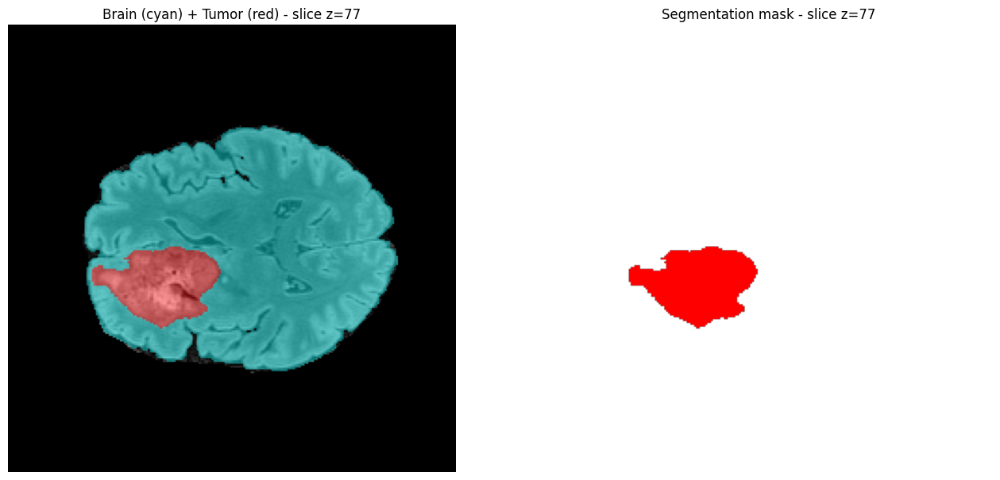

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import ants
import numpy as np

# Get brain mask from FLAIR
brain_mask = ants.get_mask(flair_ants).numpy()

# Convert segmentation to numpy
seg_np = seg_ants.numpy()

# Pick central slice
z_mid = flair_ants.shape[2] // 2

# Prepare overlay for brain + tumor
overlay = np.zeros_like(brain_mask[:, :, z_mid])
overlay[brain_mask[:, :, z_mid] == 1] = 1            
overlay[seg_np[:, :, z_mid] > 0] = 2                 

# Colormap for overlay
cmap_overlay = ListedColormap(['cyan', 'red'])

# Segmentation mask: map all positive values to 1
seg_slice = (seg_np[:, :, z_mid] > 0).astype(np.uint8)
cmap_seg = ListedColormap(['red'])

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# 1) FLAIR + overlay
axes[0].imshow(flair_ants.numpy()[:, :, z_mid], cmap='gray')
axes[0].imshow(np.ma.masked_where(overlay == 0, overlay), cmap=cmap_overlay, alpha=0.4)
axes[0].set_title(f'Brain (cyan) + Tumor (red) - slice z={z_mid}')
axes[0].axis('off')

# 2) Segmentation mask alone (only positive voxels)
axes[1].imshow(np.ma.masked_where(seg_slice == 0, seg_slice), cmap=cmap_seg)
axes[1].set_title(f'Segmentation mask - slice z={z_mid}')
axes[1].axis('off')

plt.show()


✔ Saved brain+tumor mask at: /content/BraTS2021_00000_brain_tumor_mask.nii.gz


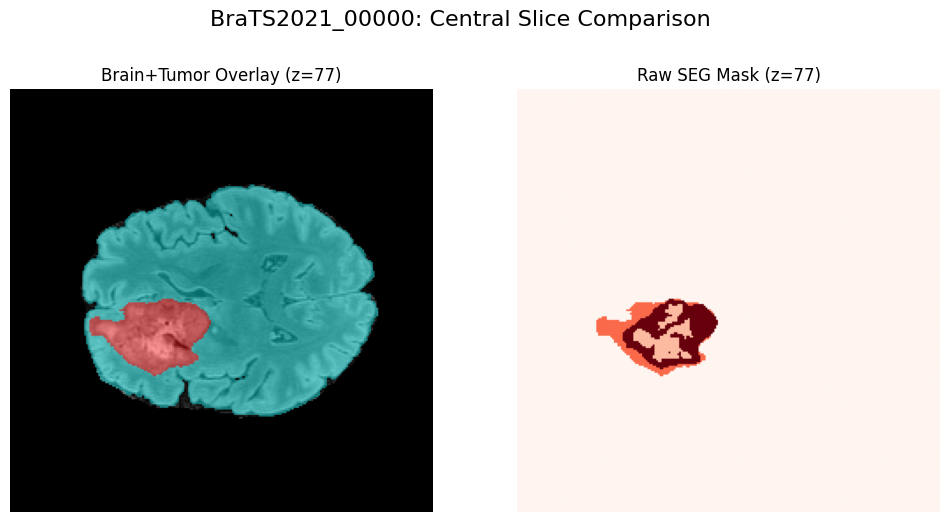

In [ ]:
import os
import nibabel as nib
import ants
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from skimage import measure

def load_patient_as_ants(patient_id, base_path):
    images_ants = {}
    for mod in ['flair','seg']:
        file_name = f"{patient_id}_{mod}.nii.gz"
        file_path = os.path.join(base_path, patient_id, file_name)
        if not os.path.exists(file_path):
            file_path = os.path.join(base_path, file_name)
        if os.path.exists(file_path):
            nib_img = nib.load(file_path)
            data = nib_img.get_fdata()
            spacing = list(nib_img.header.get_zooms()[:3])
            origin = list(nib.affines.apply_affine(nib_img.affine, [0,0,0]))
            direction = nib_img.affine[:3, :3].tolist()
            images_ants[mod] = ants.from_numpy(data, spacing=spacing, origin=origin, direction=direction)
        else:
            images_ants[mod] = None
            print(f" ⚠ Missing {mod} for {patient_id}")
    return images_ants

def create_brain_tumor_mask_and_plot(images_ants, patient_id, save_dir):
    flair_ants = images_ants.get('flair')
    seg_ants   = images_ants.get('seg')

    if flair_ants is None or seg_ants is None:
        print(f"Missing FLAIR or SEG for {patient_id}")
        return

    brain_mask = ants.get_mask(flair_ants).numpy()
    seg_np = seg_ants.numpy()
    tumor_mask = (seg_np > 0).astype(np.uint8)

    combined_mask = np.zeros_like(brain_mask, dtype=np.uint8)
    combined_mask[brain_mask==1] = 1
    combined_mask[tumor_mask==1] = 2

    # Save combined mask
    combined_ants = ants.from_numpy(
        combined_mask,
        spacing=flair_ants.spacing,
        origin=flair_ants.origin,
        direction=flair_ants.direction
    )
    save_path = os.path.join(save_dir, f"{patient_id}_brain_tumor_mask.nii.gz")
    ants.image_write(combined_ants, save_path)
    print(f"✔ Saved brain+tumor mask at: {save_path}")

    # Plot central slice with overlay
    z_mid = flair_ants.shape[2] // 2
    overlay_cmap = ListedColormap(['cyan','red'])

    plt.figure(figsize=(12,6))

    # FLAIR + brain+tumor overlay
    plt.subplot(1,2,1)
    plt.imshow(flair_ants.numpy()[:,:,z_mid], cmap='gray')
    plt.imshow(np.ma.masked_where(combined_mask[:,:,z_mid]==0, combined_mask[:,:,z_mid]),
               cmap=overlay_cmap, alpha=0.4)
    plt.title(f"Brain+Tumor Overlay (z={z_mid})")
    plt.axis('off')

    # Raw tumor mask from segmentation
    plt.subplot(1,2,2)
    plt.imshow(seg_np[:,:,z_mid], cmap='Reds')
    plt.title(f"Raw SEG Mask (z={z_mid})")
    plt.axis('off')

    plt.suptitle(f"{patient_id}: Central Slice Comparison", fontsize=16)
    plt.show()

# Batch processing for 100 patients
base_path = "/content/extracted_data"


patient_id = "BraTS2021_00000"
images_ants = load_patient_as_ants(patient_id, base_path)
create_brain_tumor_mask_and_plot(images_ants, patient_id, '/content')


In [ ]:
len(selected_patient_ids)

200


Processing BraTS2021_00000...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00000/BraTS2021_00000_brain_tumor_mask.nii.gz


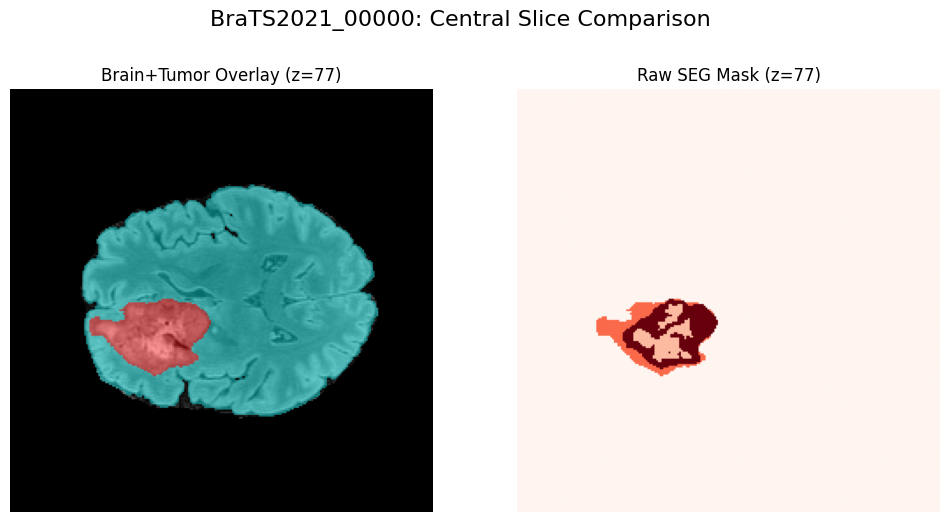


Processing BraTS2021_00002...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00002/BraTS2021_00002_brain_tumor_mask.nii.gz


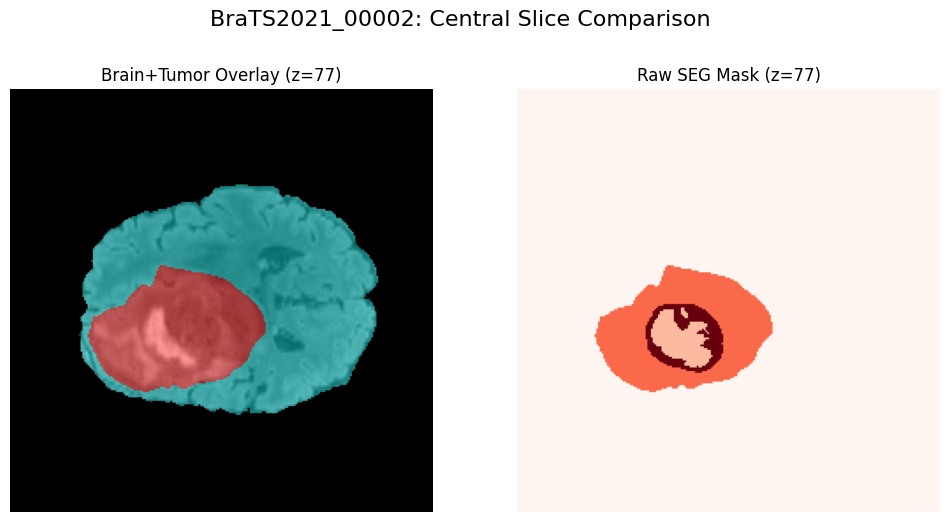


Processing BraTS2021_00003...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00003/BraTS2021_00003_brain_tumor_mask.nii.gz


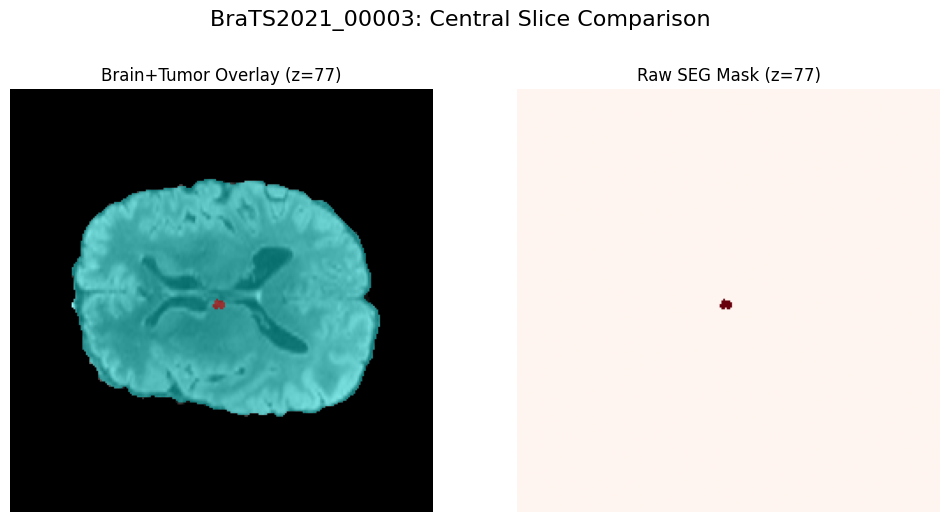


Processing BraTS2021_00005...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00005/BraTS2021_00005_brain_tumor_mask.nii.gz


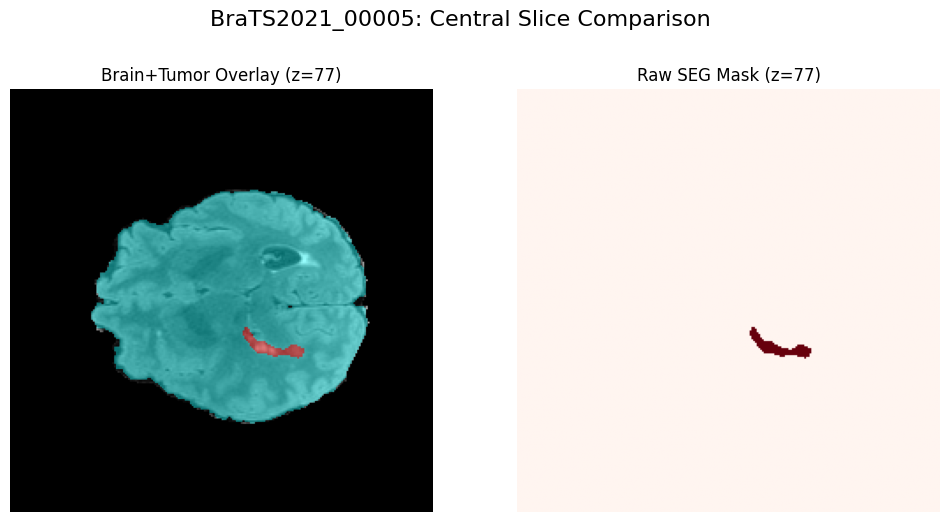


Processing BraTS2021_00006...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00006/BraTS2021_00006_brain_tumor_mask.nii.gz


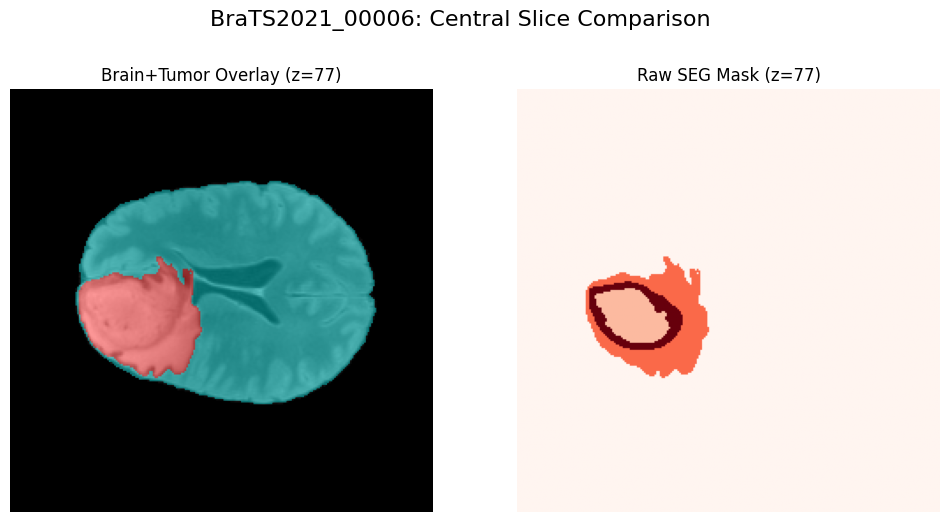


Processing BraTS2021_00008...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00008/BraTS2021_00008_brain_tumor_mask.nii.gz


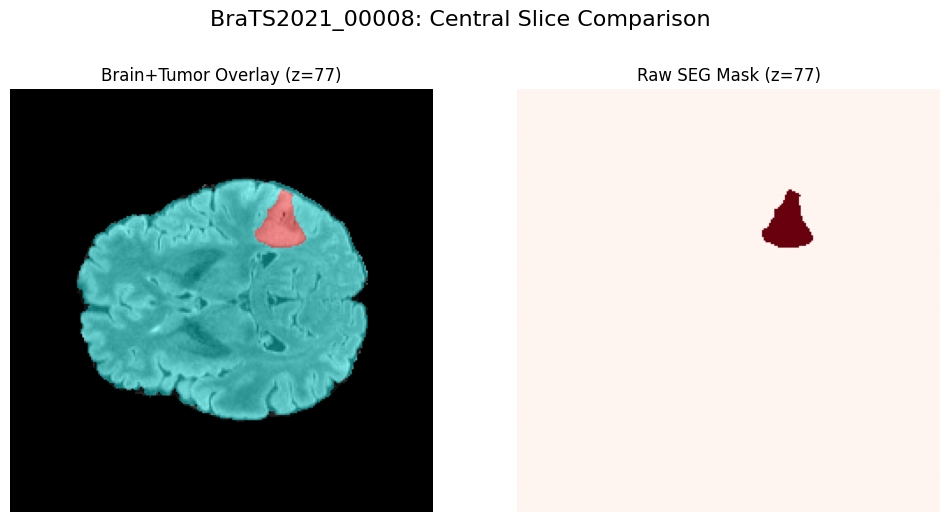


Processing BraTS2021_00009...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00009/BraTS2021_00009_brain_tumor_mask.nii.gz


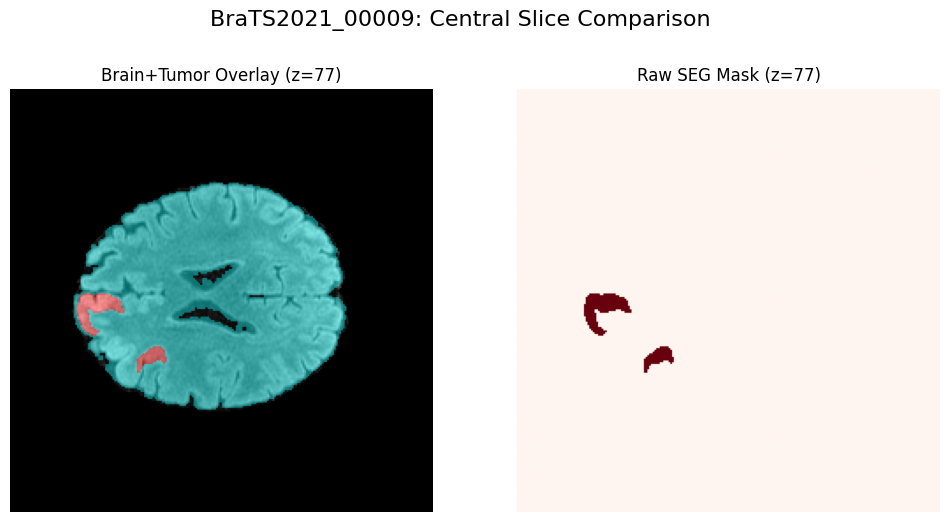


Processing BraTS2021_00011...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00011/BraTS2021_00011_brain_tumor_mask.nii.gz


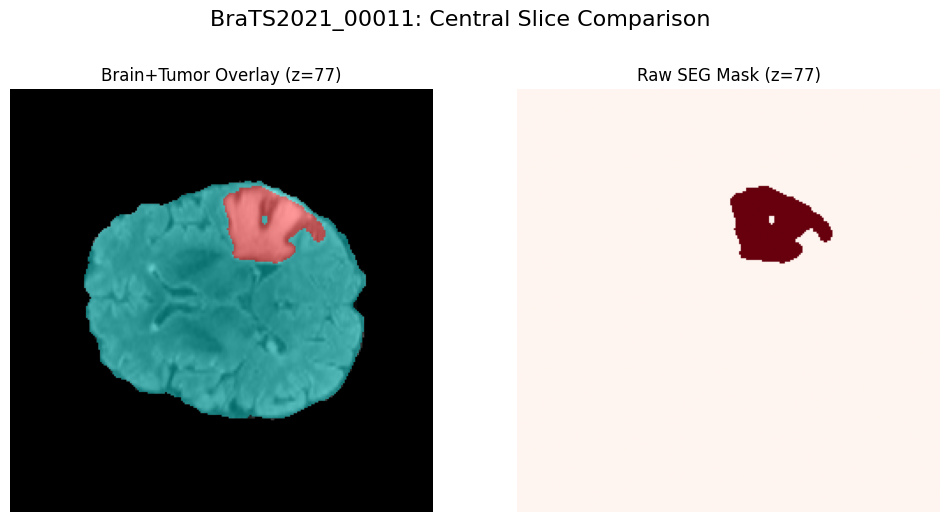


Processing BraTS2021_00012...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00012/BraTS2021_00012_brain_tumor_mask.nii.gz


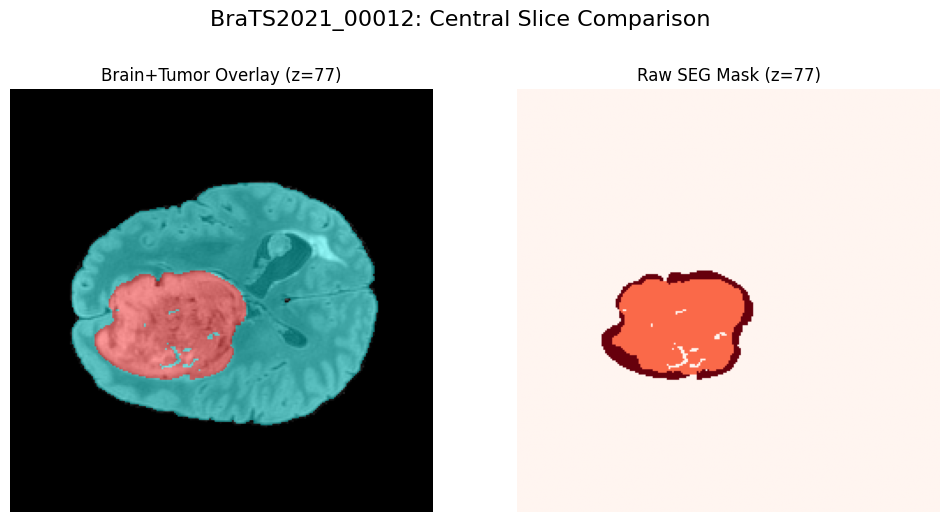


Processing BraTS2021_00014...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00014/BraTS2021_00014_brain_tumor_mask.nii.gz


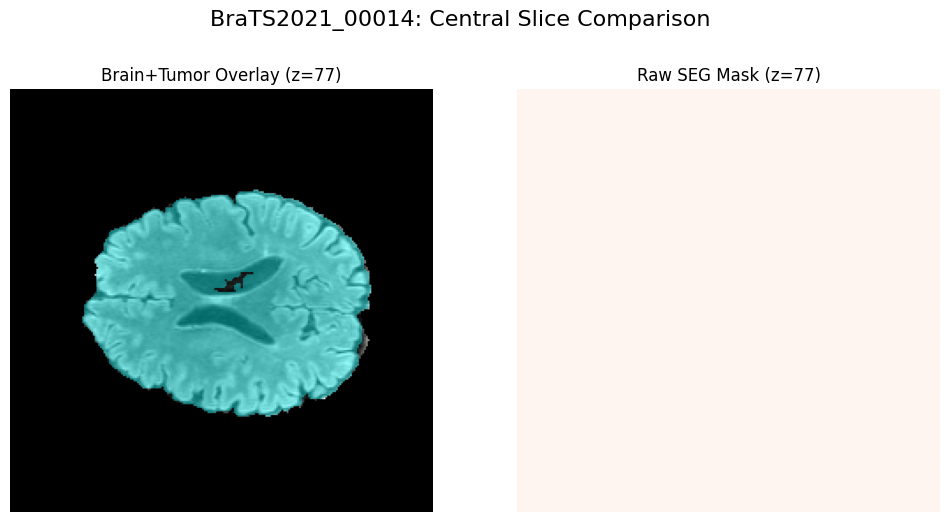


Processing BraTS2021_00016...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00016/BraTS2021_00016_brain_tumor_mask.nii.gz


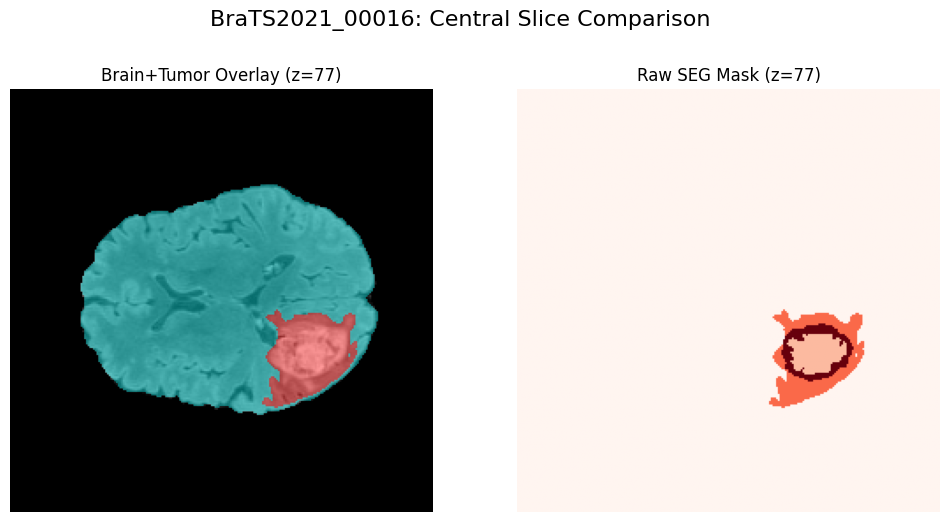


Processing BraTS2021_00017...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00017/BraTS2021_00017_brain_tumor_mask.nii.gz


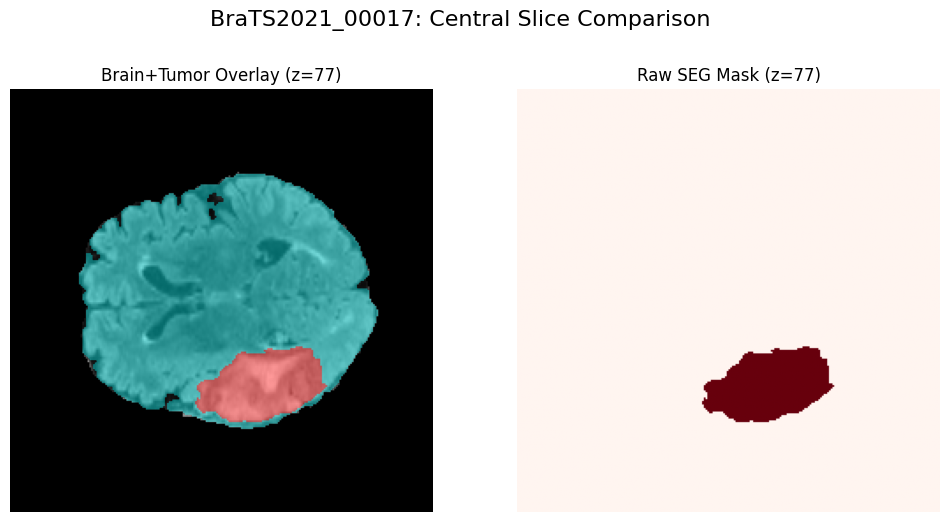


Processing BraTS2021_00018...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00018/BraTS2021_00018_brain_tumor_mask.nii.gz


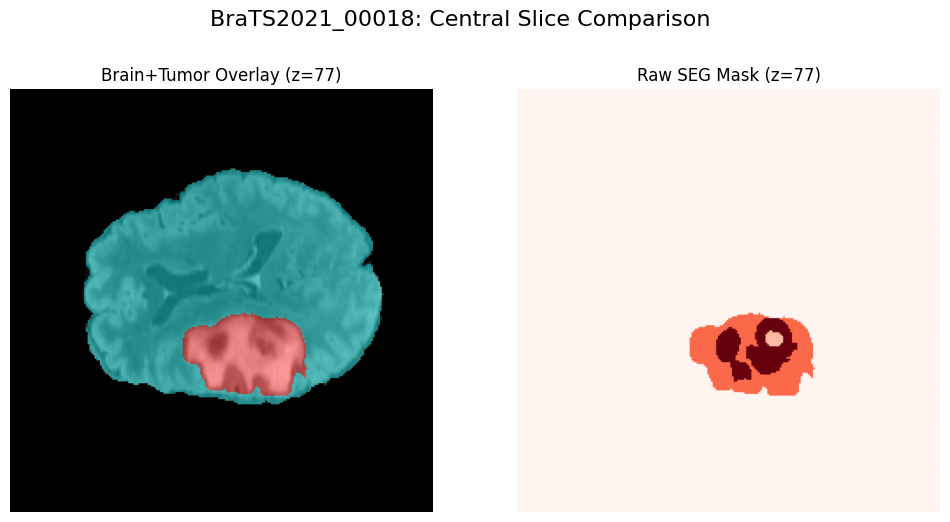


Processing BraTS2021_00019...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00019/BraTS2021_00019_brain_tumor_mask.nii.gz


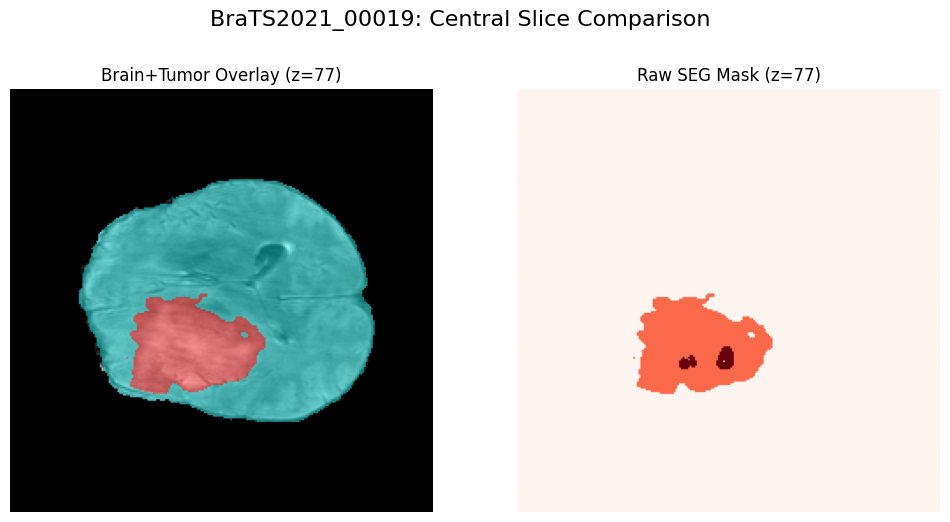


Processing BraTS2021_00020...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00020/BraTS2021_00020_brain_tumor_mask.nii.gz


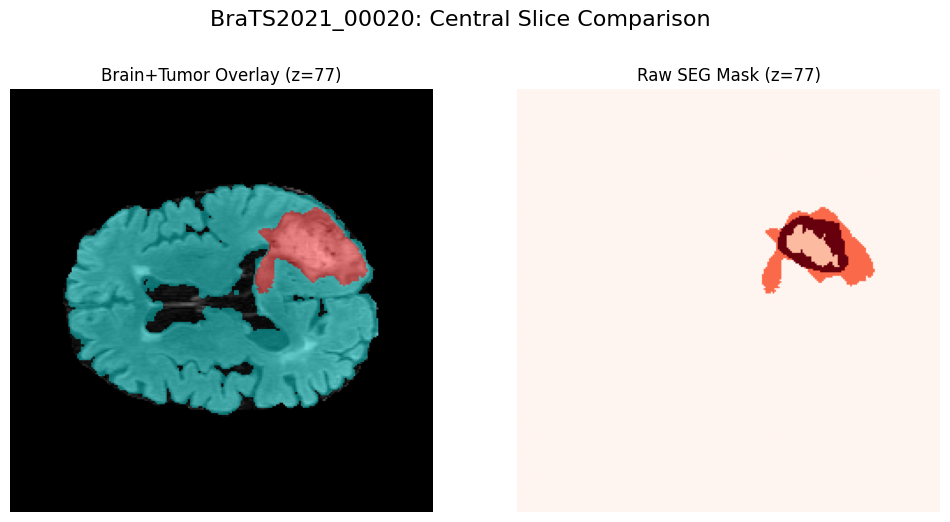


Processing BraTS2021_00021...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00021/BraTS2021_00021_brain_tumor_mask.nii.gz


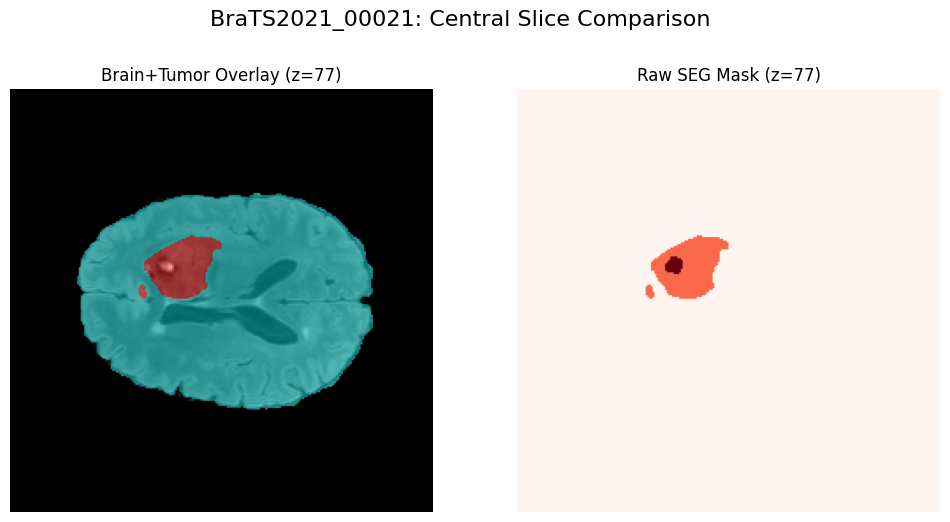


Processing BraTS2021_00022...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00022/BraTS2021_00022_brain_tumor_mask.nii.gz


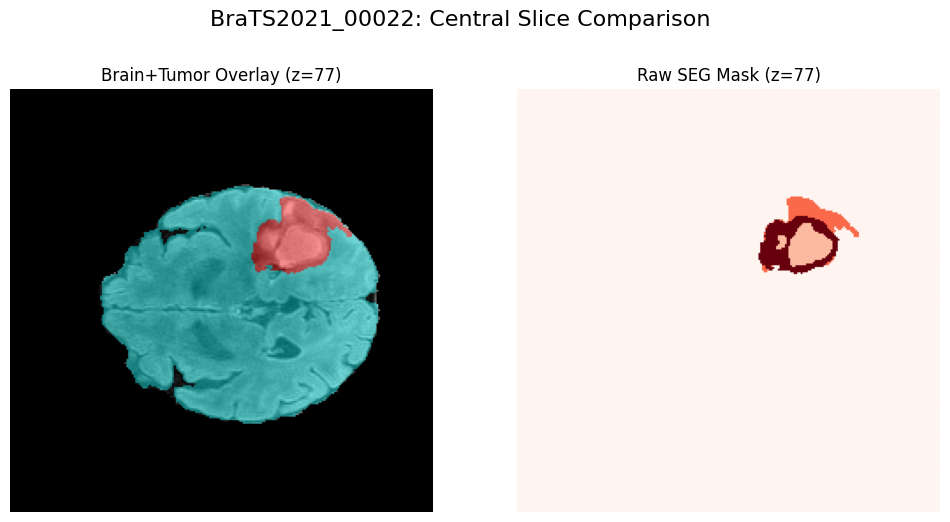


Processing BraTS2021_00024...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00024/BraTS2021_00024_brain_tumor_mask.nii.gz


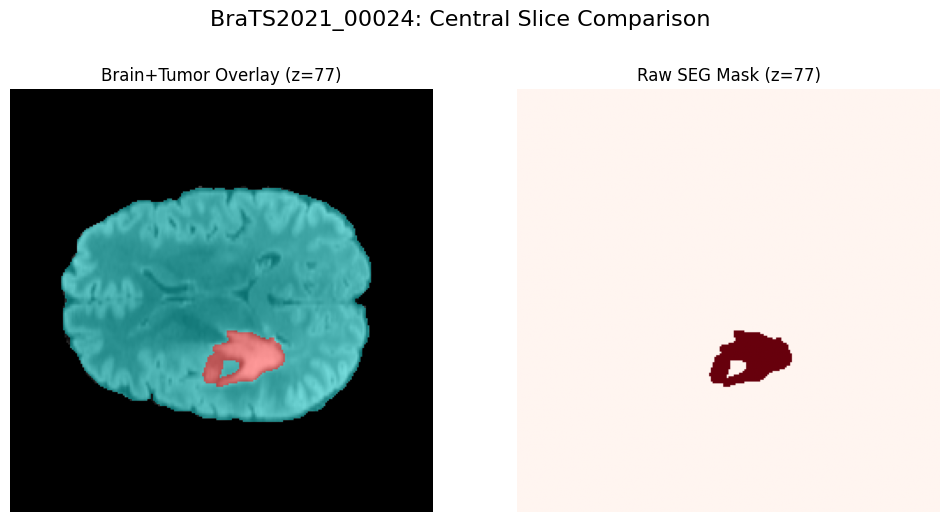


Processing BraTS2021_00025...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00025/BraTS2021_00025_brain_tumor_mask.nii.gz


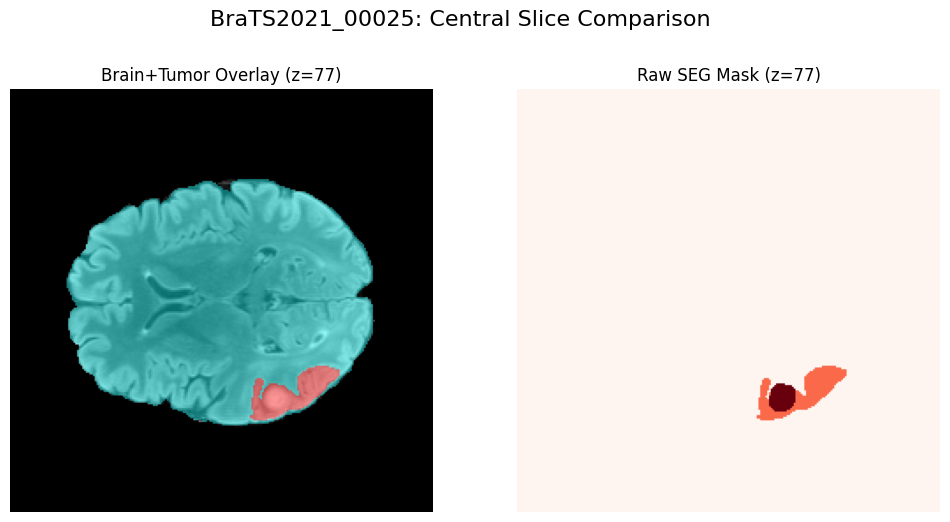


Processing BraTS2021_00026...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00026/BraTS2021_00026_brain_tumor_mask.nii.gz


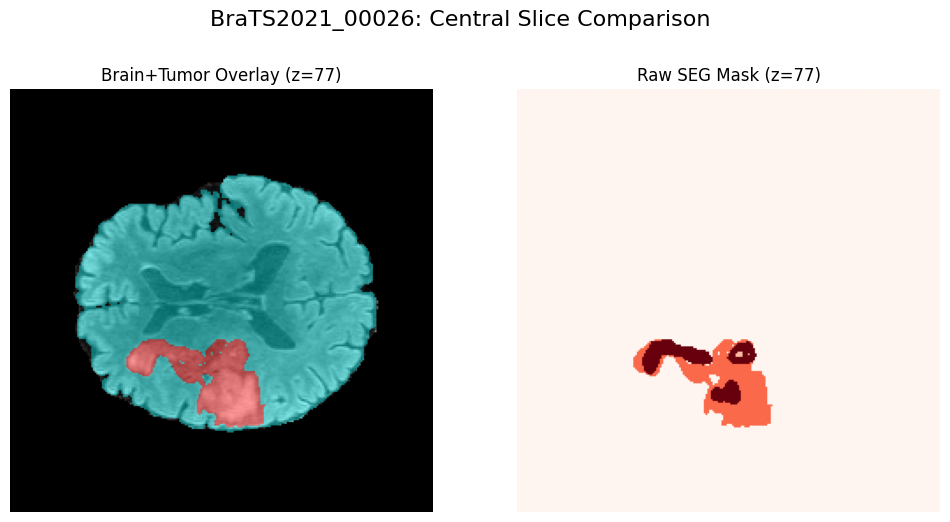


Processing BraTS2021_00028...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00028/BraTS2021_00028_brain_tumor_mask.nii.gz


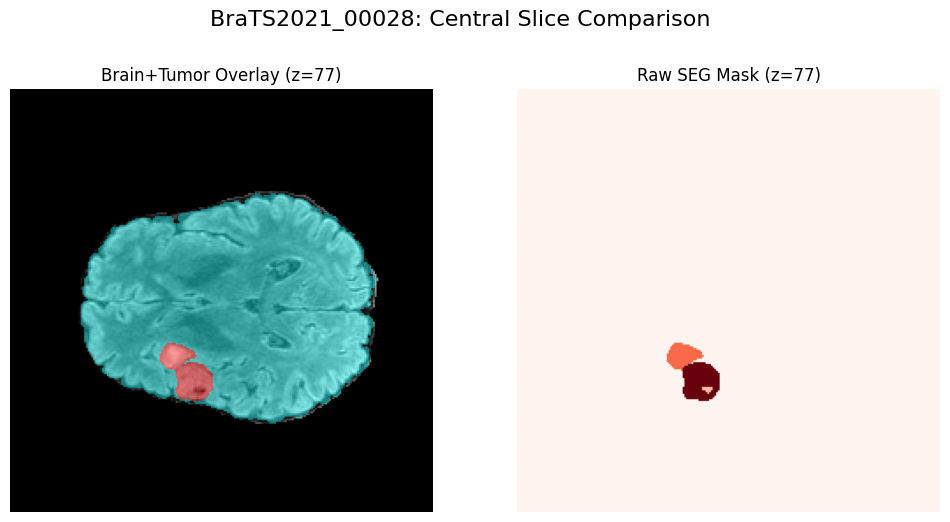


Processing BraTS2021_00030...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00030/BraTS2021_00030_brain_tumor_mask.nii.gz


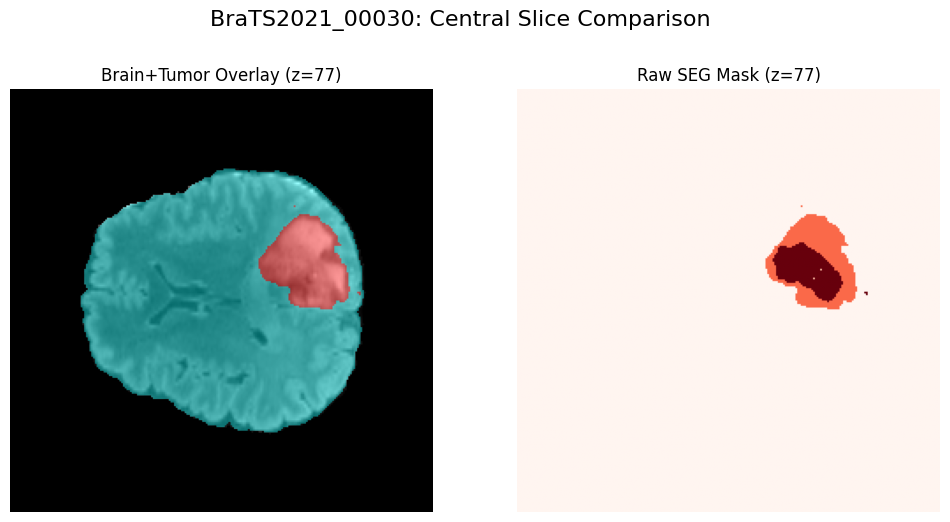


Processing BraTS2021_00031...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00031/BraTS2021_00031_brain_tumor_mask.nii.gz


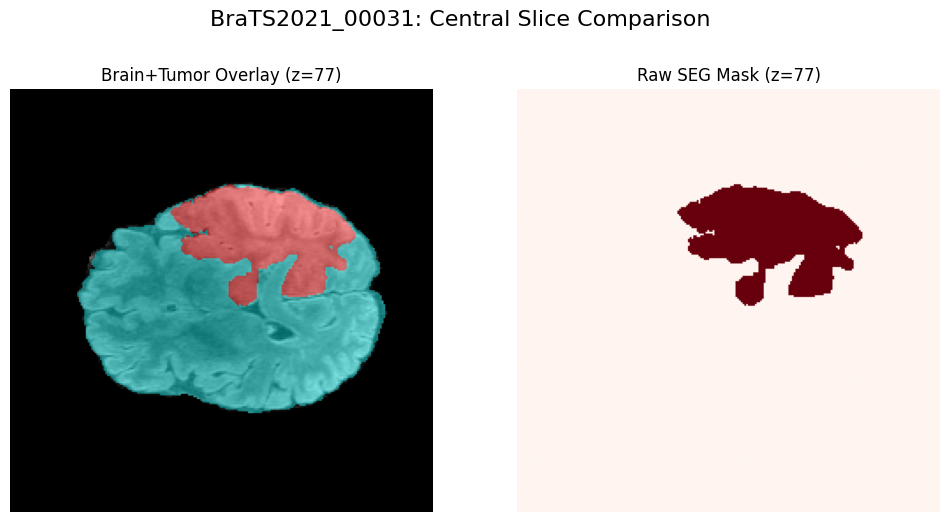


Processing BraTS2021_00032...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00032/BraTS2021_00032_brain_tumor_mask.nii.gz


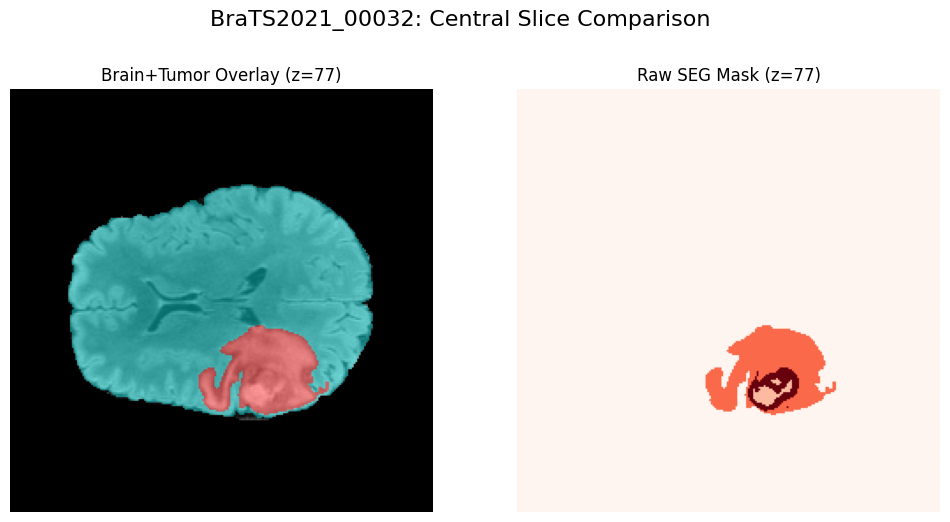


Processing BraTS2021_00033...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00033/BraTS2021_00033_brain_tumor_mask.nii.gz


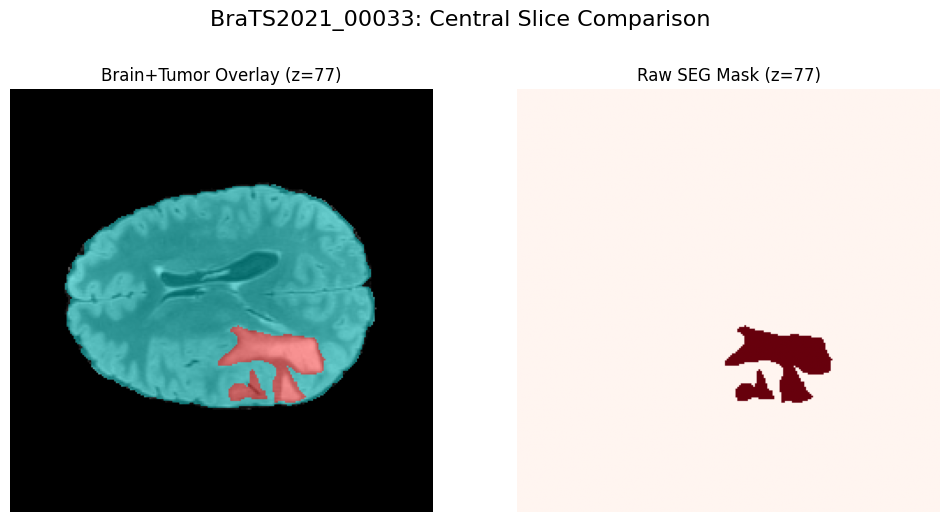


Processing BraTS2021_00035...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00035/BraTS2021_00035_brain_tumor_mask.nii.gz


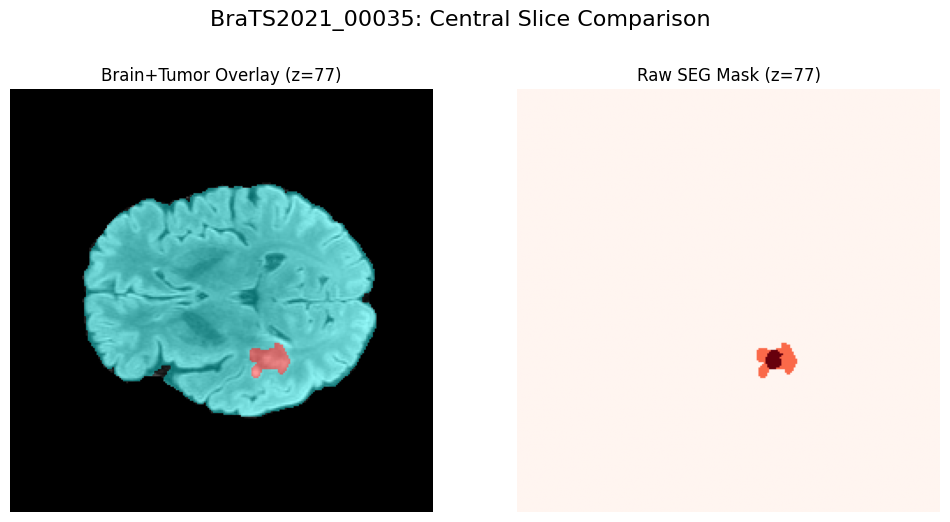


Processing BraTS2021_00036...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00036/BraTS2021_00036_brain_tumor_mask.nii.gz


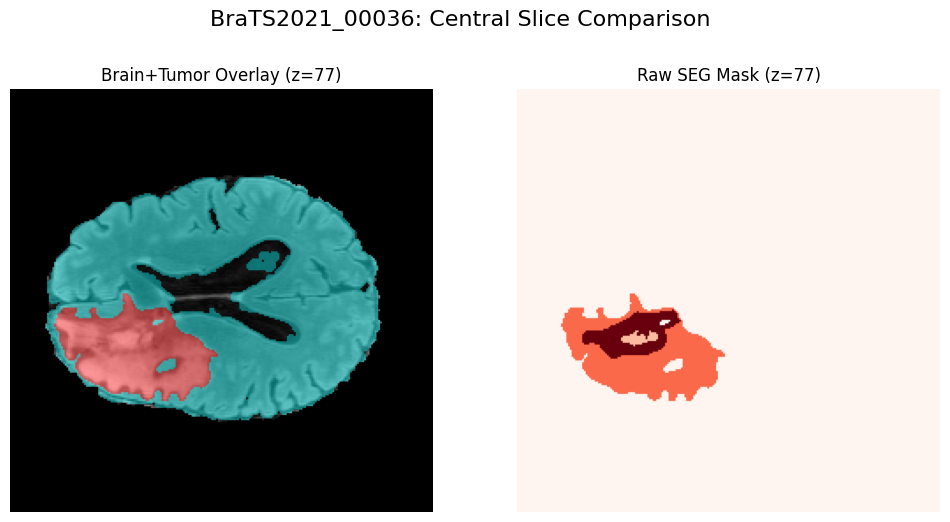


Processing BraTS2021_00043...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00043/BraTS2021_00043_brain_tumor_mask.nii.gz


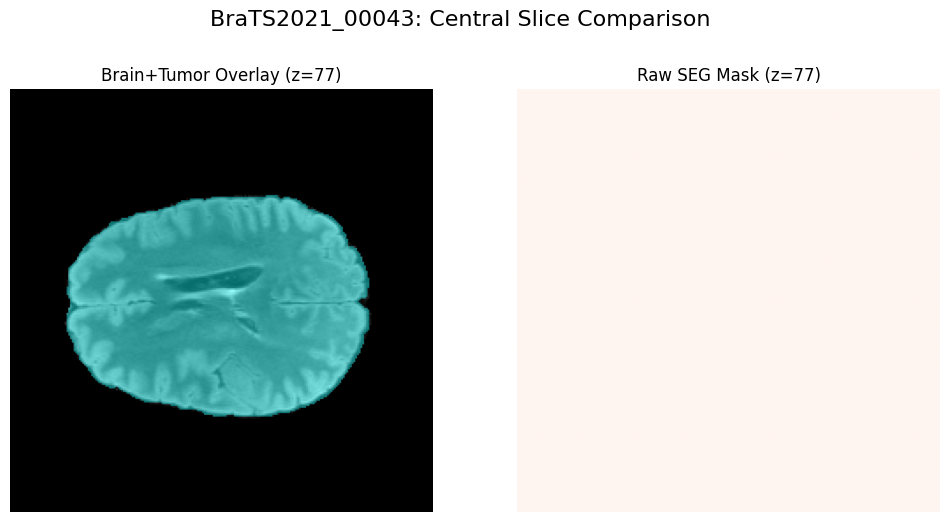


Processing BraTS2021_00044...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00044/BraTS2021_00044_brain_tumor_mask.nii.gz


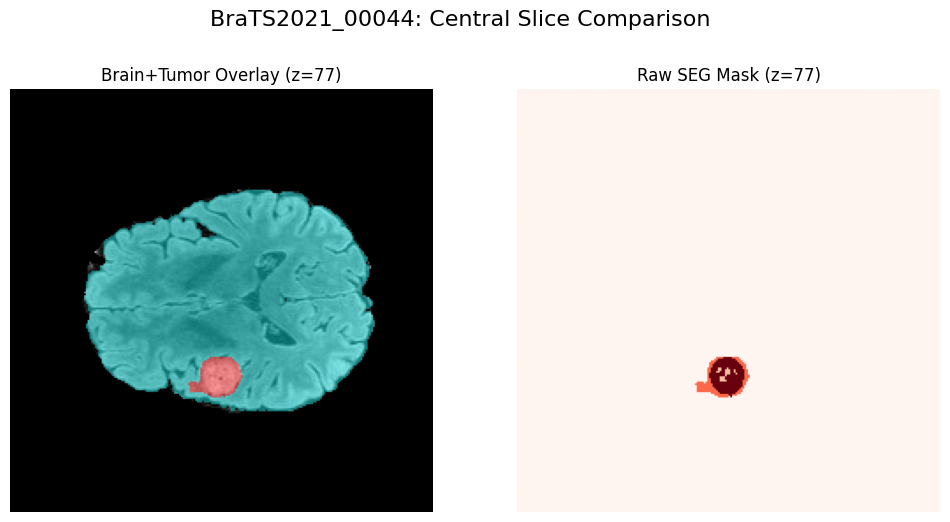


Processing BraTS2021_00045...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00045/BraTS2021_00045_brain_tumor_mask.nii.gz


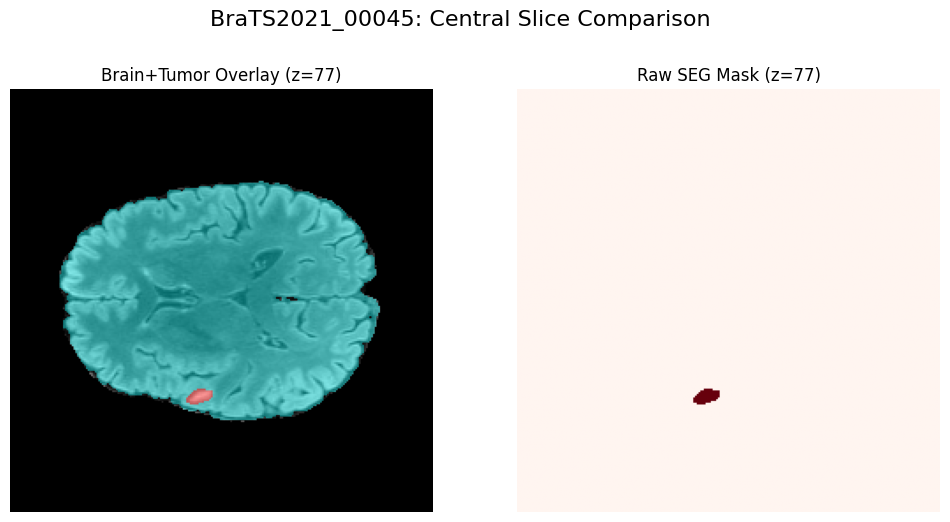


Processing BraTS2021_00046...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00046/BraTS2021_00046_brain_tumor_mask.nii.gz


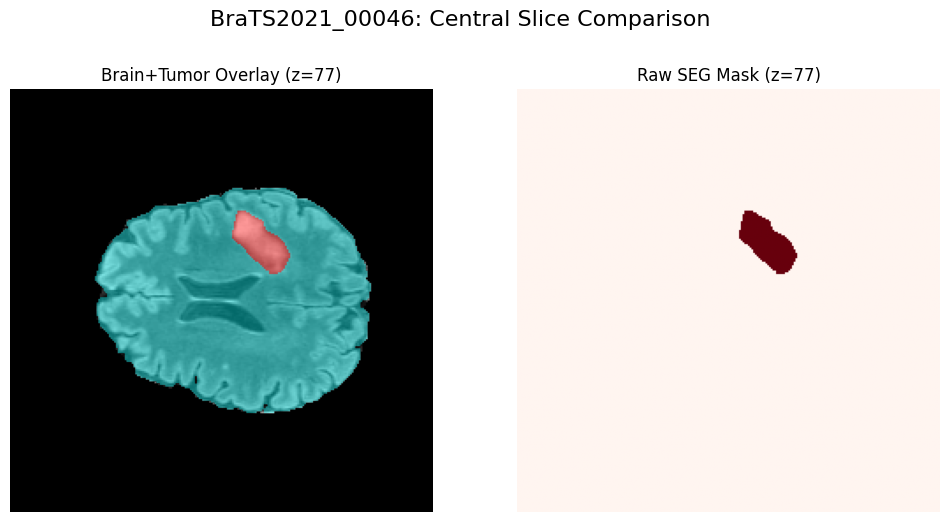


Processing BraTS2021_00048...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00048/BraTS2021_00048_brain_tumor_mask.nii.gz


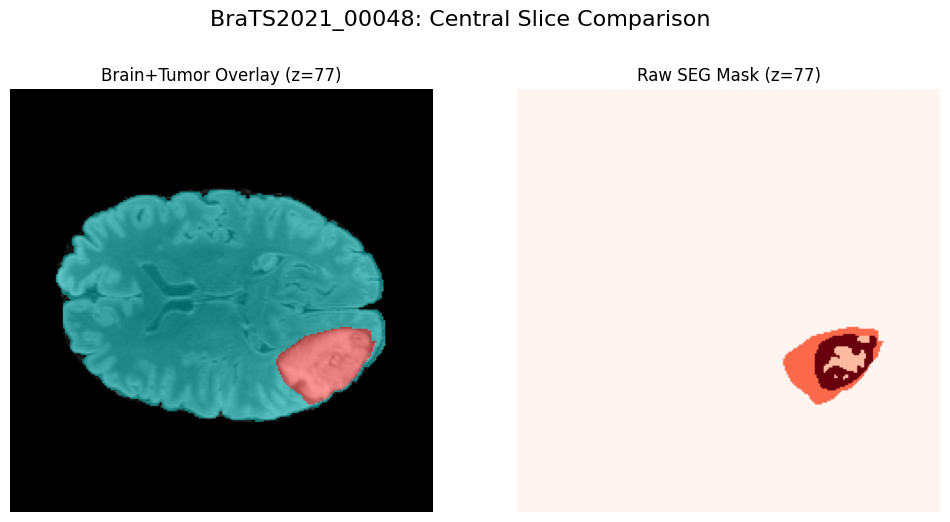


Processing BraTS2021_00049...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00049/BraTS2021_00049_brain_tumor_mask.nii.gz


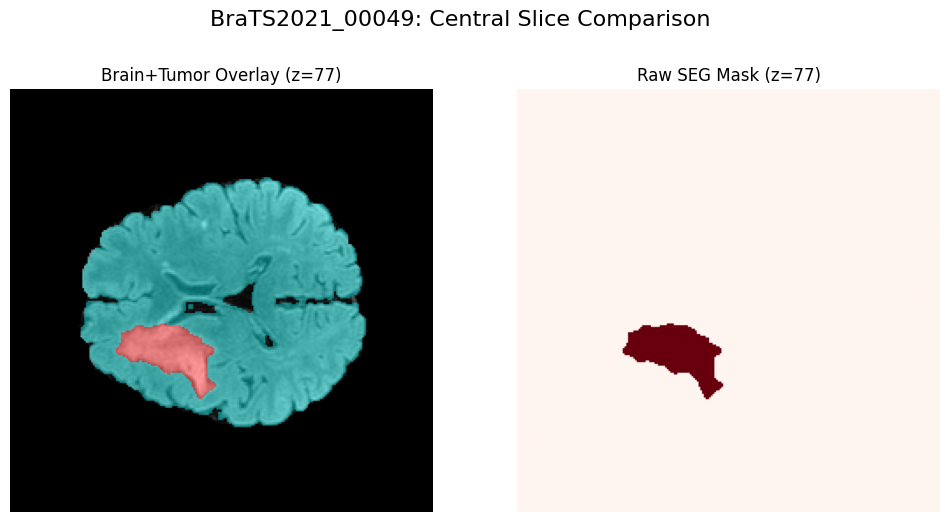


Processing BraTS2021_00051...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00051/BraTS2021_00051_brain_tumor_mask.nii.gz


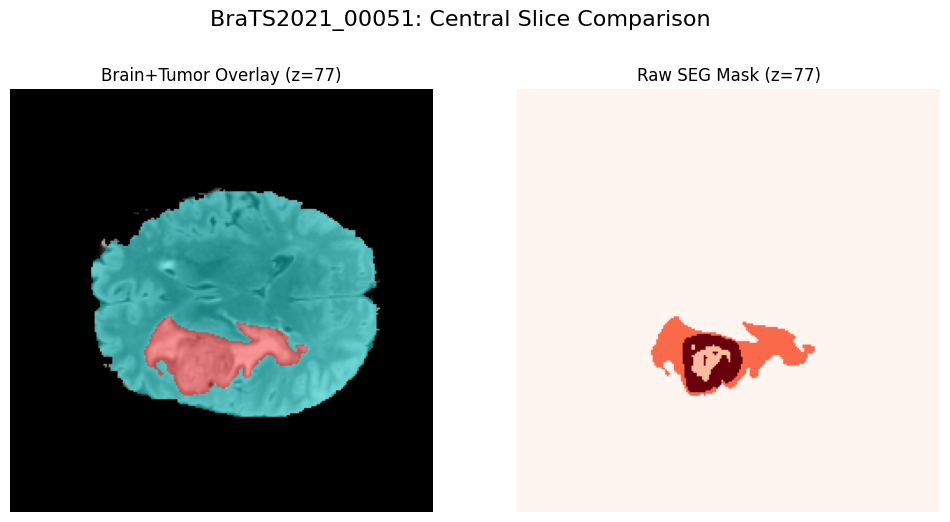


Processing BraTS2021_00052...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00052/BraTS2021_00052_brain_tumor_mask.nii.gz


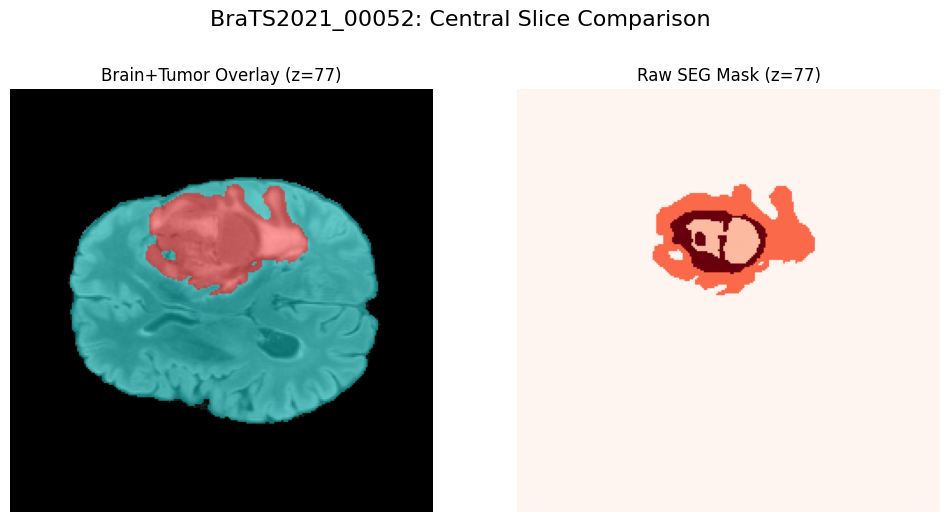


Processing BraTS2021_00053...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00053/BraTS2021_00053_brain_tumor_mask.nii.gz


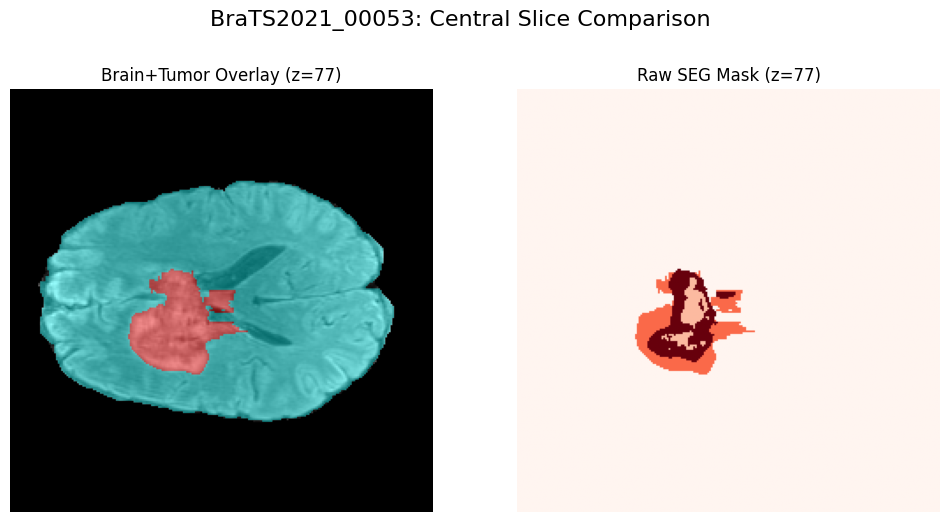


Processing BraTS2021_00054...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00054/BraTS2021_00054_brain_tumor_mask.nii.gz


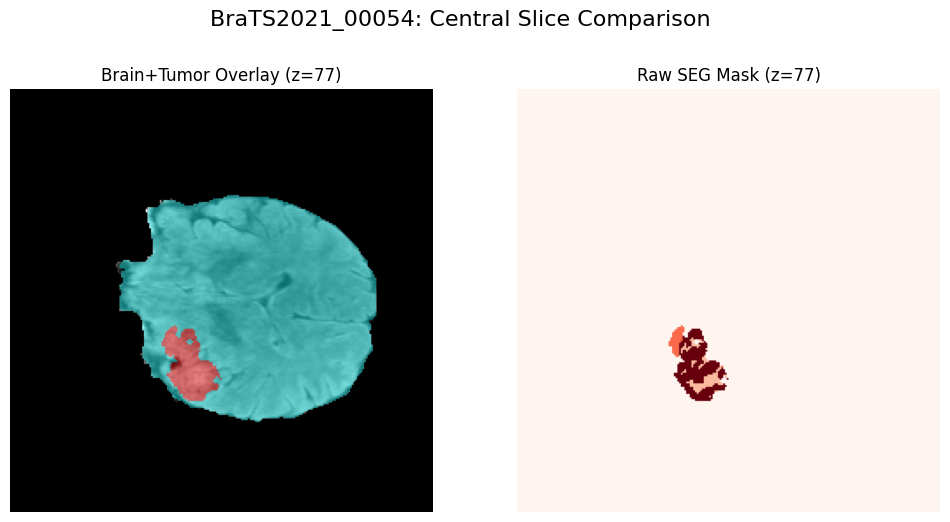


Processing BraTS2021_00056...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00056/BraTS2021_00056_brain_tumor_mask.nii.gz


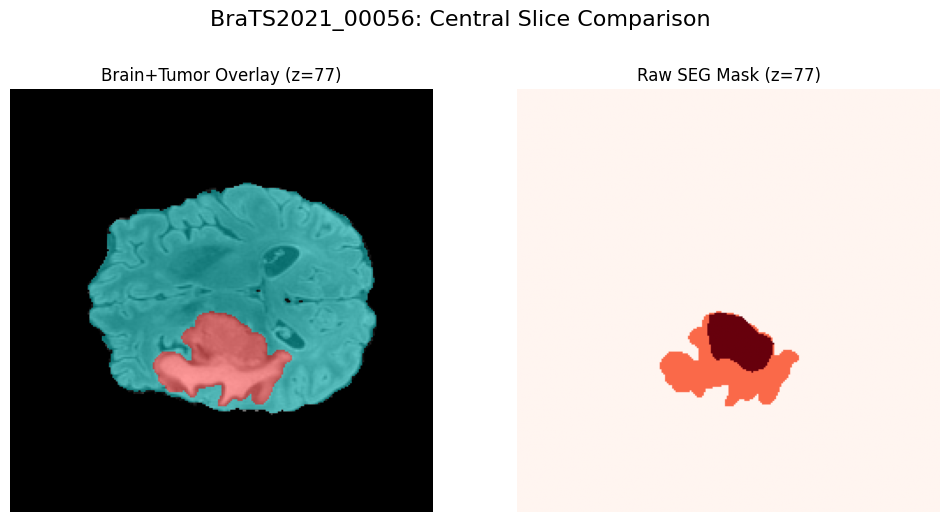


Processing BraTS2021_00058...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00058/BraTS2021_00058_brain_tumor_mask.nii.gz


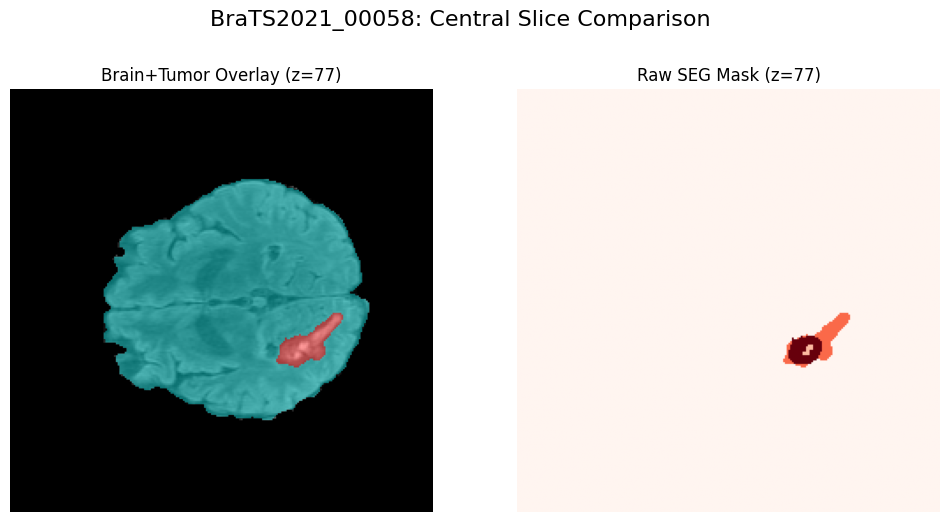


Processing BraTS2021_00059...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00059/BraTS2021_00059_brain_tumor_mask.nii.gz


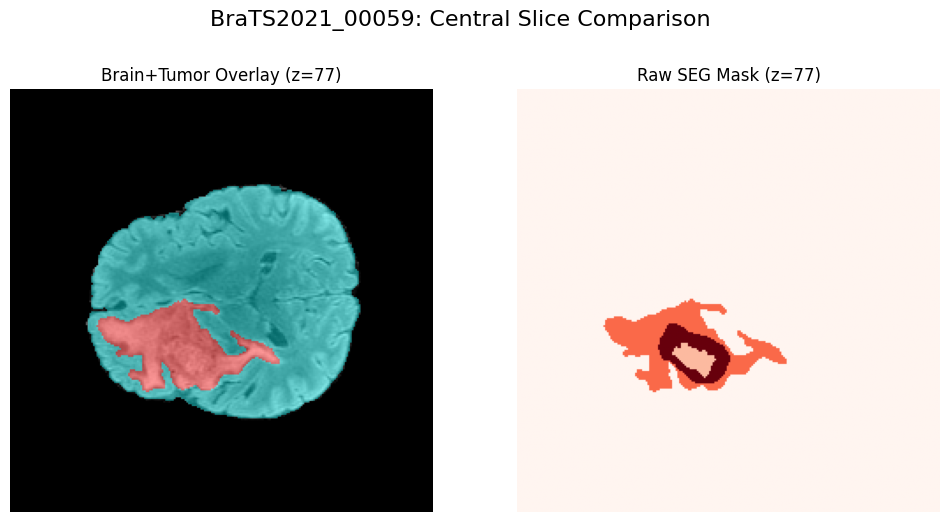


Processing BraTS2021_00060...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00060/BraTS2021_00060_brain_tumor_mask.nii.gz


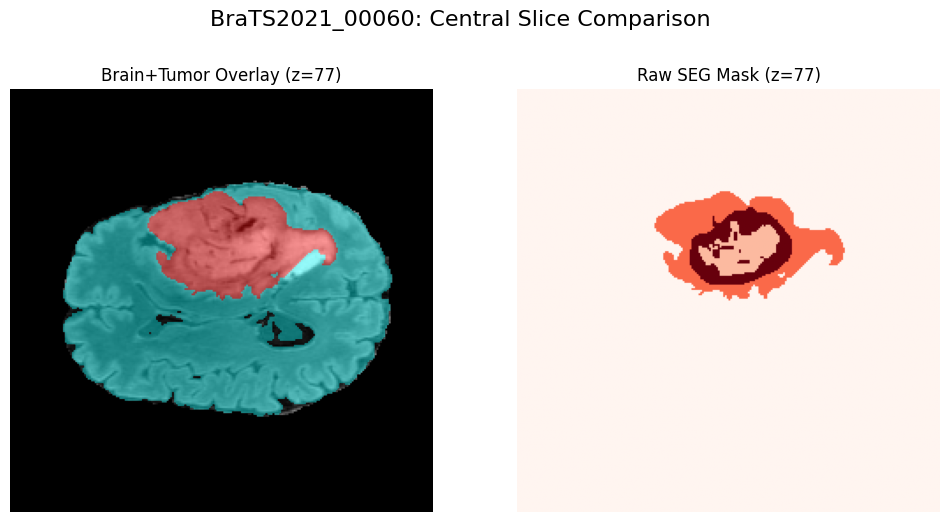


Processing BraTS2021_00061...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00061/BraTS2021_00061_brain_tumor_mask.nii.gz


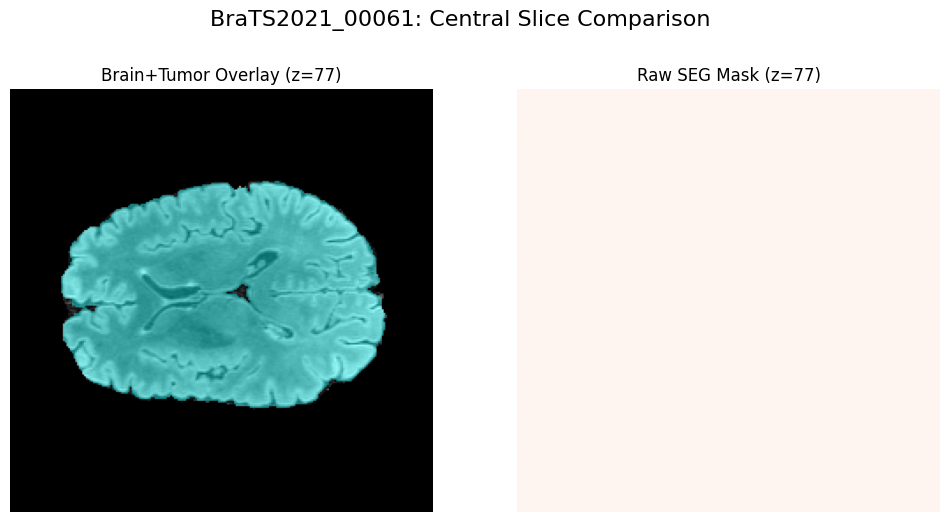


Processing BraTS2021_00062...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00062/BraTS2021_00062_brain_tumor_mask.nii.gz


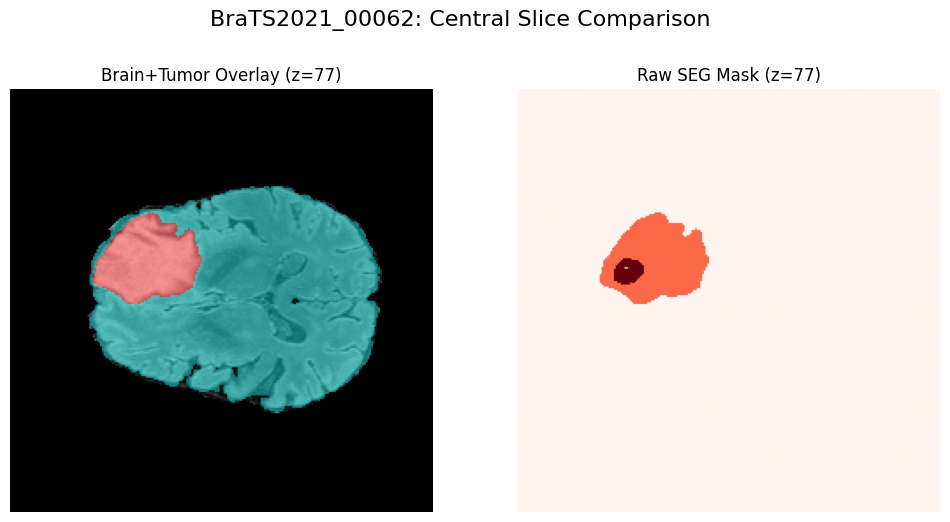


Processing BraTS2021_00063...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00063/BraTS2021_00063_brain_tumor_mask.nii.gz


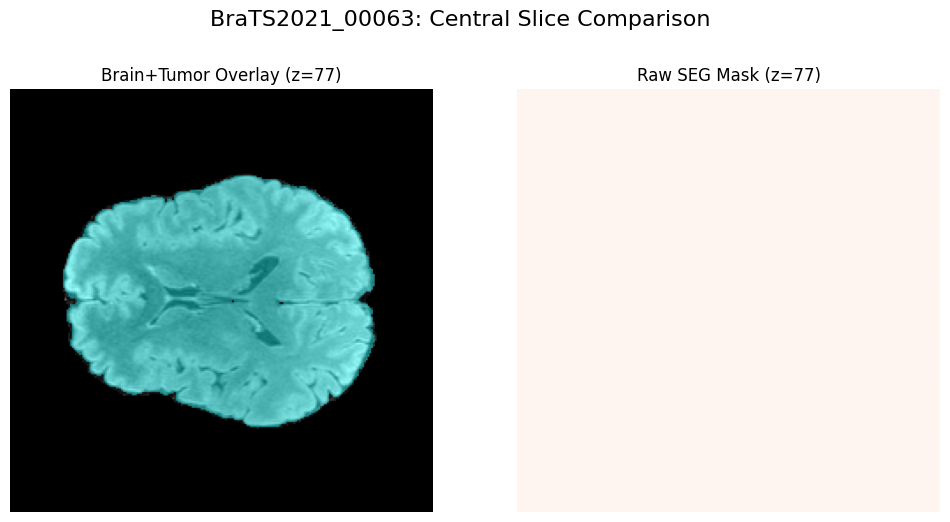


Processing BraTS2021_00064...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00064/BraTS2021_00064_brain_tumor_mask.nii.gz


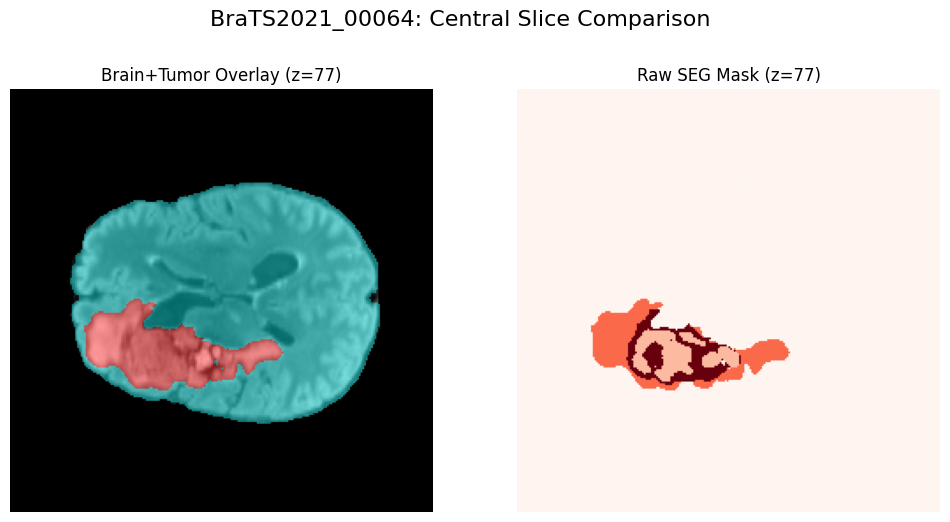


Processing BraTS2021_00066...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00066/BraTS2021_00066_brain_tumor_mask.nii.gz


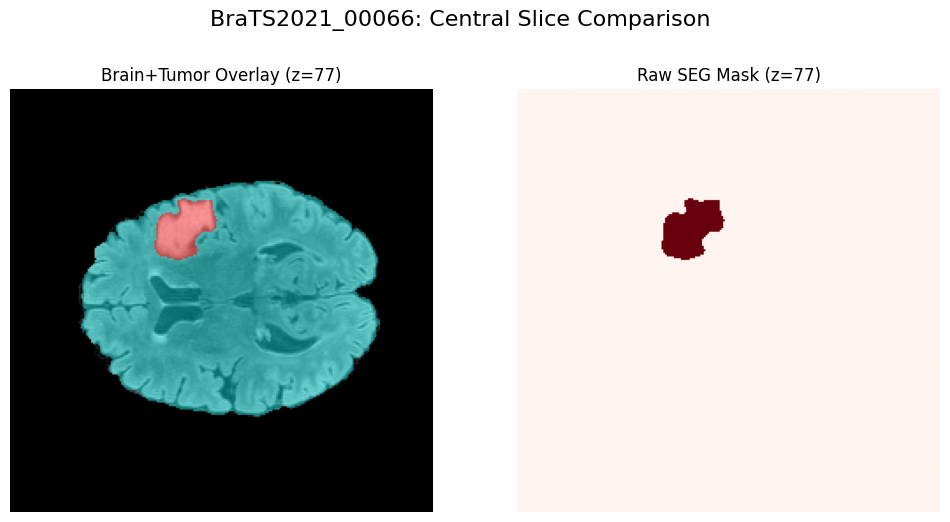


Processing BraTS2021_00068...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00068/BraTS2021_00068_brain_tumor_mask.nii.gz


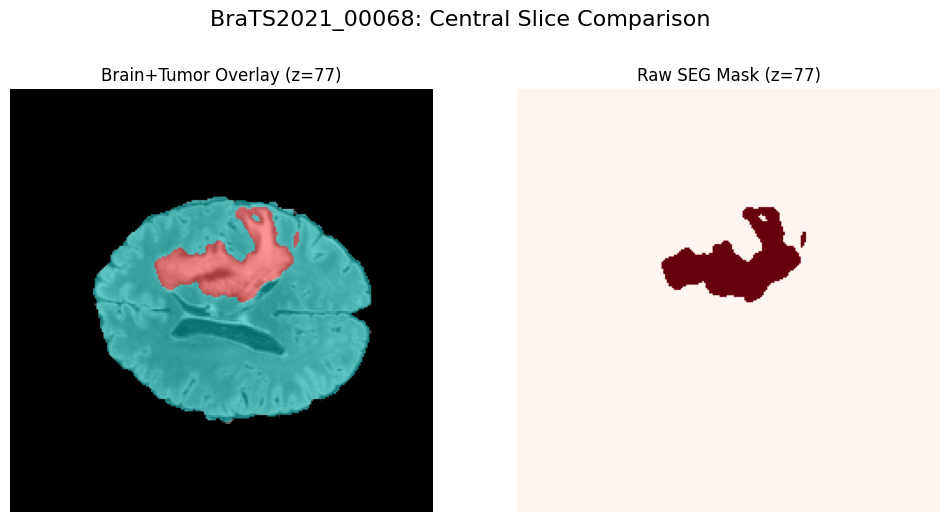


Processing BraTS2021_00070...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00070/BraTS2021_00070_brain_tumor_mask.nii.gz


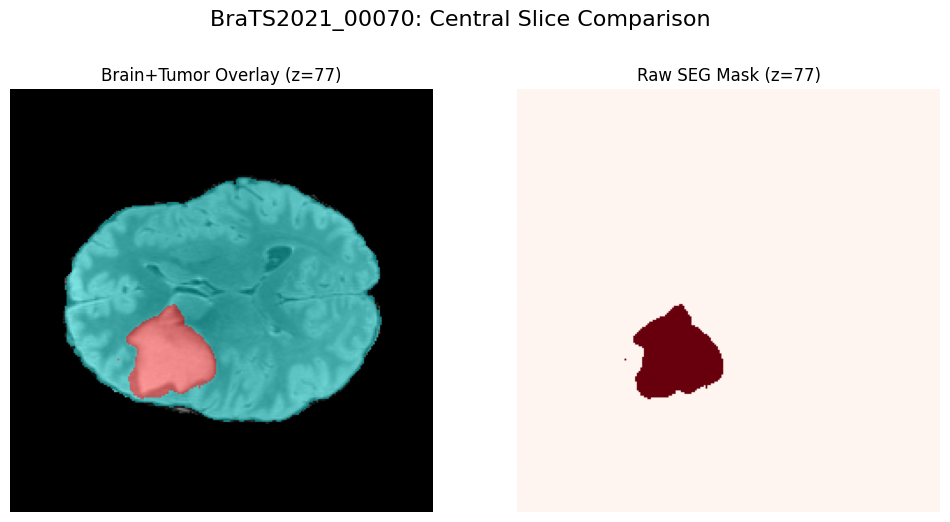


Processing BraTS2021_00071...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00071/BraTS2021_00071_brain_tumor_mask.nii.gz


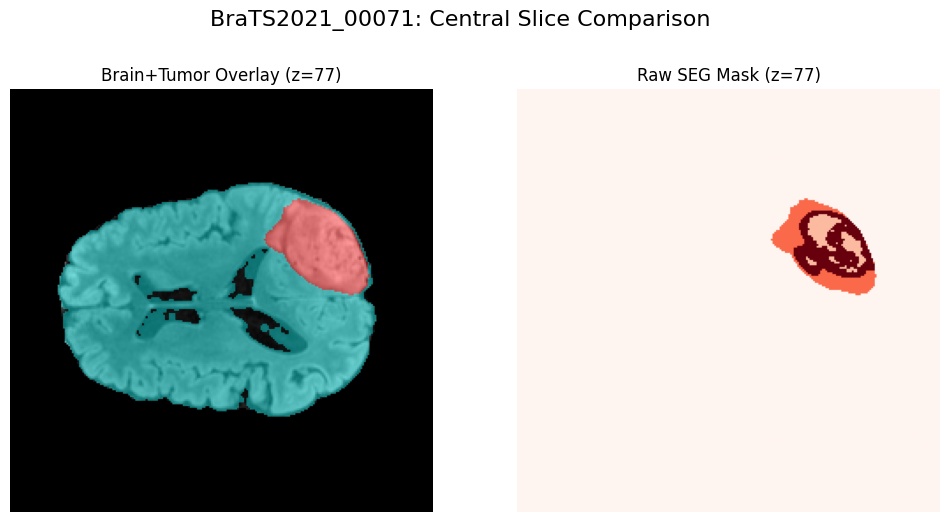


Processing BraTS2021_00072...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00072/BraTS2021_00072_brain_tumor_mask.nii.gz


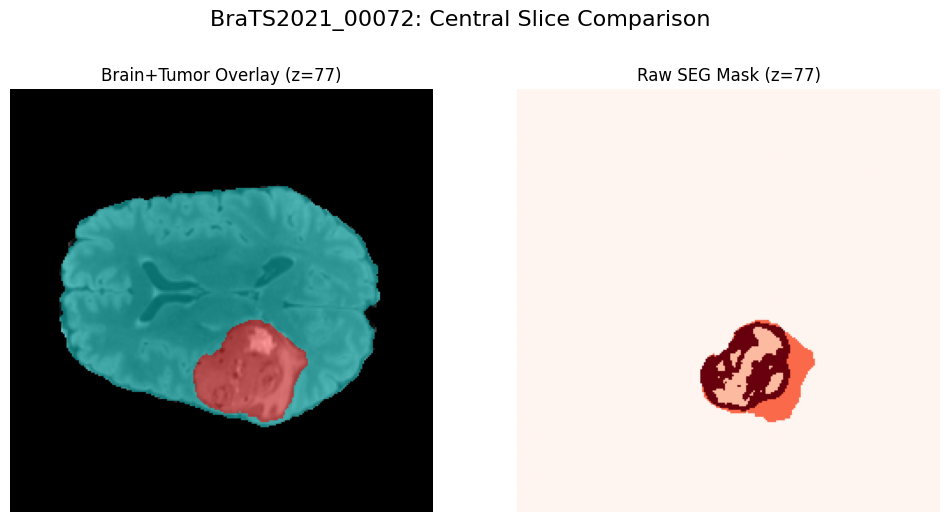


Processing BraTS2021_00074...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00074/BraTS2021_00074_brain_tumor_mask.nii.gz


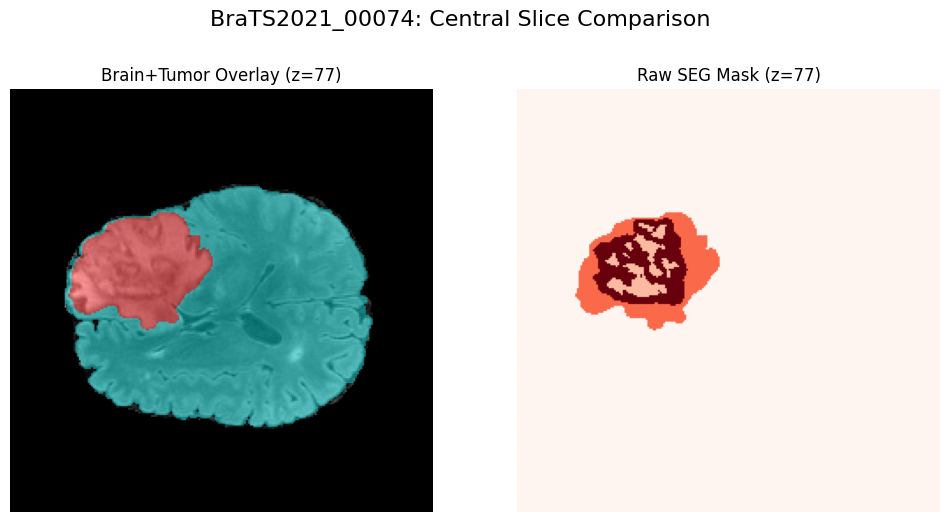


Processing BraTS2021_00077...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00077/BraTS2021_00077_brain_tumor_mask.nii.gz


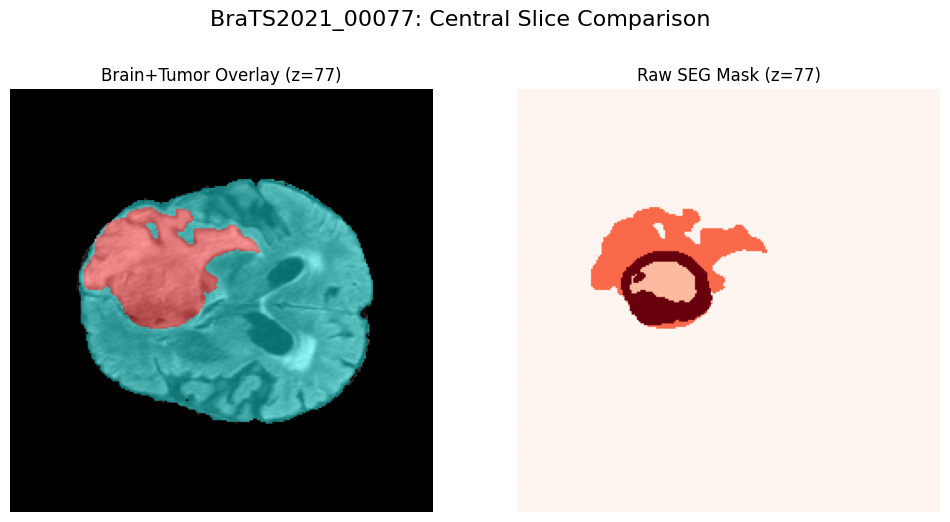


Processing BraTS2021_00078...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00078/BraTS2021_00078_brain_tumor_mask.nii.gz


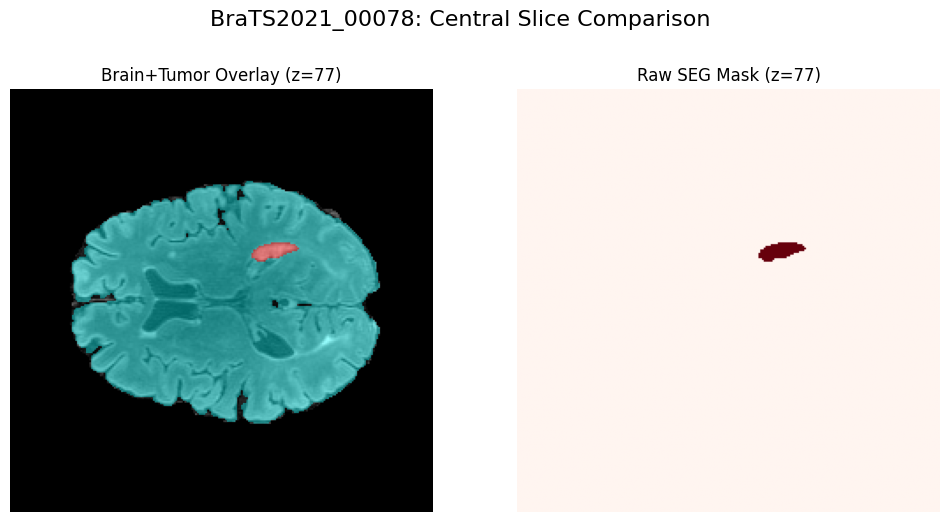


Processing BraTS2021_00081...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00081/BraTS2021_00081_brain_tumor_mask.nii.gz


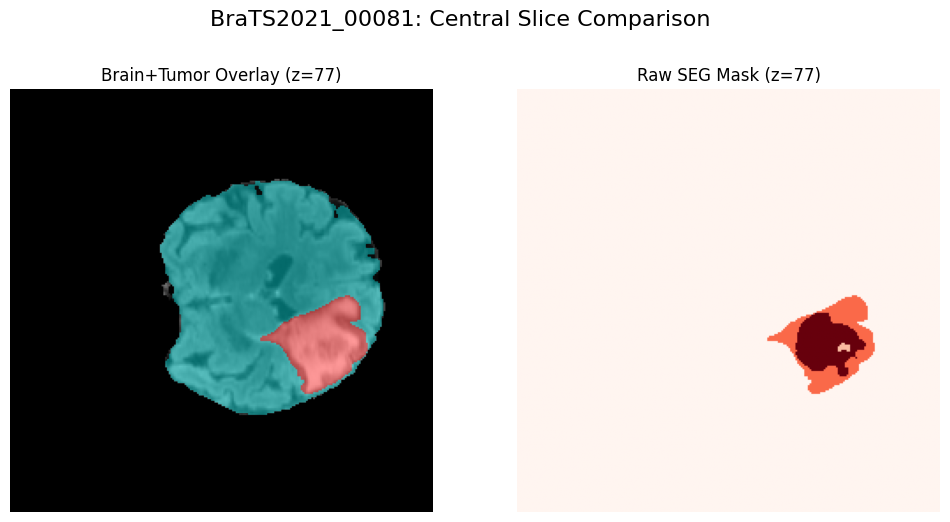


Processing BraTS2021_00084...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00084/BraTS2021_00084_brain_tumor_mask.nii.gz


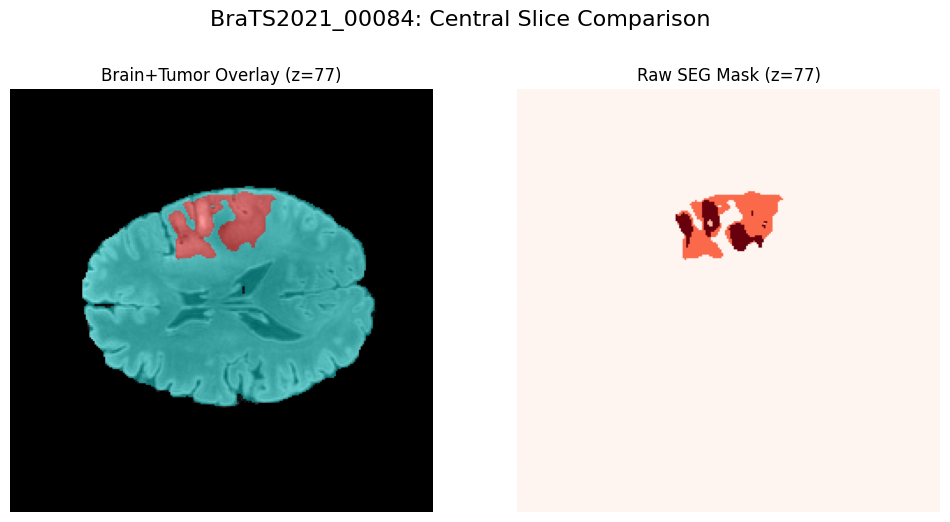


Processing BraTS2021_00085...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00085/BraTS2021_00085_brain_tumor_mask.nii.gz


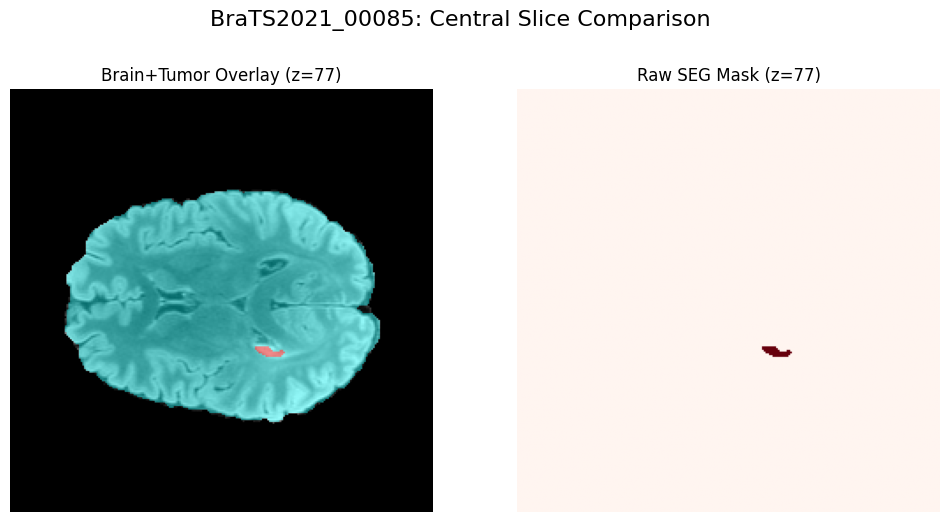


Processing BraTS2021_00087...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00087/BraTS2021_00087_brain_tumor_mask.nii.gz


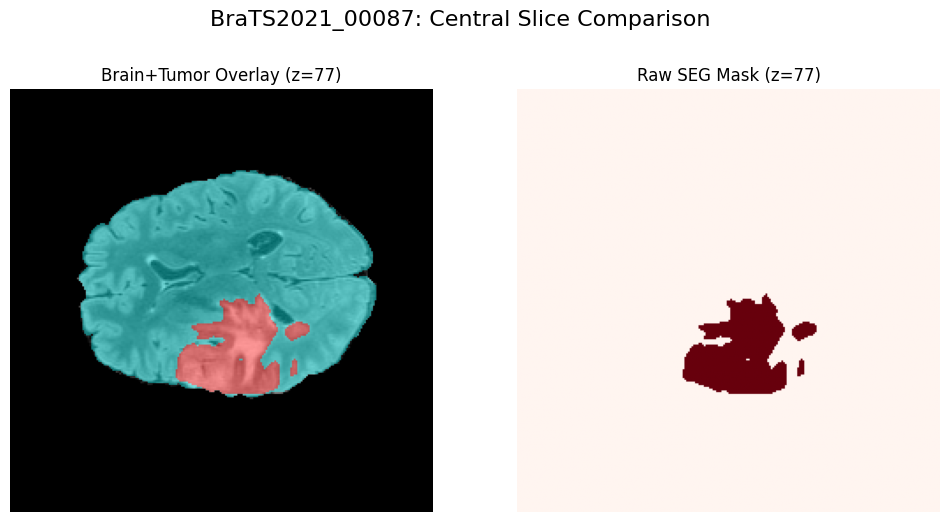


Processing BraTS2021_00088...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00088/BraTS2021_00088_brain_tumor_mask.nii.gz


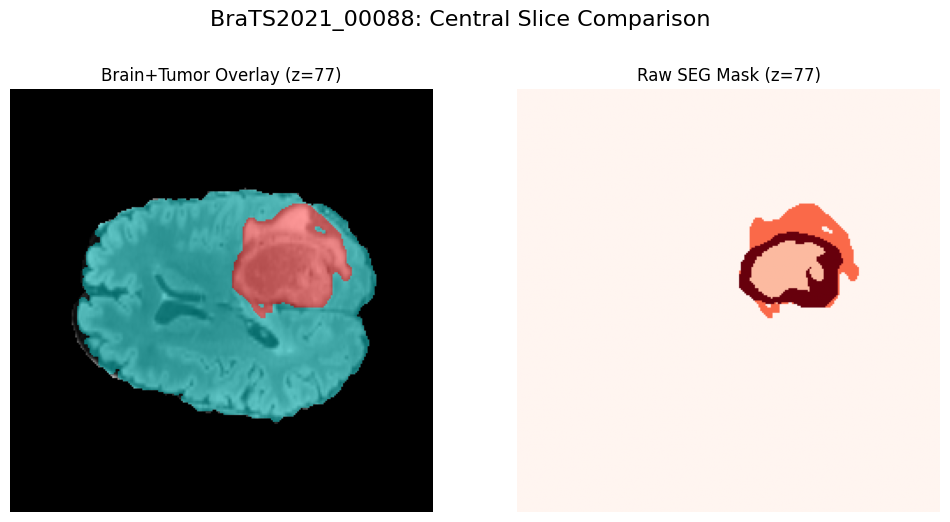


Processing BraTS2021_00089...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00089/BraTS2021_00089_brain_tumor_mask.nii.gz


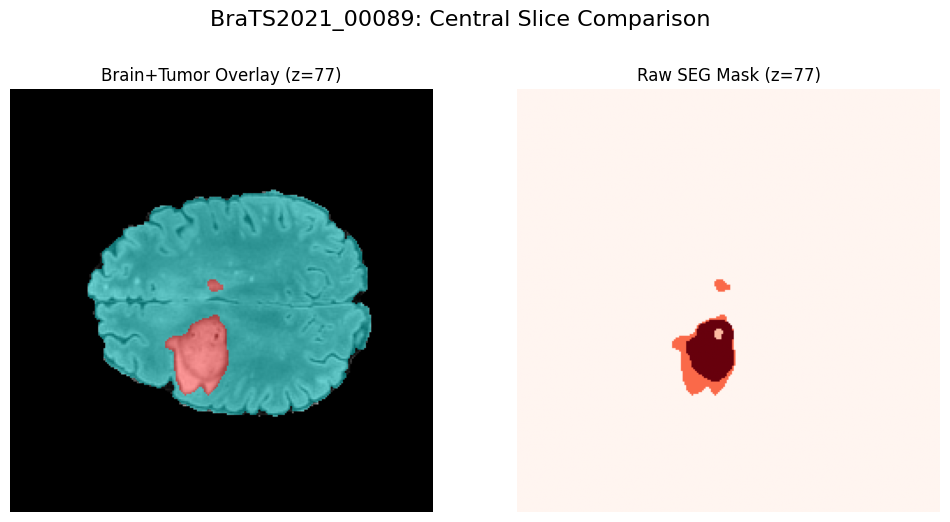


Processing BraTS2021_00090...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00090/BraTS2021_00090_brain_tumor_mask.nii.gz


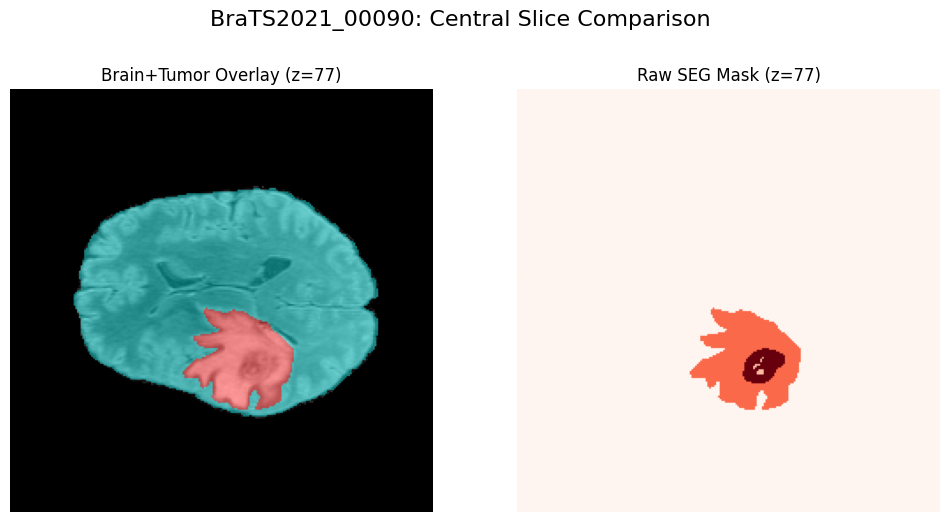


Processing BraTS2021_00094...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00094/BraTS2021_00094_brain_tumor_mask.nii.gz


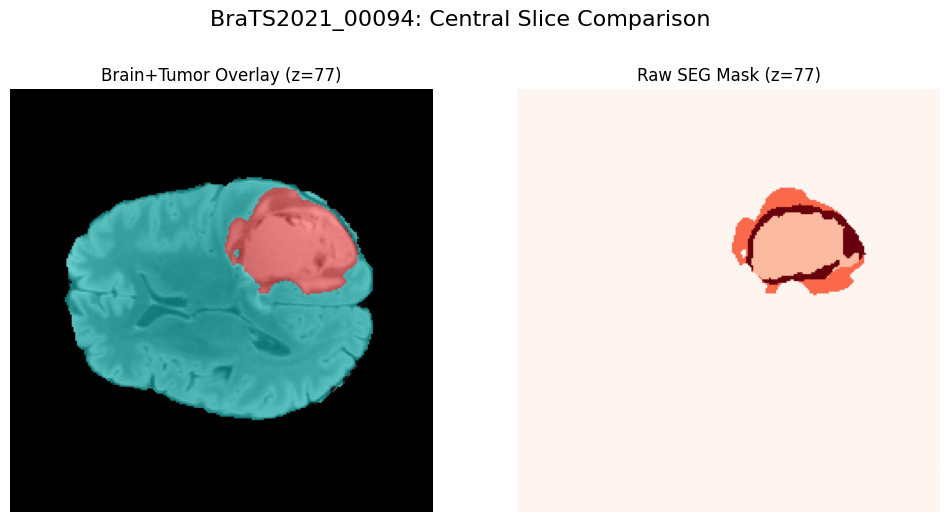


Processing BraTS2021_00095...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00095/BraTS2021_00095_brain_tumor_mask.nii.gz


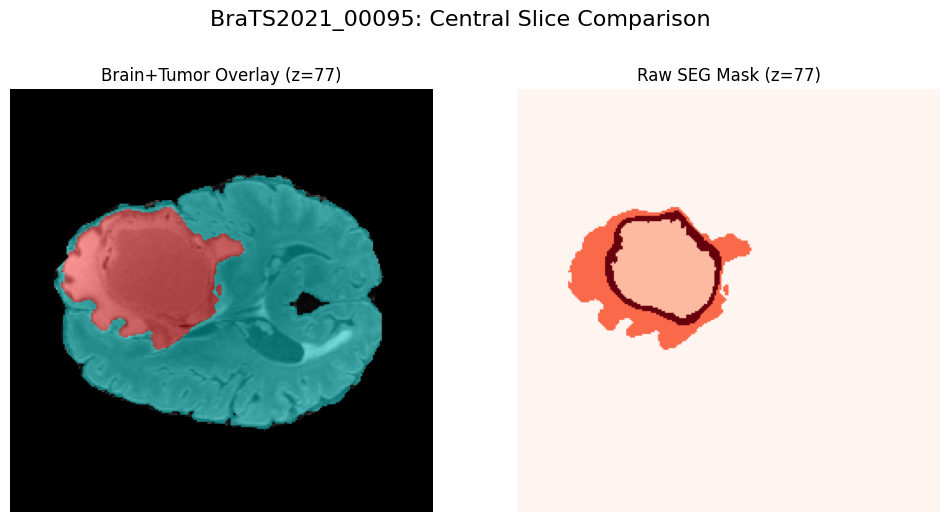


Processing BraTS2021_00096...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00096/BraTS2021_00096_brain_tumor_mask.nii.gz


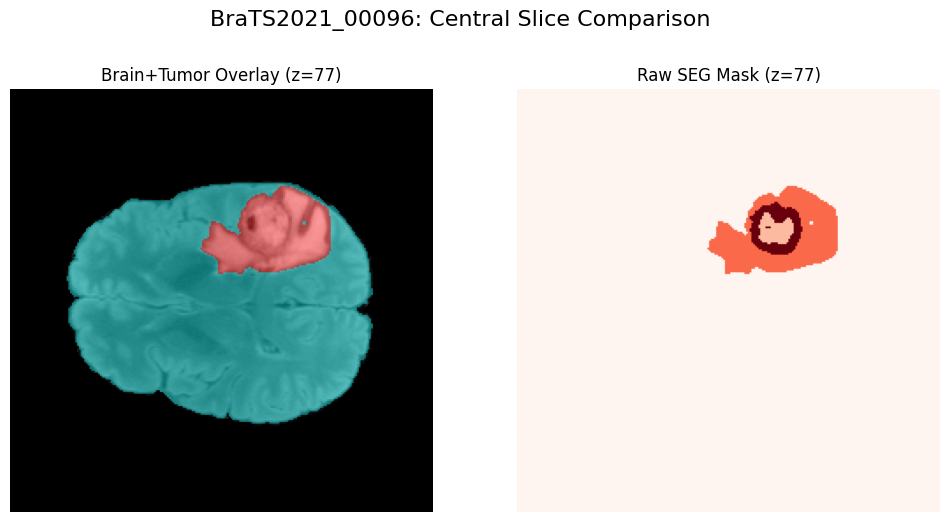


Processing BraTS2021_00097...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00097/BraTS2021_00097_brain_tumor_mask.nii.gz


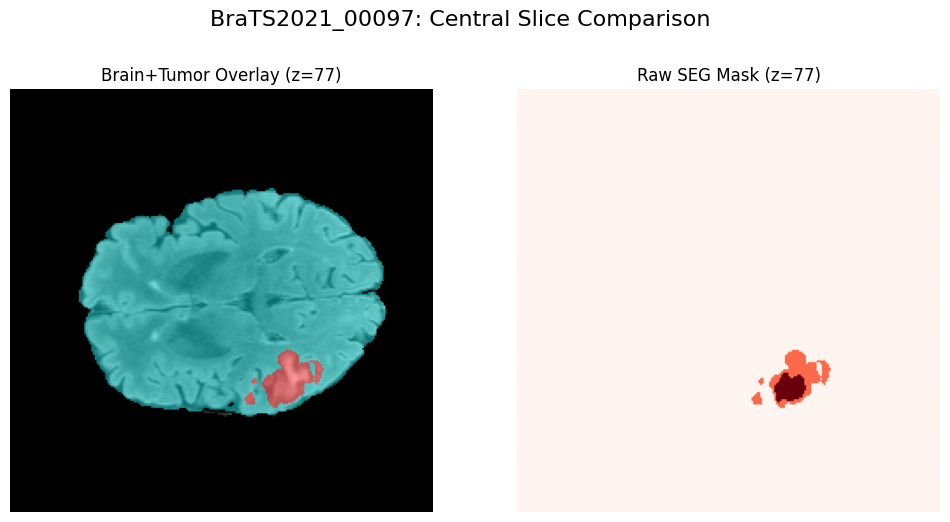


Processing BraTS2021_00098...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00098/BraTS2021_00098_brain_tumor_mask.nii.gz


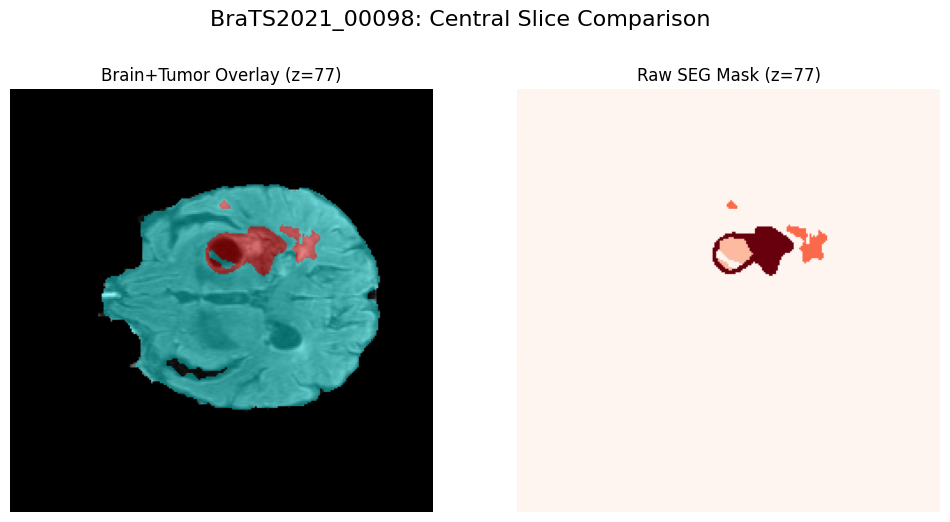


Processing BraTS2021_00099...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00099/BraTS2021_00099_brain_tumor_mask.nii.gz


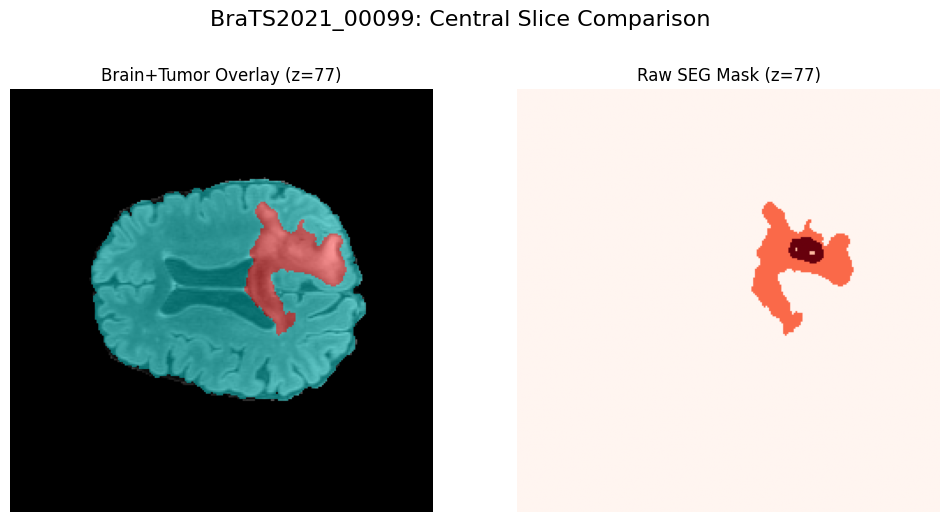


Processing BraTS2021_00100...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00100/BraTS2021_00100_brain_tumor_mask.nii.gz


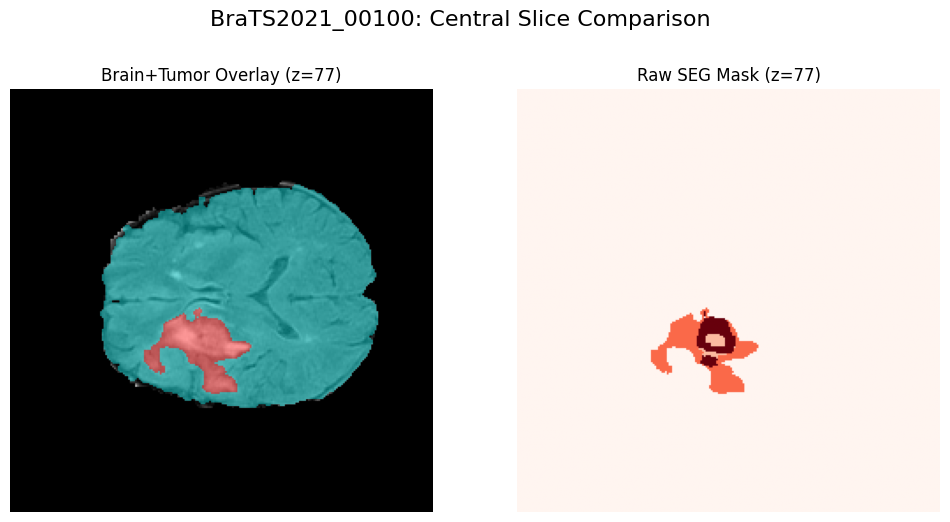


Processing BraTS2021_00101...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00101/BraTS2021_00101_brain_tumor_mask.nii.gz


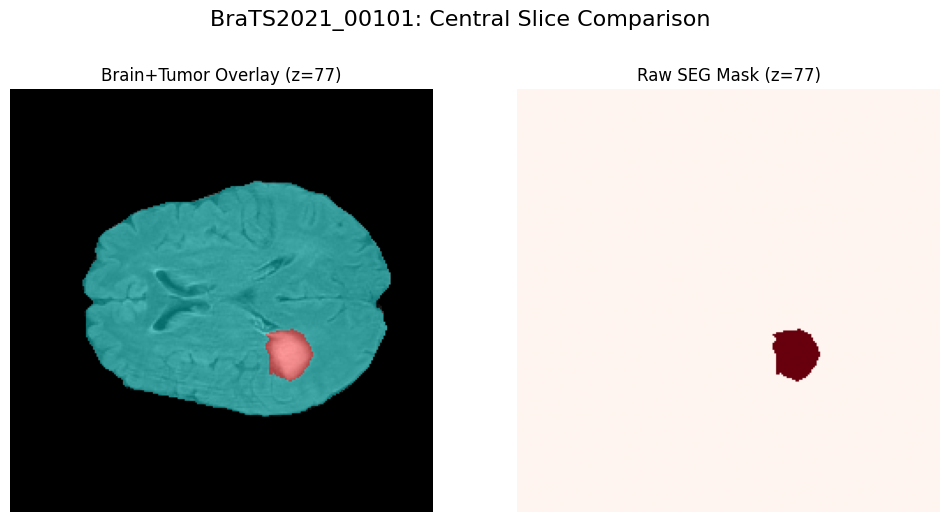


Processing BraTS2021_00102...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00102/BraTS2021_00102_brain_tumor_mask.nii.gz


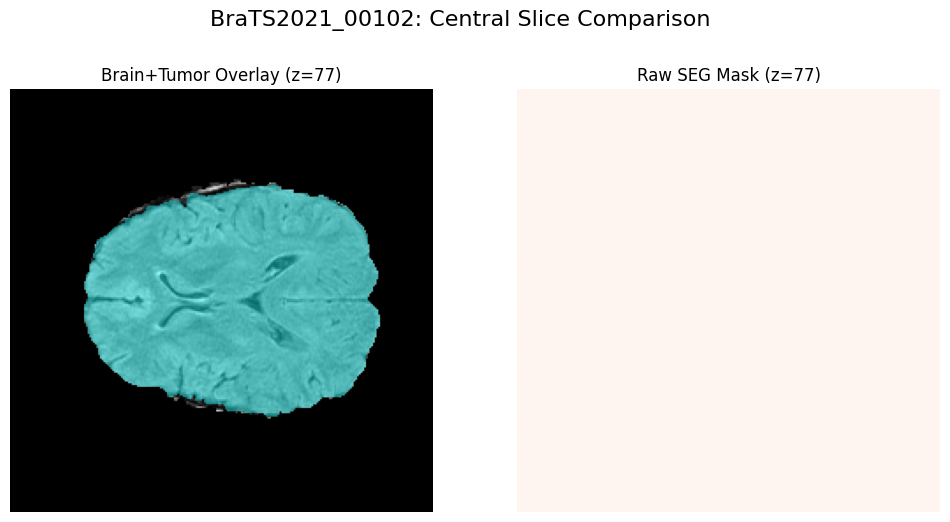


Processing BraTS2021_00103...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00103/BraTS2021_00103_brain_tumor_mask.nii.gz


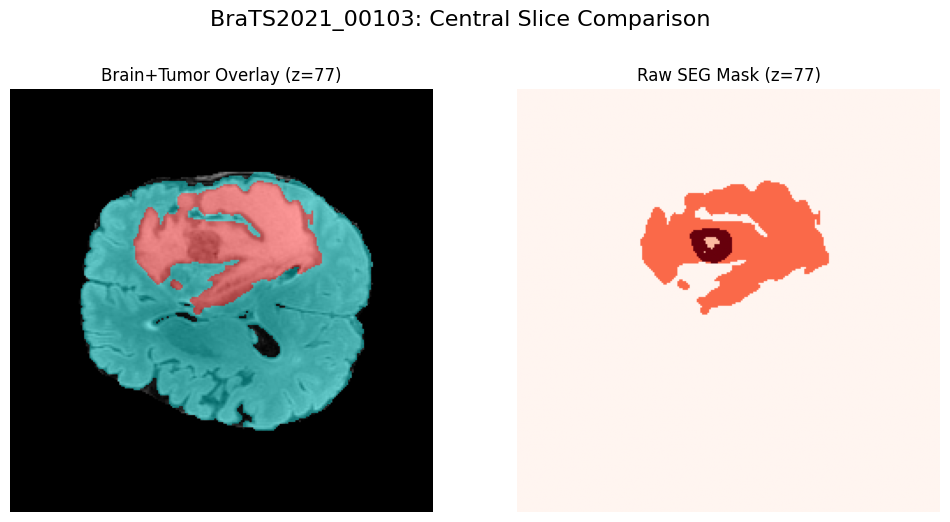


Processing BraTS2021_00104...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00104/BraTS2021_00104_brain_tumor_mask.nii.gz


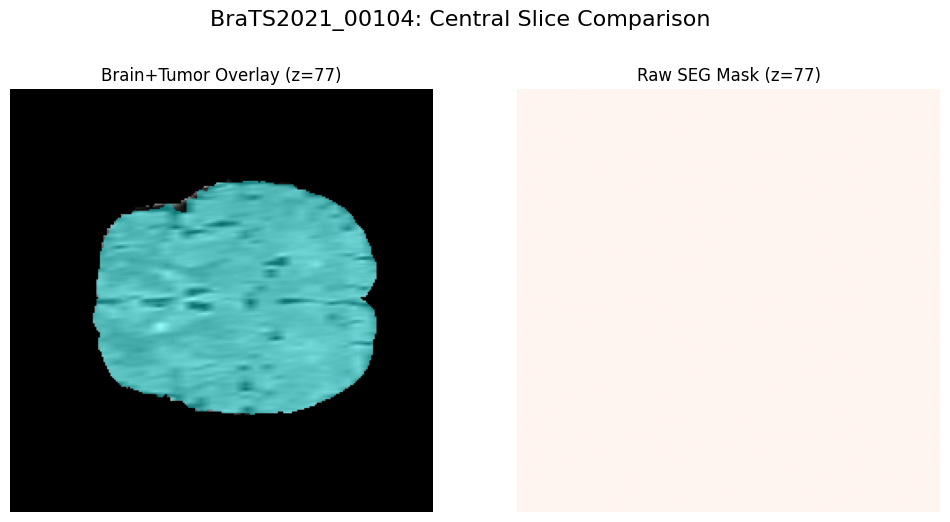


Processing BraTS2021_00105...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00105/BraTS2021_00105_brain_tumor_mask.nii.gz


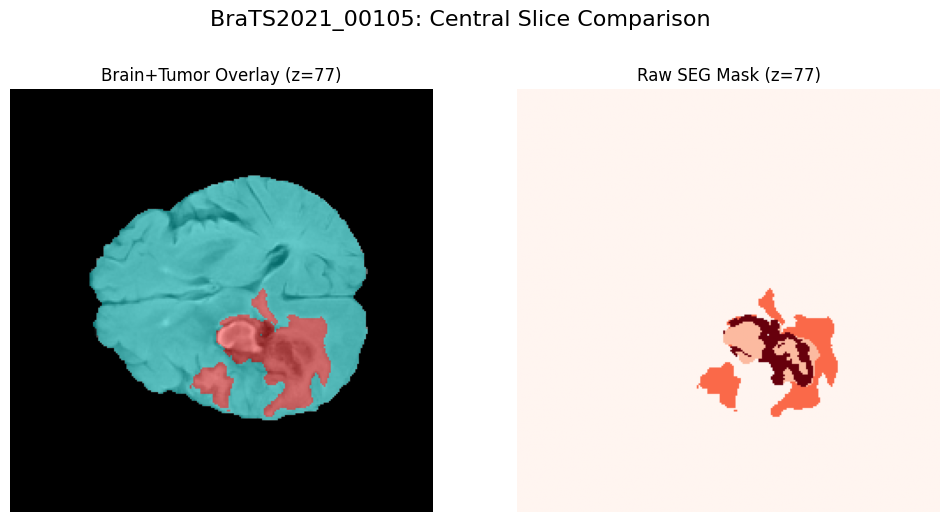


Processing BraTS2021_00106...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00106/BraTS2021_00106_brain_tumor_mask.nii.gz


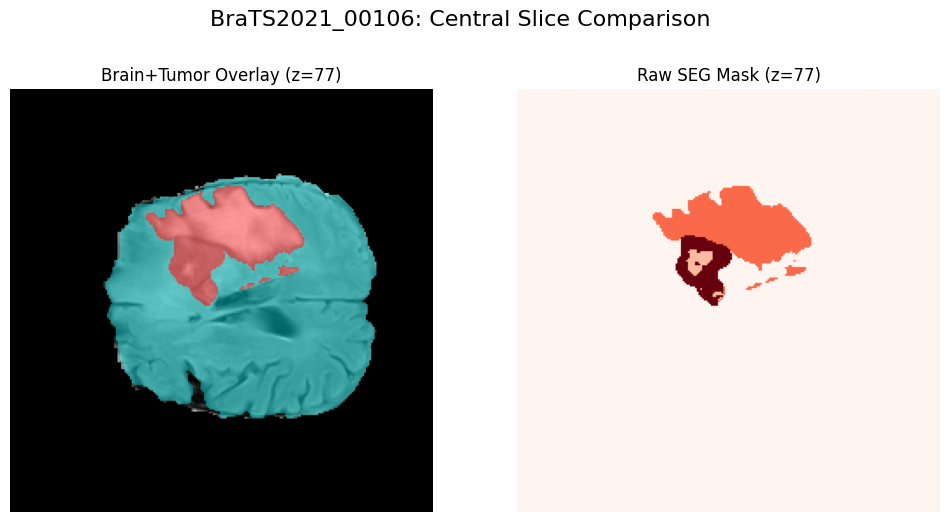


Processing BraTS2021_00107...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00107/BraTS2021_00107_brain_tumor_mask.nii.gz


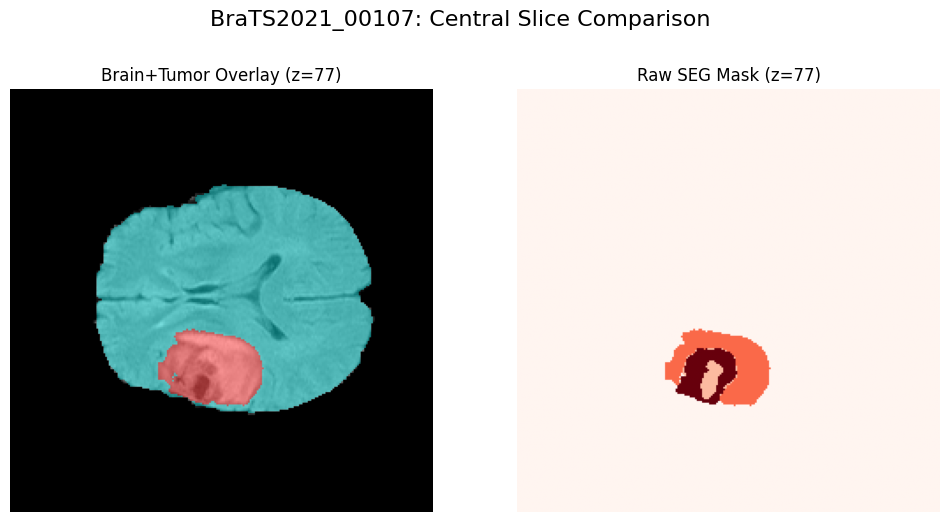


Processing BraTS2021_00108...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00108/BraTS2021_00108_brain_tumor_mask.nii.gz


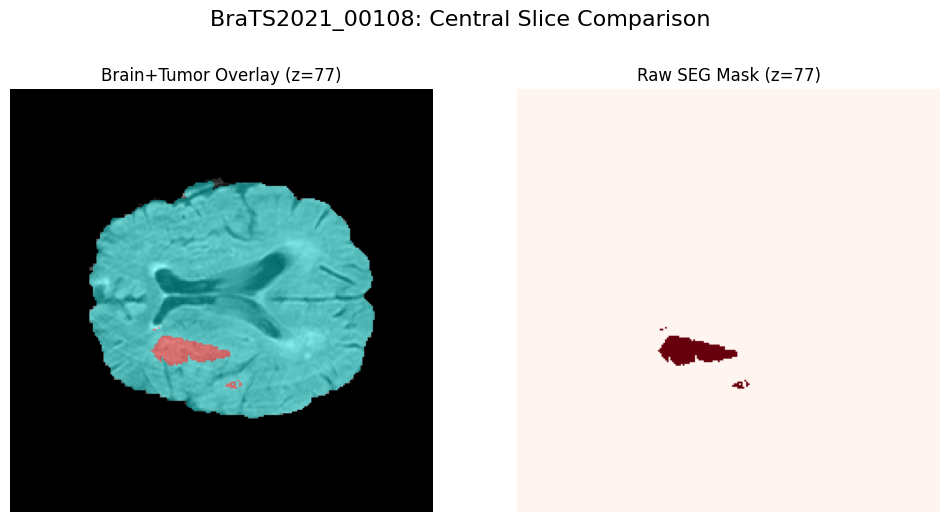


Processing BraTS2021_00109...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00109/BraTS2021_00109_brain_tumor_mask.nii.gz


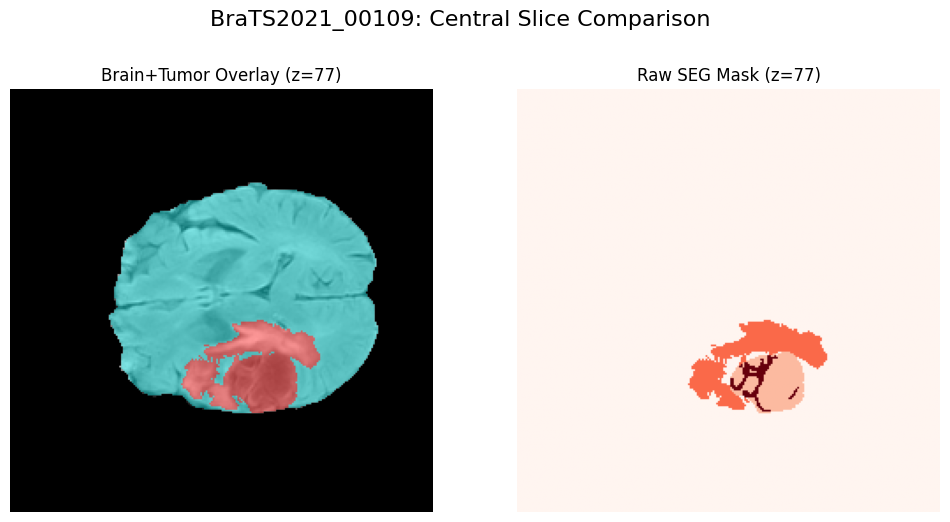


Processing BraTS2021_00110...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00110/BraTS2021_00110_brain_tumor_mask.nii.gz


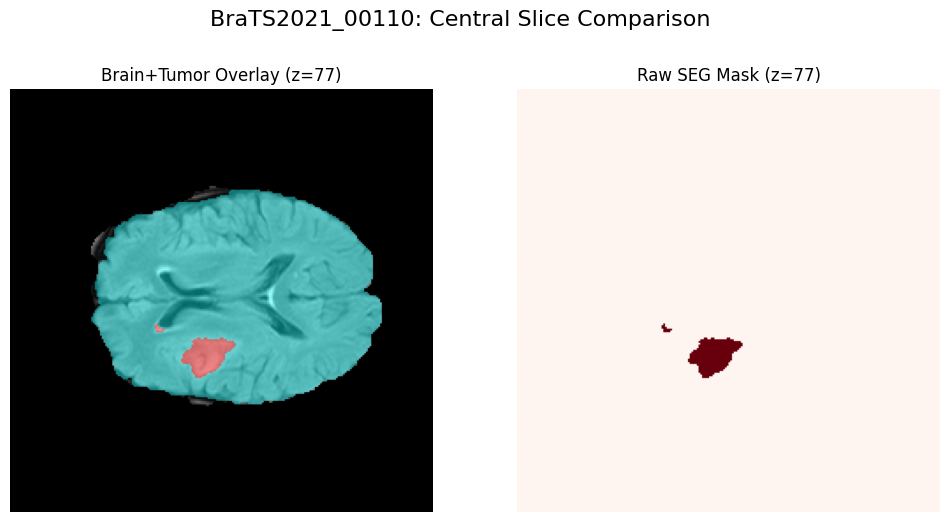


Processing BraTS2021_00111...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00111/BraTS2021_00111_brain_tumor_mask.nii.gz


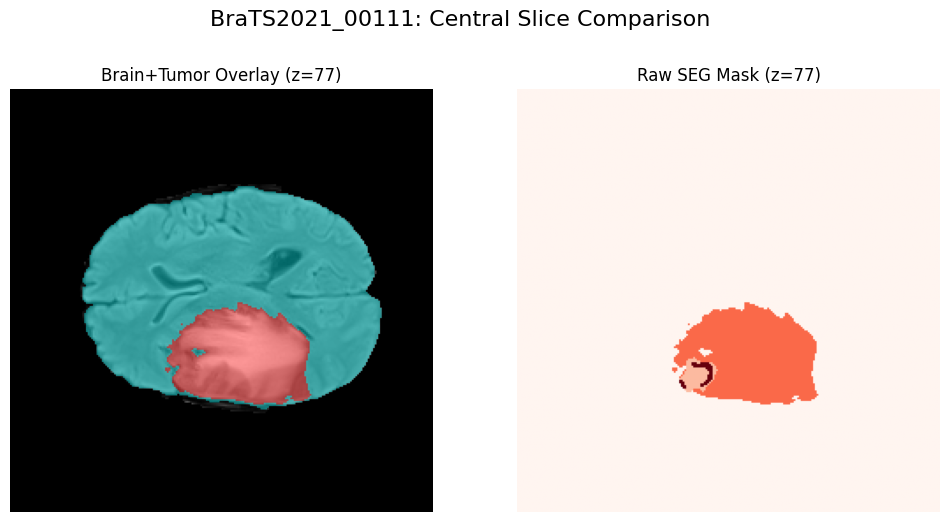


Processing BraTS2021_00112...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00112/BraTS2021_00112_brain_tumor_mask.nii.gz


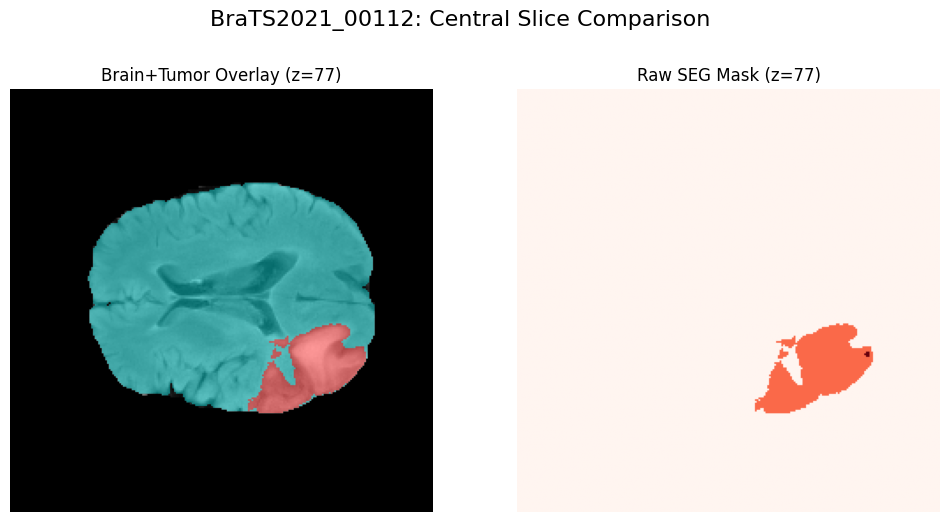


Processing BraTS2021_00113...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00113/BraTS2021_00113_brain_tumor_mask.nii.gz


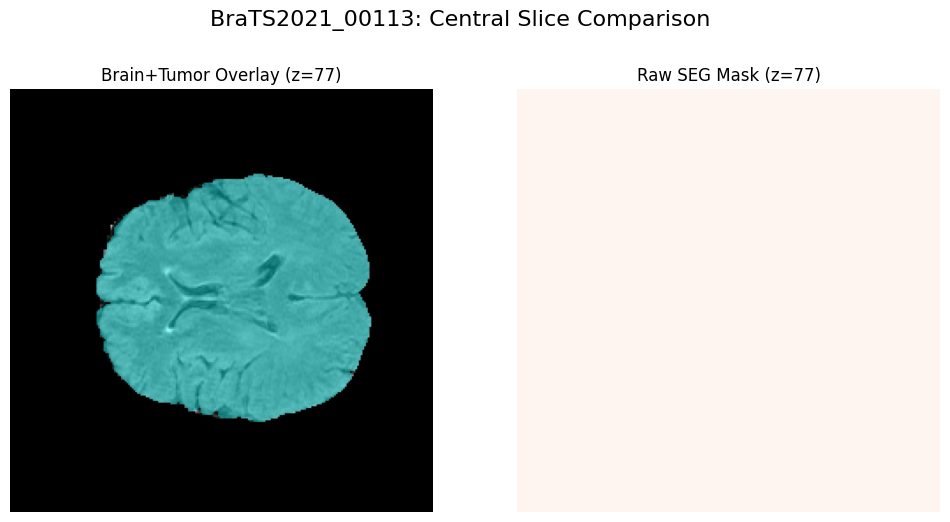


Processing BraTS2021_00115...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00115/BraTS2021_00115_brain_tumor_mask.nii.gz


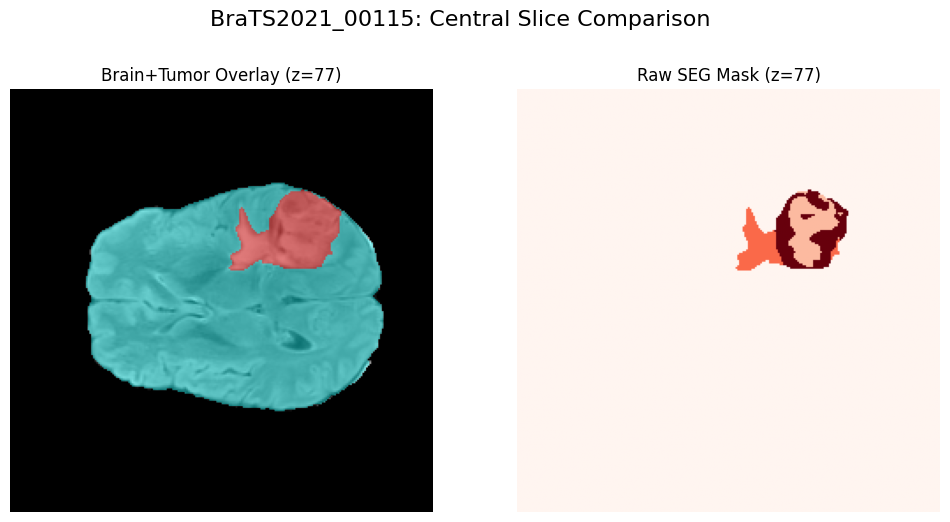


Processing BraTS2021_00116...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00116/BraTS2021_00116_brain_tumor_mask.nii.gz


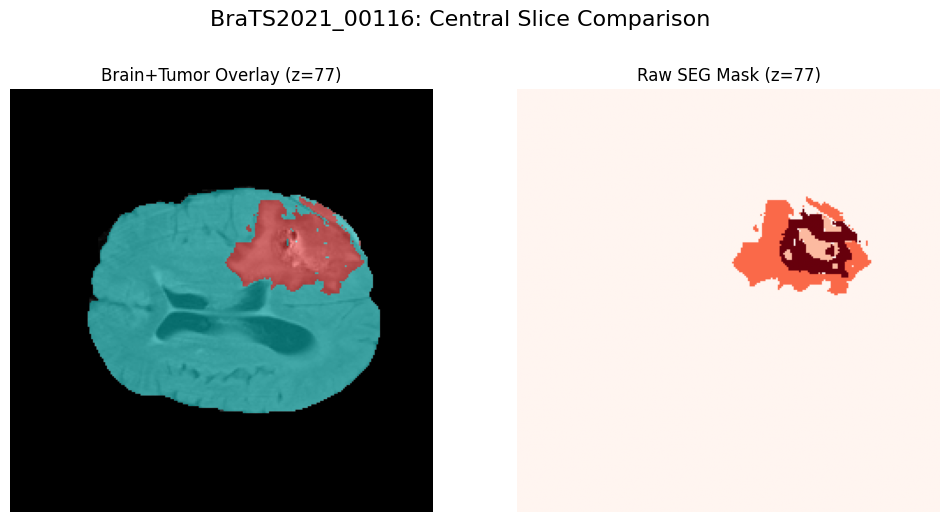


Processing BraTS2021_00117...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00117/BraTS2021_00117_brain_tumor_mask.nii.gz


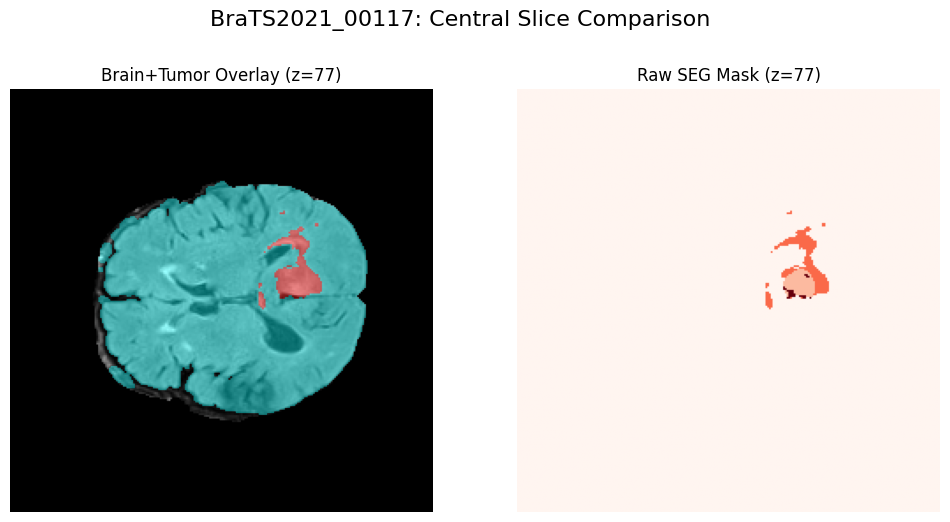


Processing BraTS2021_00118...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00118/BraTS2021_00118_brain_tumor_mask.nii.gz


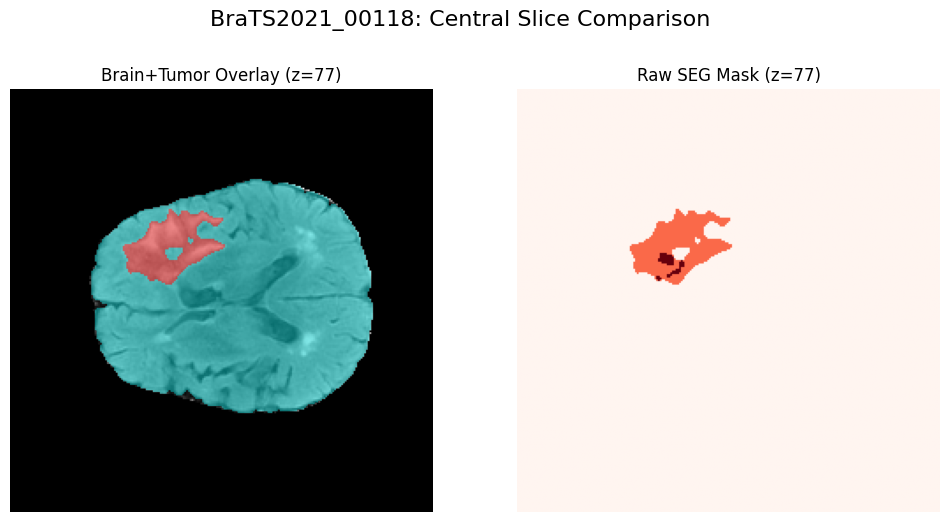


Processing BraTS2021_00120...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00120/BraTS2021_00120_brain_tumor_mask.nii.gz


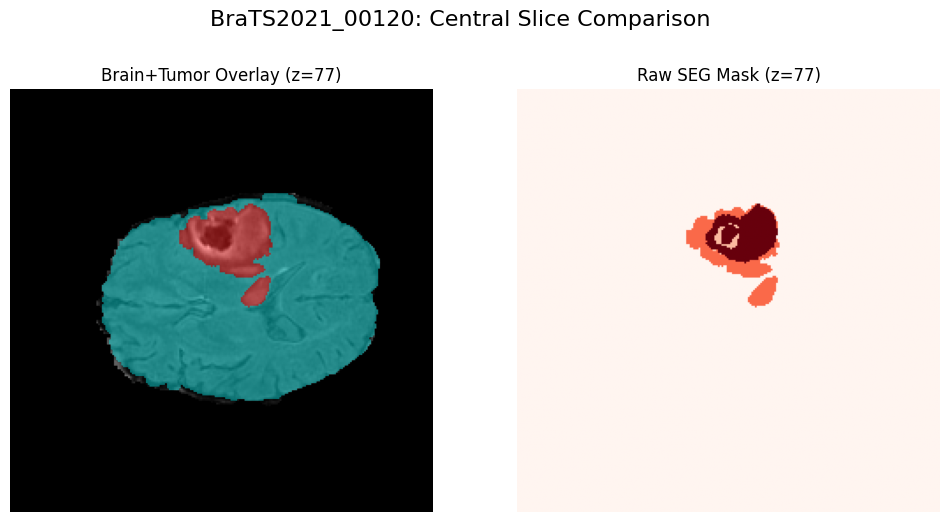


Processing BraTS2021_00121...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00121/BraTS2021_00121_brain_tumor_mask.nii.gz


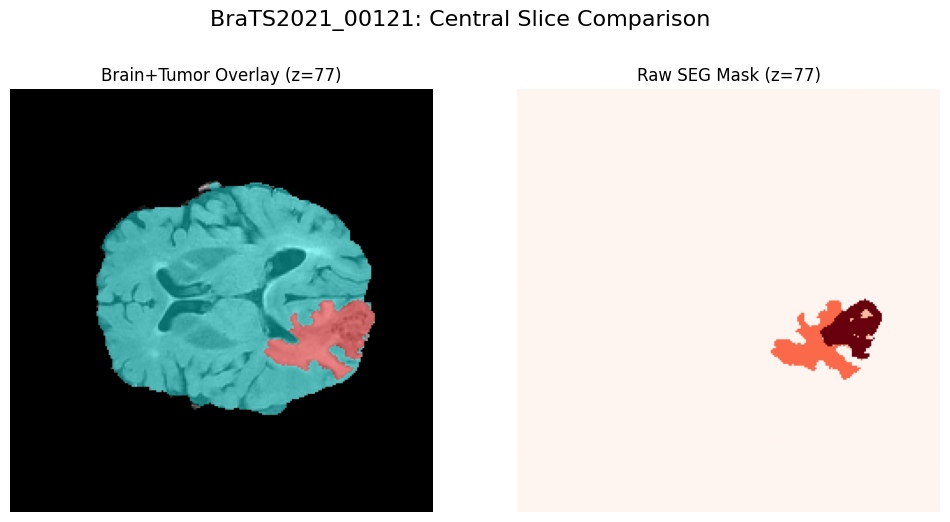


Processing BraTS2021_00122...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00122/BraTS2021_00122_brain_tumor_mask.nii.gz


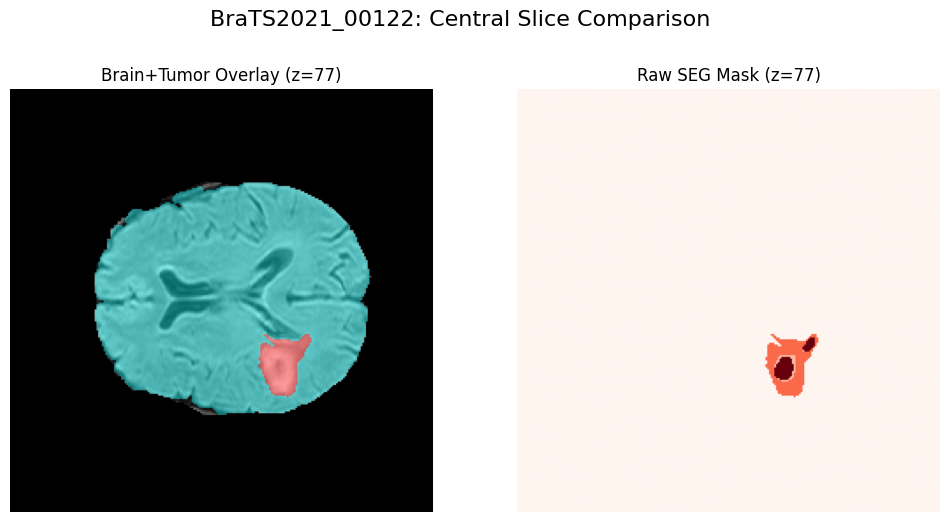


Processing BraTS2021_00123...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00123/BraTS2021_00123_brain_tumor_mask.nii.gz


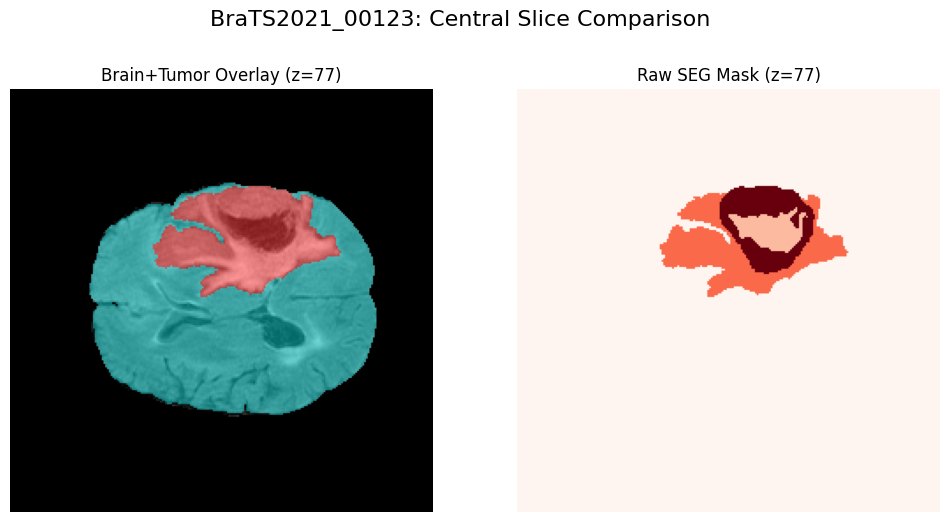


Processing BraTS2021_00124...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00124/BraTS2021_00124_brain_tumor_mask.nii.gz


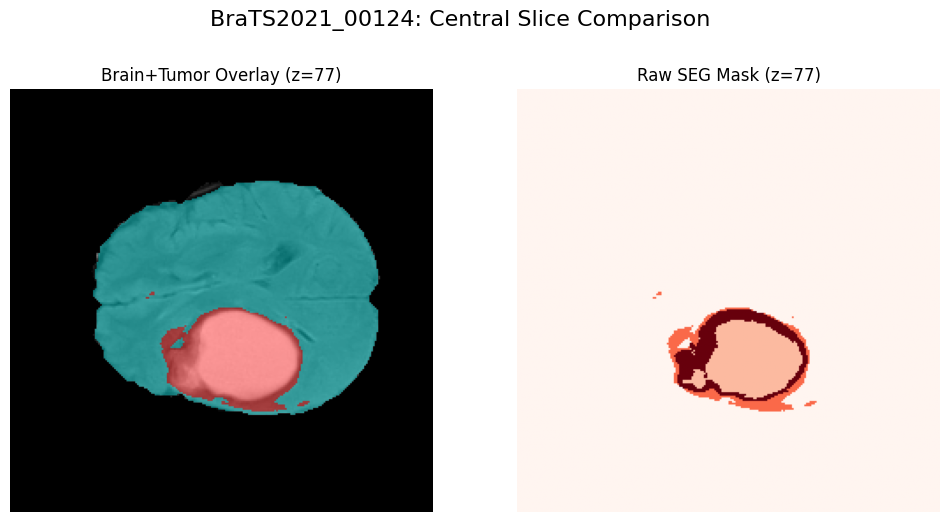


Processing BraTS2021_00126...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00126/BraTS2021_00126_brain_tumor_mask.nii.gz


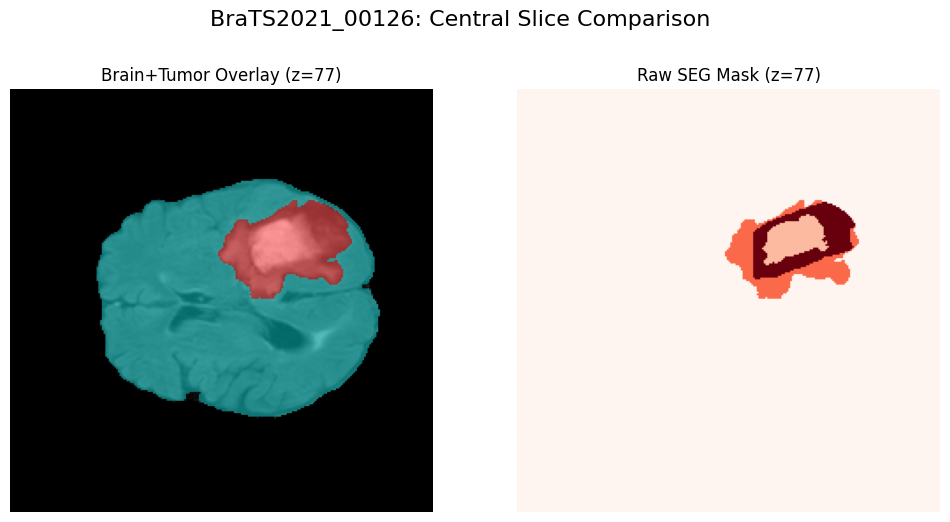


Processing BraTS2021_00127...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00127/BraTS2021_00127_brain_tumor_mask.nii.gz


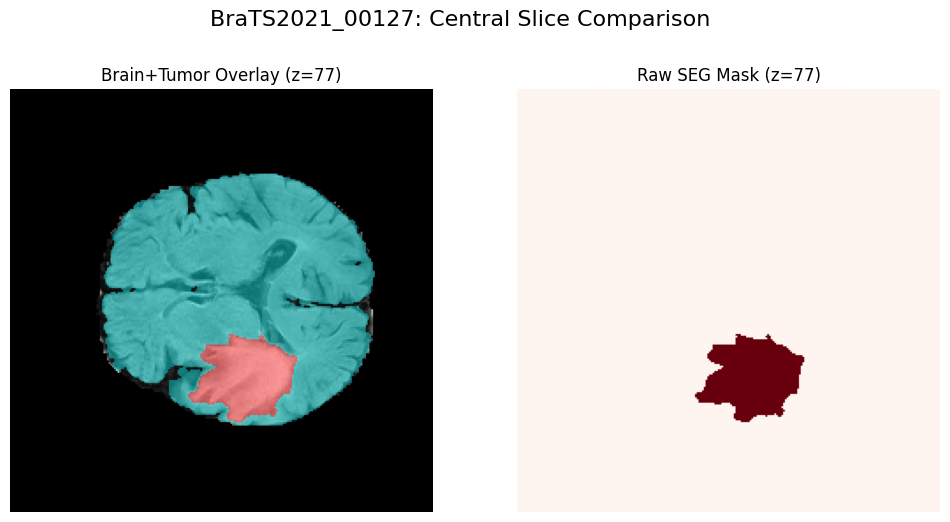


Processing BraTS2021_00128...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00128/BraTS2021_00128_brain_tumor_mask.nii.gz


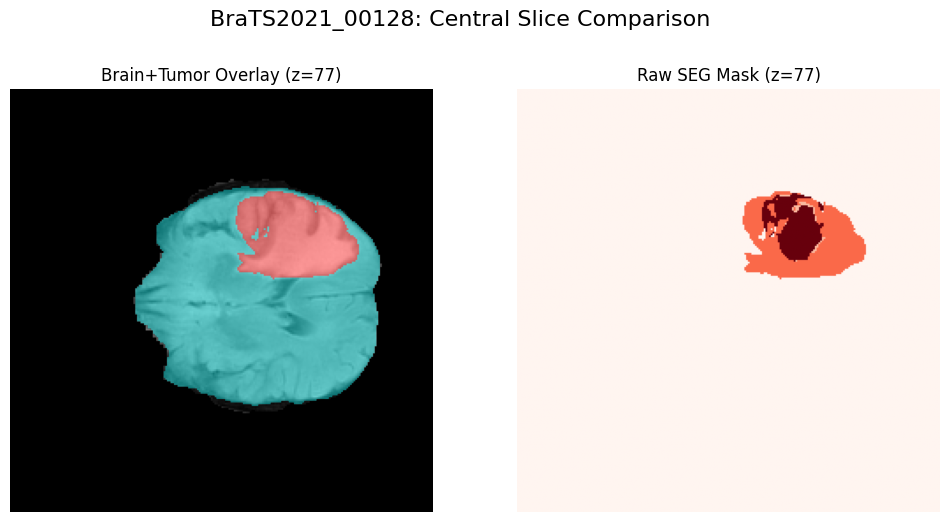


Processing BraTS2021_00130...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00130/BraTS2021_00130_brain_tumor_mask.nii.gz


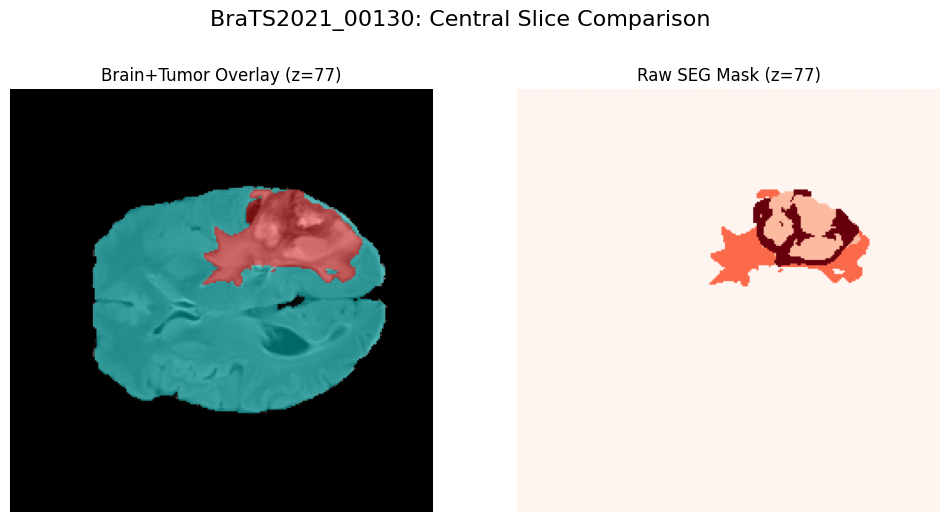


Processing BraTS2021_00131...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00131/BraTS2021_00131_brain_tumor_mask.nii.gz


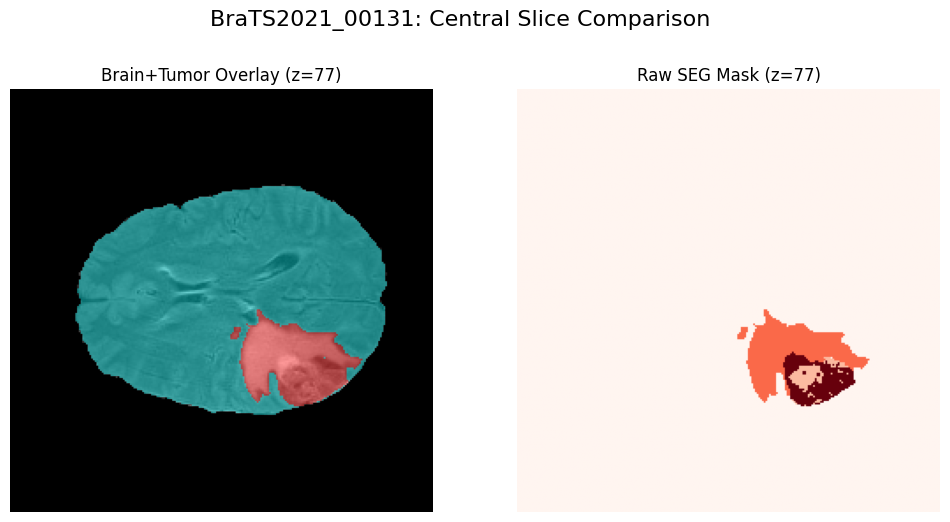


Processing BraTS2021_00132...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00132/BraTS2021_00132_brain_tumor_mask.nii.gz


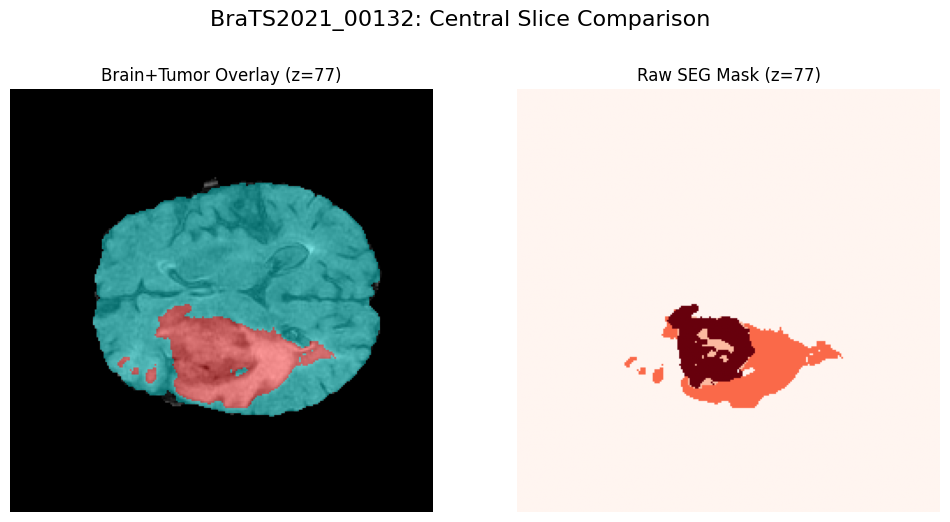


Processing BraTS2021_00133...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00133/BraTS2021_00133_brain_tumor_mask.nii.gz


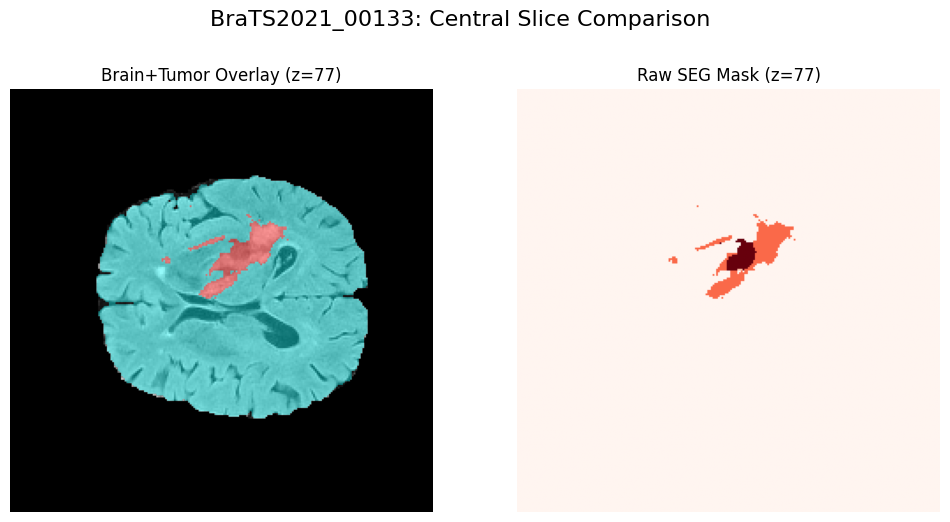


Processing BraTS2021_00134...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00134/BraTS2021_00134_brain_tumor_mask.nii.gz


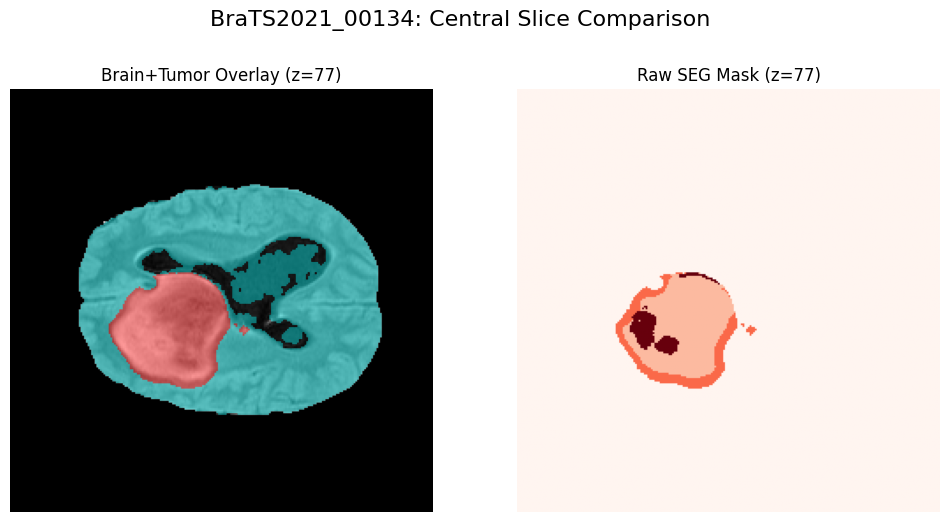


Processing BraTS2021_00136...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00136/BraTS2021_00136_brain_tumor_mask.nii.gz


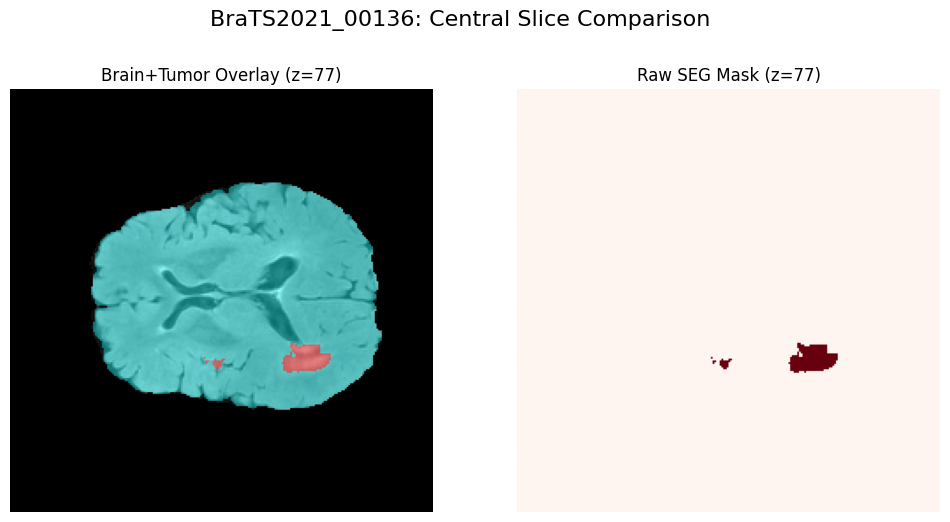


Processing BraTS2021_00137...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00137/BraTS2021_00137_brain_tumor_mask.nii.gz


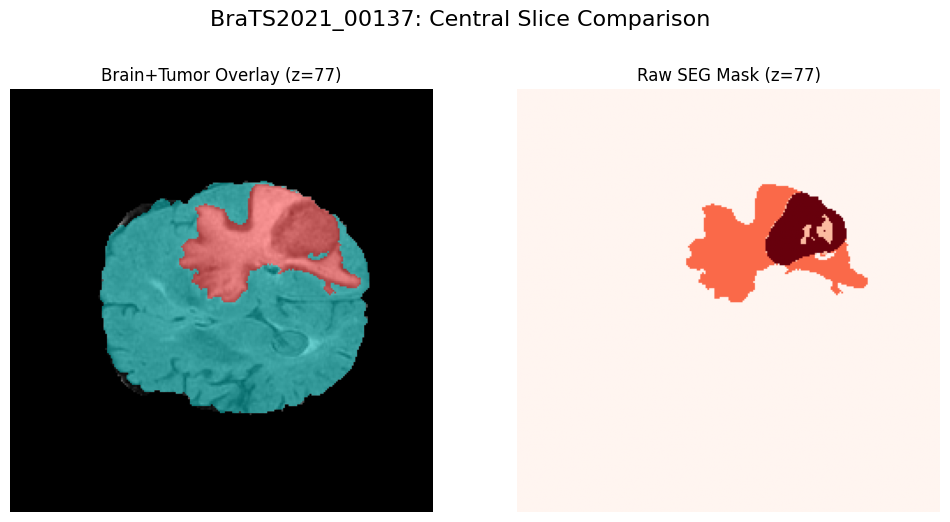


Processing BraTS2021_00138...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00138/BraTS2021_00138_brain_tumor_mask.nii.gz


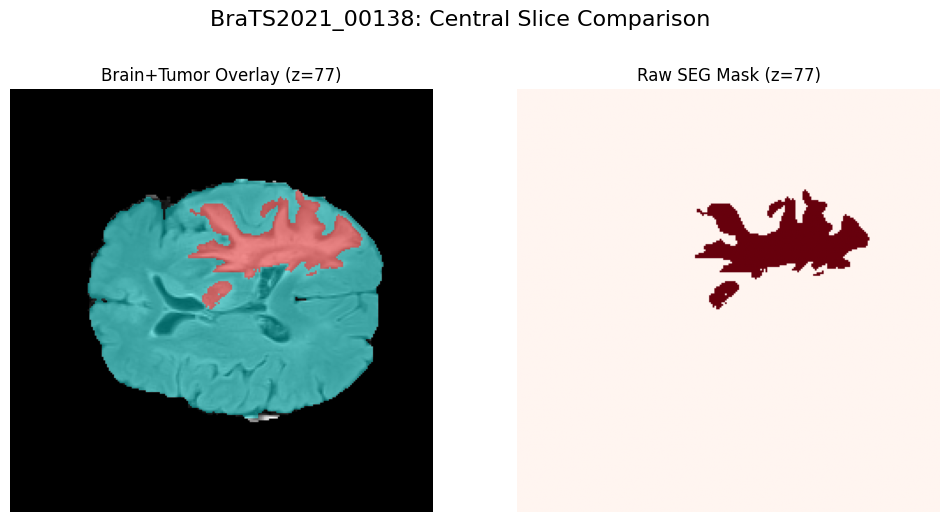


Processing BraTS2021_00139...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00139/BraTS2021_00139_brain_tumor_mask.nii.gz


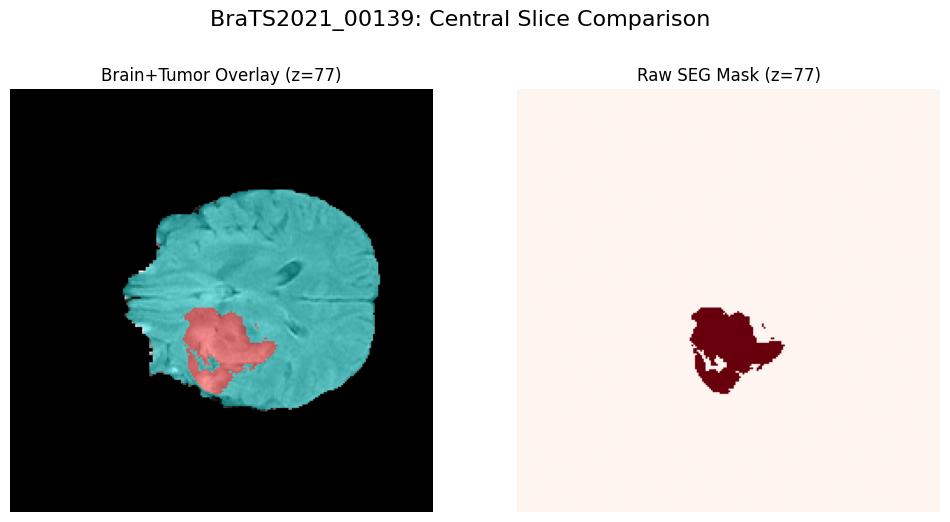


Processing BraTS2021_00140...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00140/BraTS2021_00140_brain_tumor_mask.nii.gz


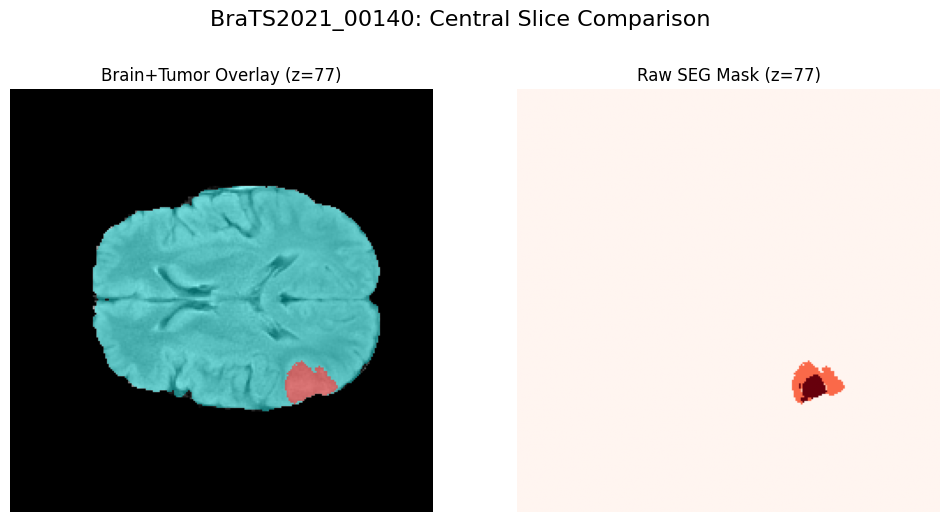


Processing BraTS2021_00142...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00142/BraTS2021_00142_brain_tumor_mask.nii.gz


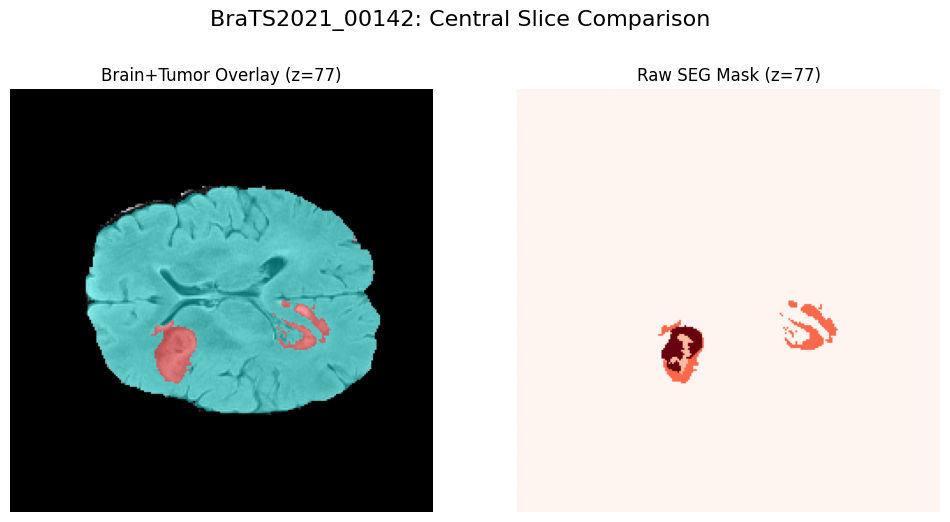


Processing BraTS2021_00143...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00143/BraTS2021_00143_brain_tumor_mask.nii.gz


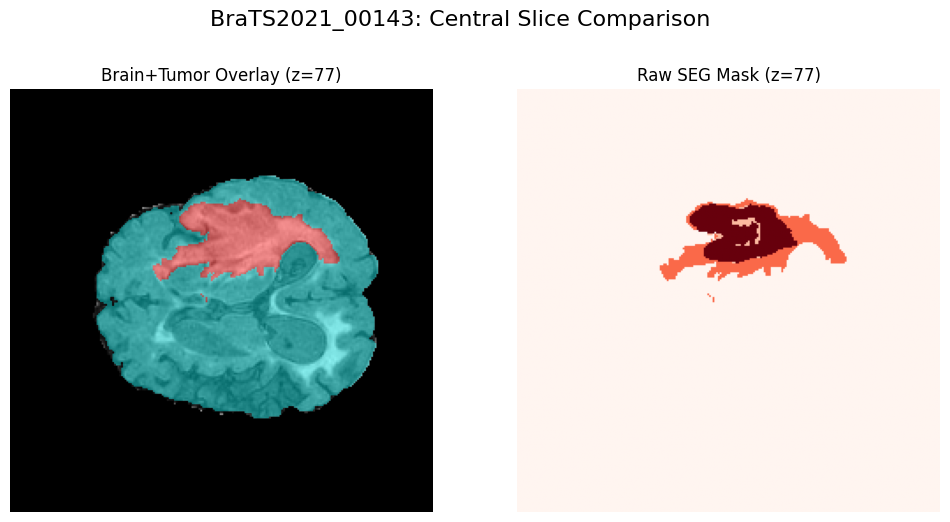


Processing BraTS2021_00144...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00144/BraTS2021_00144_brain_tumor_mask.nii.gz


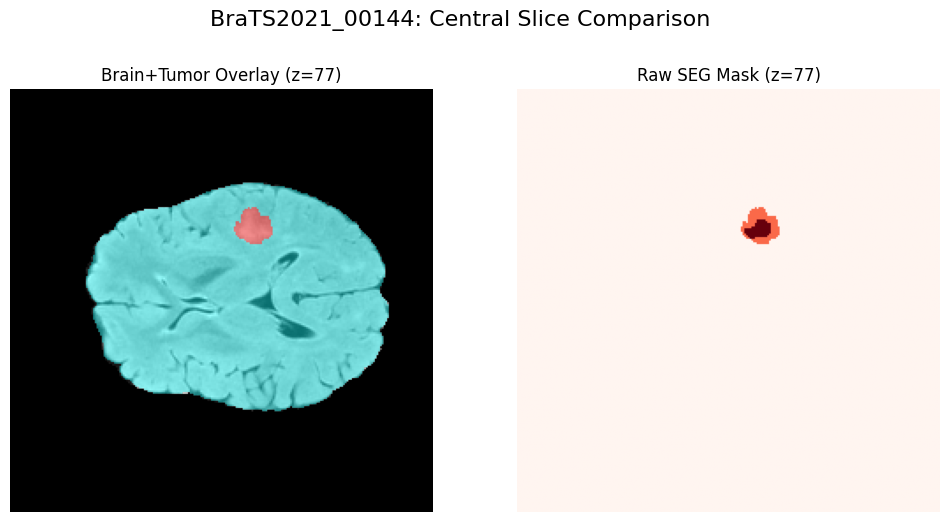


Processing BraTS2021_00146...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00146/BraTS2021_00146_brain_tumor_mask.nii.gz


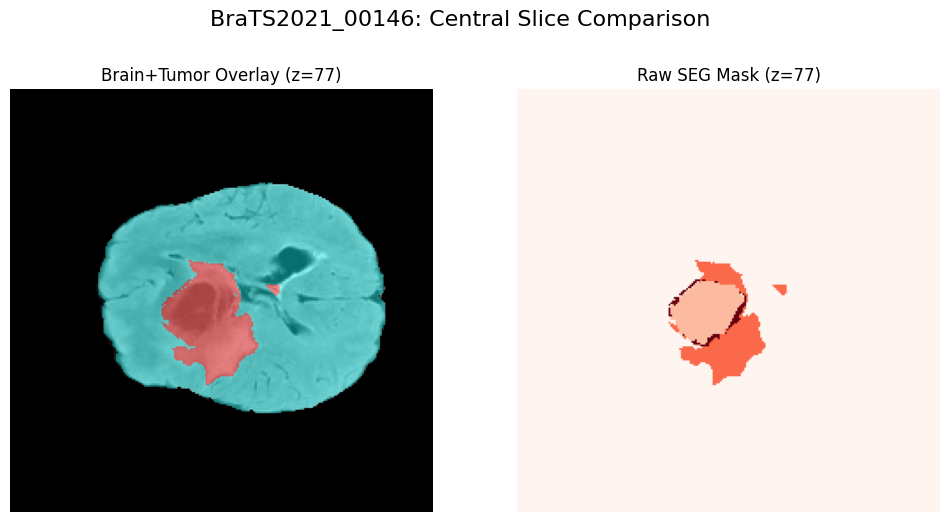


Processing BraTS2021_00147...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00147/BraTS2021_00147_brain_tumor_mask.nii.gz


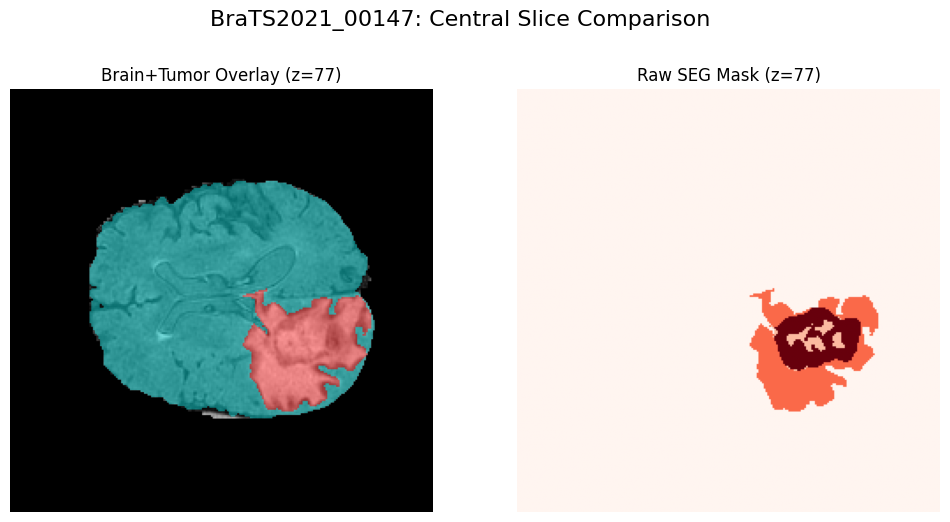


Processing BraTS2021_00148...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00148/BraTS2021_00148_brain_tumor_mask.nii.gz


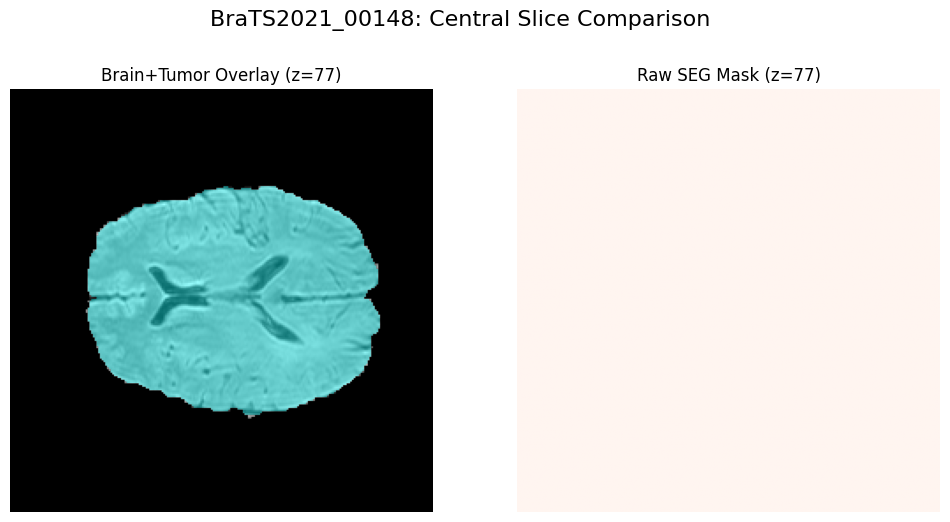


Processing BraTS2021_00149...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00149/BraTS2021_00149_brain_tumor_mask.nii.gz


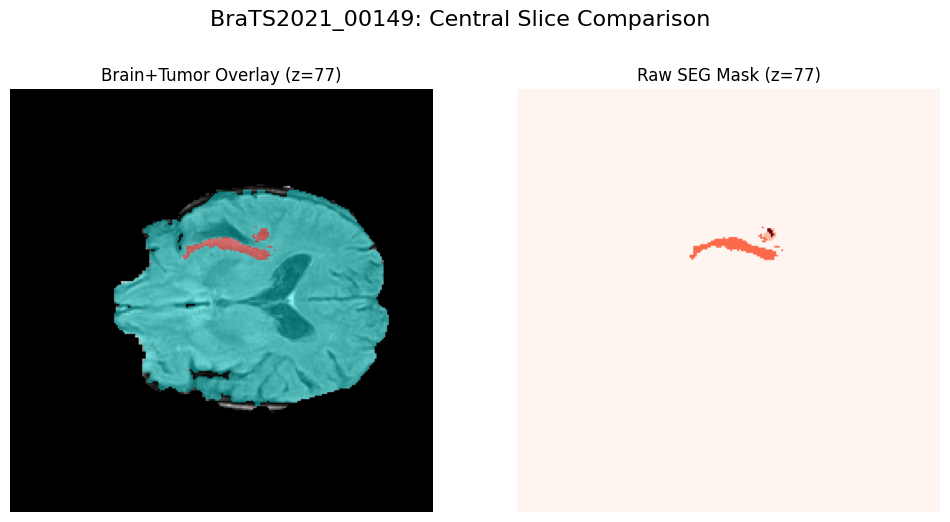


Processing BraTS2021_00150...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00150/BraTS2021_00150_brain_tumor_mask.nii.gz


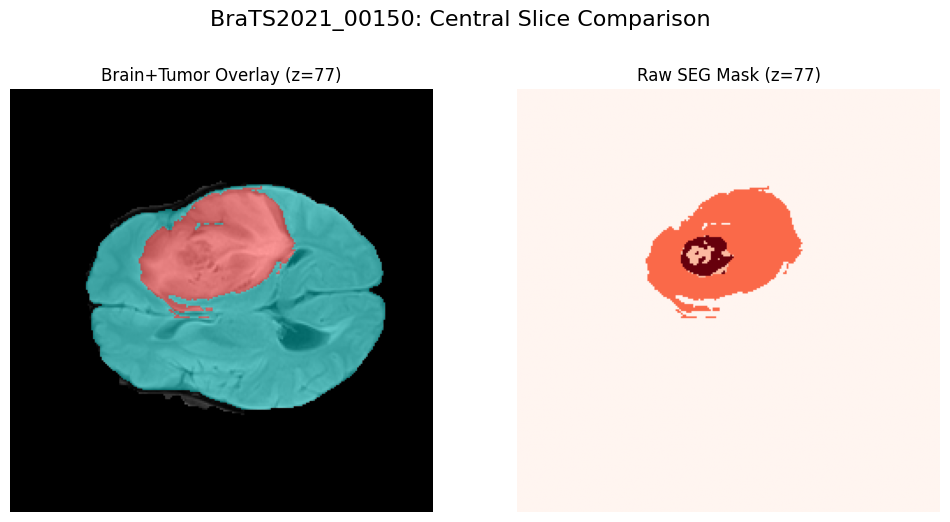


Processing BraTS2021_00151...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00151/BraTS2021_00151_brain_tumor_mask.nii.gz


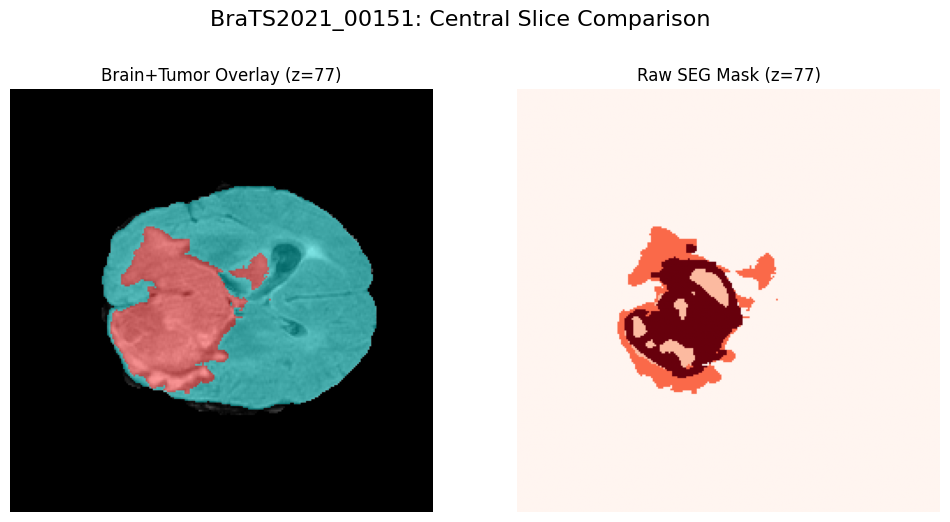


Processing BraTS2021_00152...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00152/BraTS2021_00152_brain_tumor_mask.nii.gz


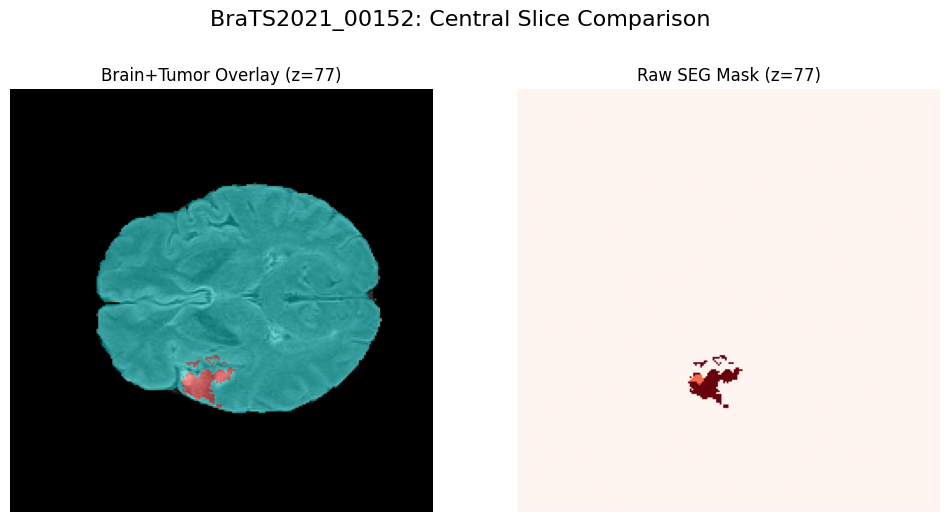


Processing BraTS2021_00154...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00154/BraTS2021_00154_brain_tumor_mask.nii.gz


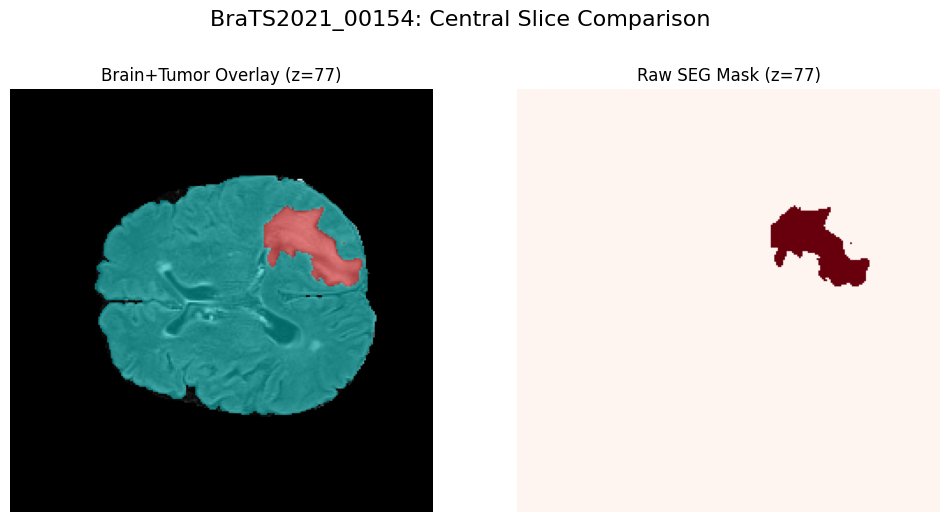


Processing BraTS2021_00155...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00155/BraTS2021_00155_brain_tumor_mask.nii.gz


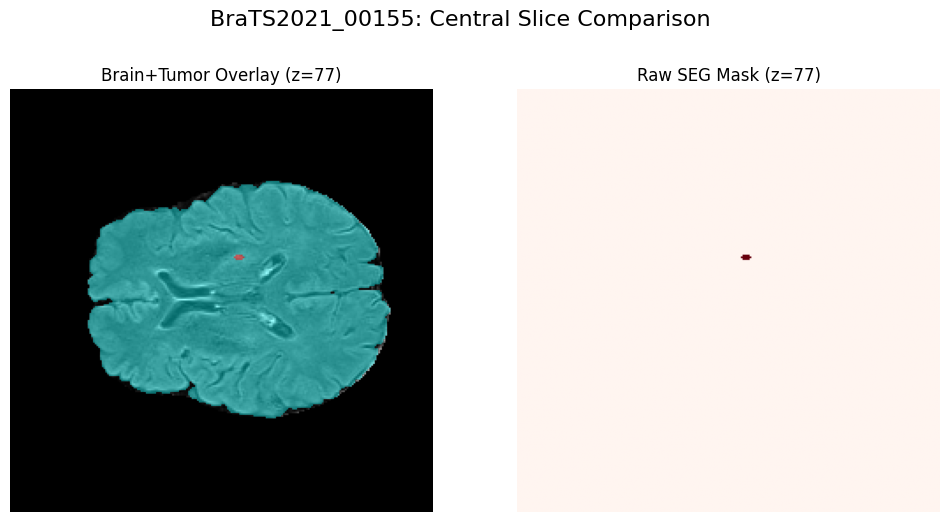


Processing BraTS2021_00156...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00156/BraTS2021_00156_brain_tumor_mask.nii.gz


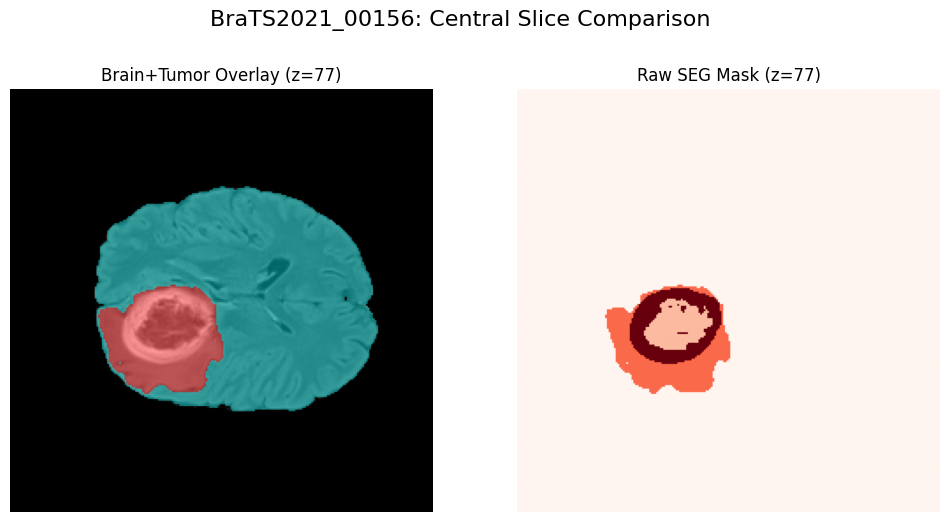


Processing BraTS2021_00157...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00157/BraTS2021_00157_brain_tumor_mask.nii.gz


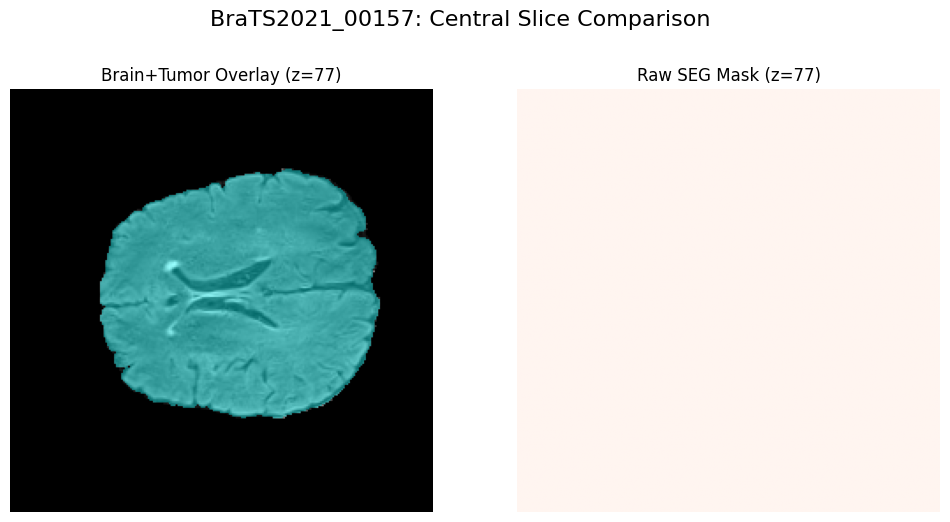


Processing BraTS2021_00158...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00158/BraTS2021_00158_brain_tumor_mask.nii.gz


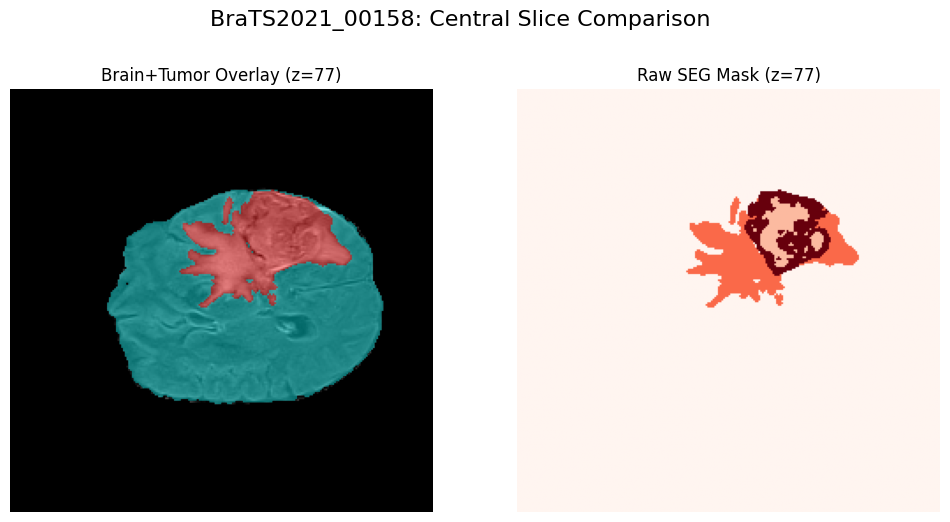


Processing BraTS2021_00159...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00159/BraTS2021_00159_brain_tumor_mask.nii.gz


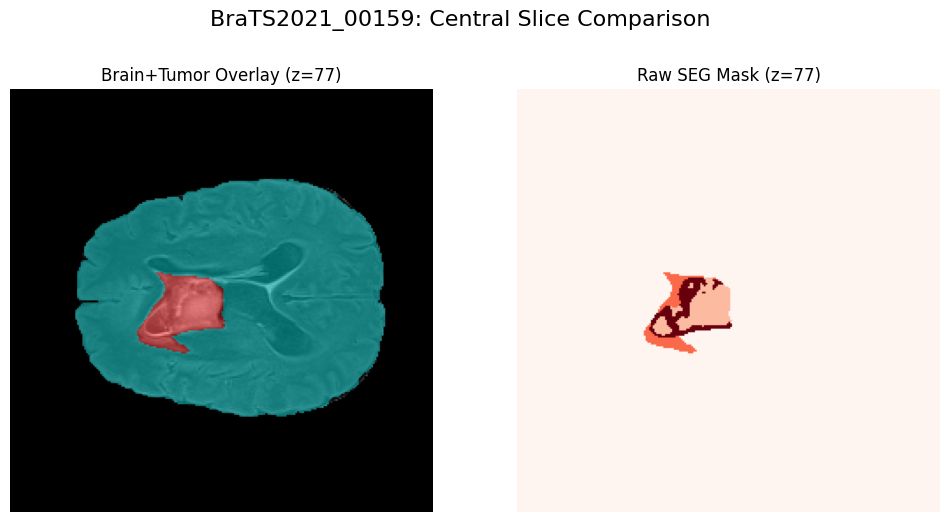


Processing BraTS2021_00160...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00160/BraTS2021_00160_brain_tumor_mask.nii.gz


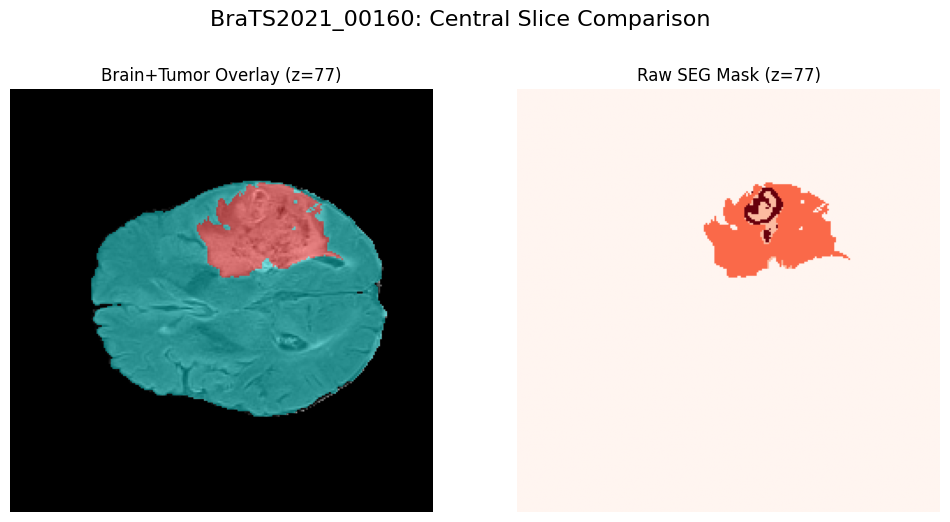


Processing BraTS2021_00162...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00162/BraTS2021_00162_brain_tumor_mask.nii.gz


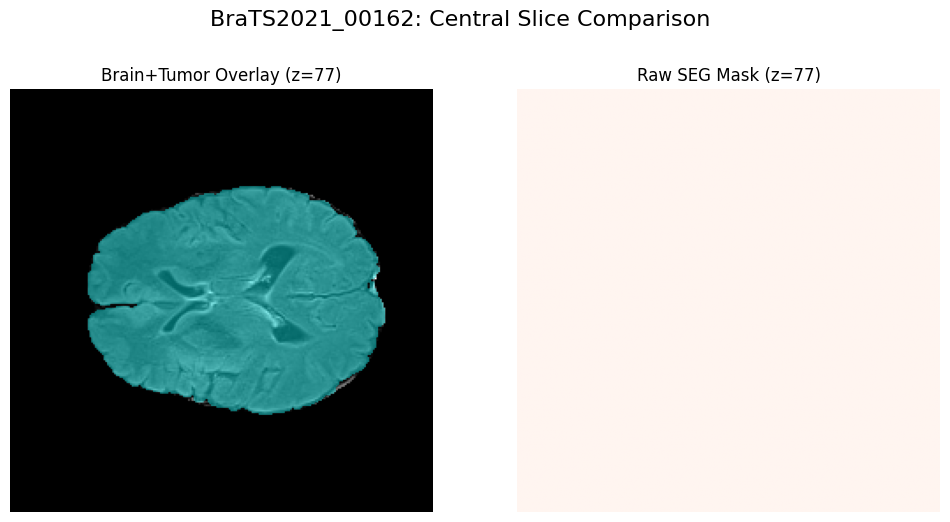


Processing BraTS2021_00165...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00165/BraTS2021_00165_brain_tumor_mask.nii.gz


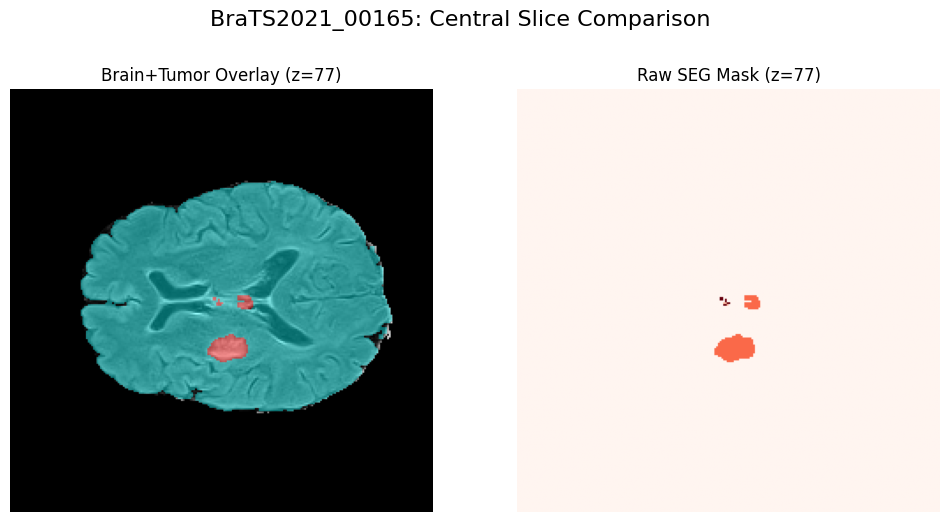


Processing BraTS2021_00166...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00166/BraTS2021_00166_brain_tumor_mask.nii.gz


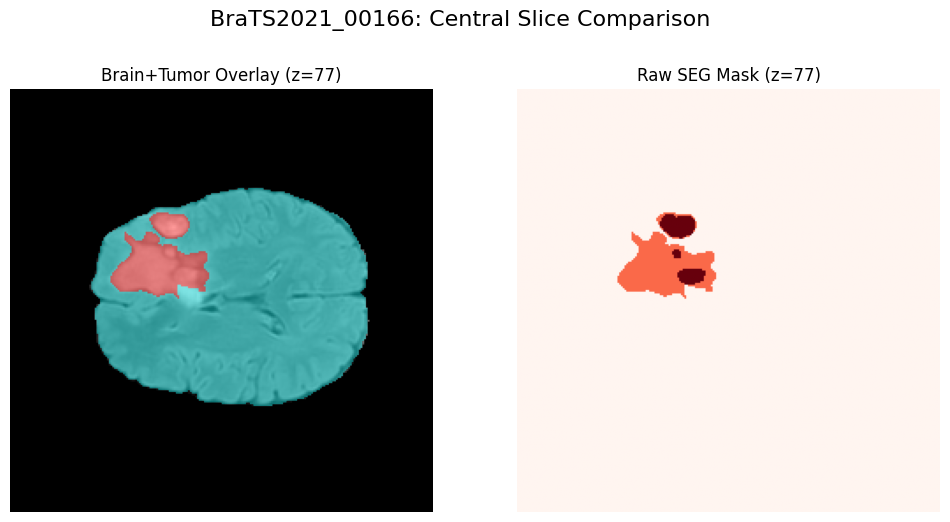


Processing BraTS2021_00167...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00167/BraTS2021_00167_brain_tumor_mask.nii.gz


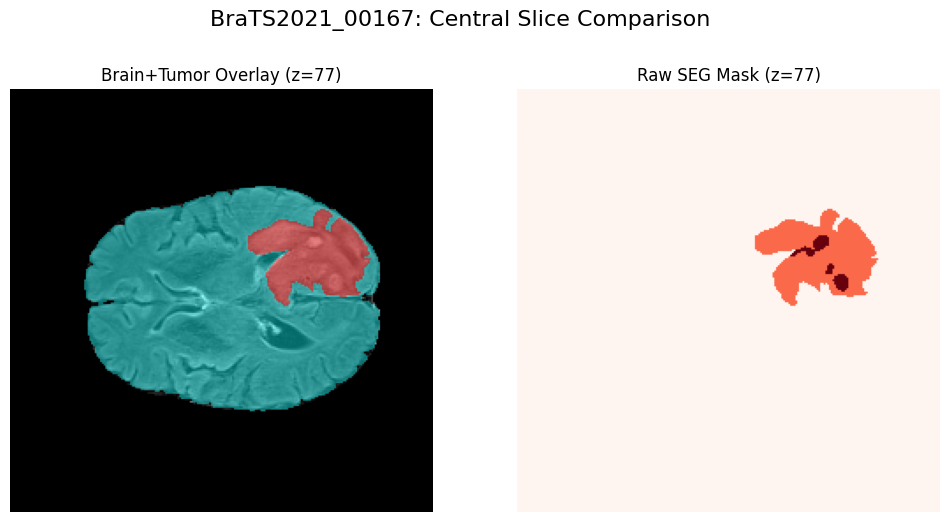


Processing BraTS2021_00170...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00170/BraTS2021_00170_brain_tumor_mask.nii.gz


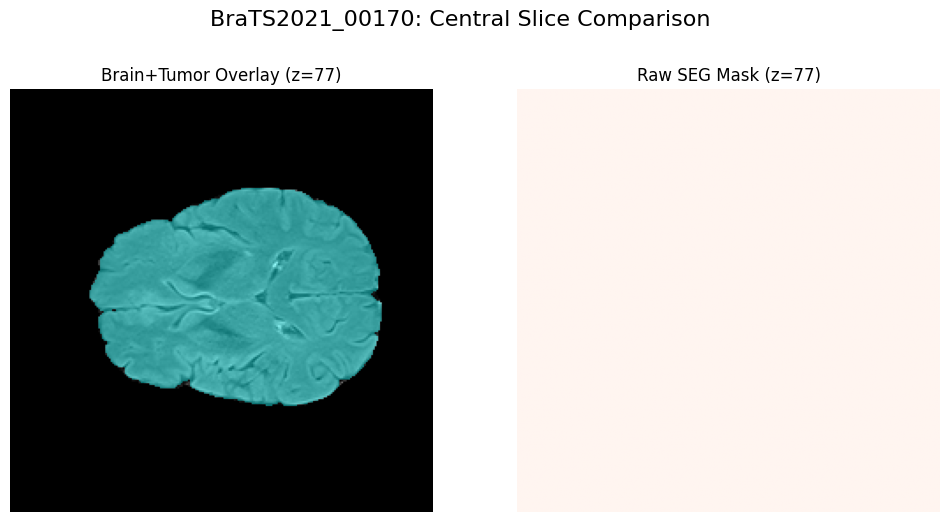


Processing BraTS2021_00171...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00171/BraTS2021_00171_brain_tumor_mask.nii.gz


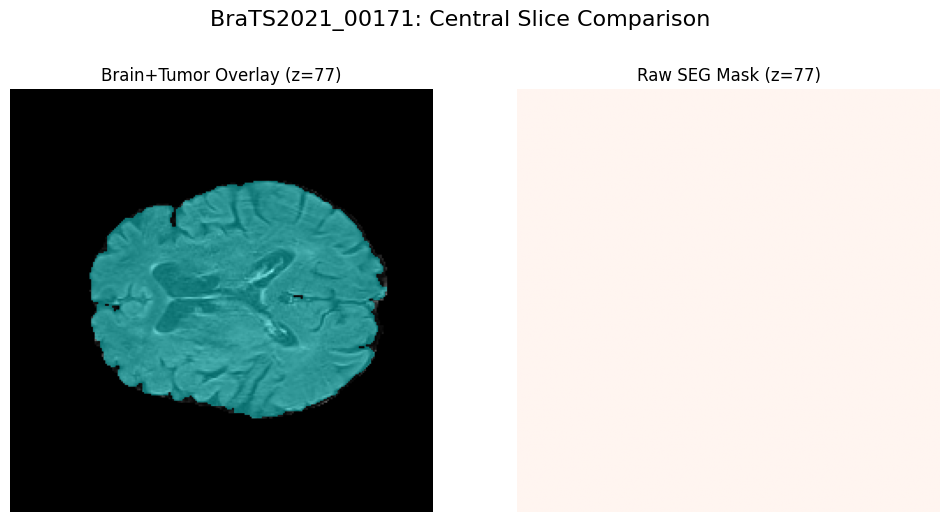


Processing BraTS2021_00172...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00172/BraTS2021_00172_brain_tumor_mask.nii.gz


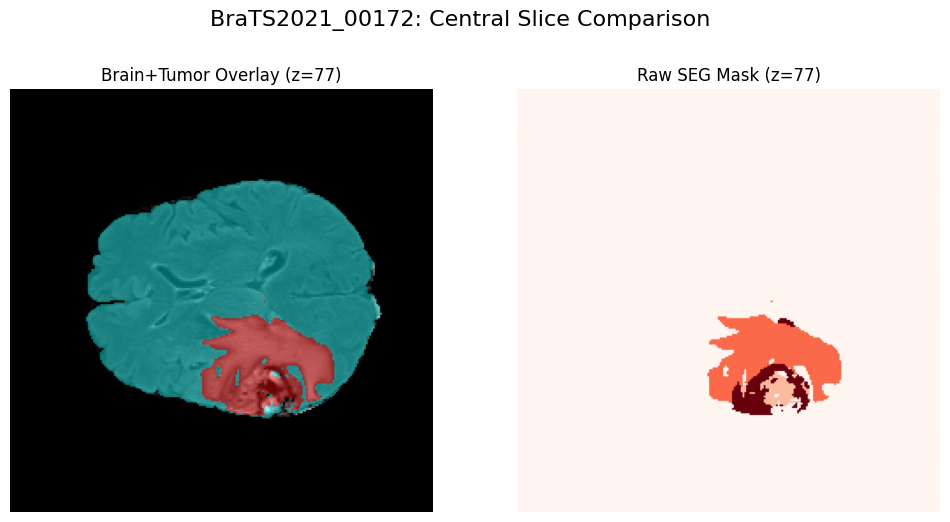


Processing BraTS2021_00176...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00176/BraTS2021_00176_brain_tumor_mask.nii.gz


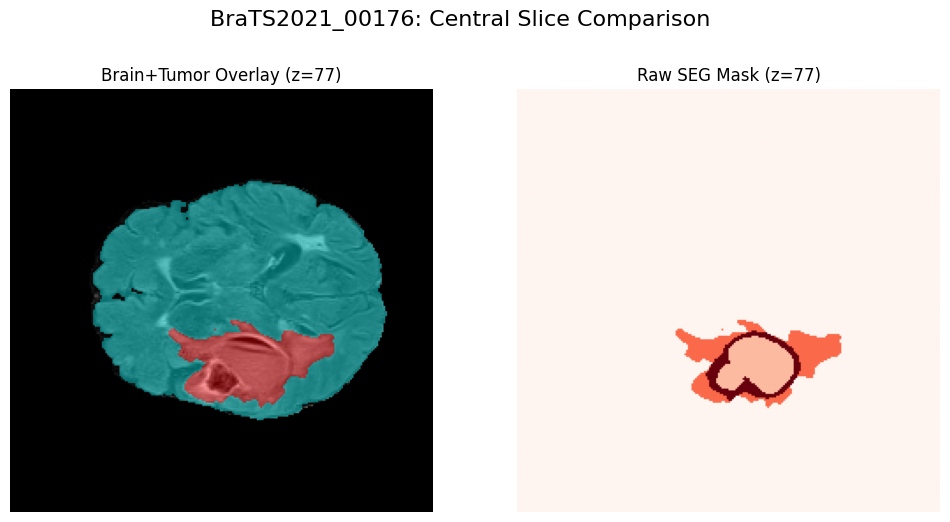


Processing BraTS2021_00177...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00177/BraTS2021_00177_brain_tumor_mask.nii.gz


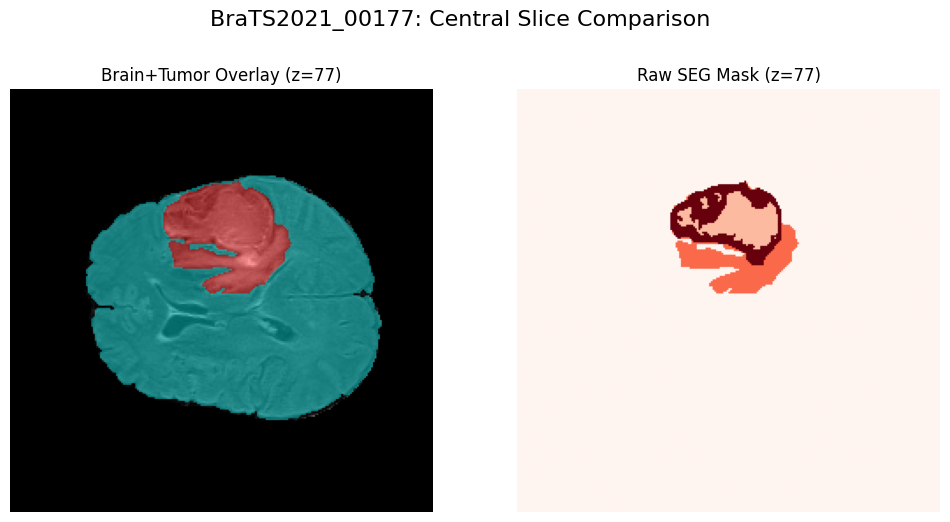


Processing BraTS2021_00178...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00178/BraTS2021_00178_brain_tumor_mask.nii.gz


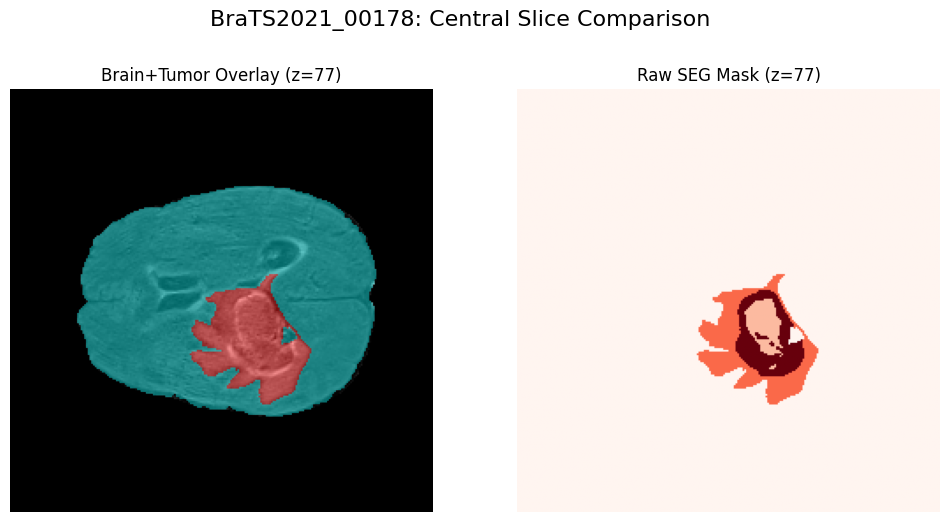


Processing BraTS2021_00183...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00183/BraTS2021_00183_brain_tumor_mask.nii.gz


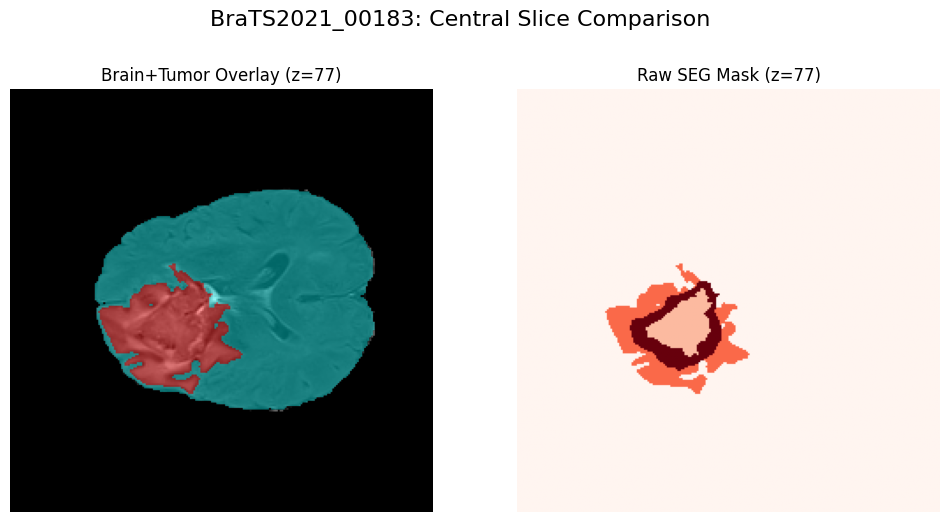


Processing BraTS2021_00184...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00184/BraTS2021_00184_brain_tumor_mask.nii.gz


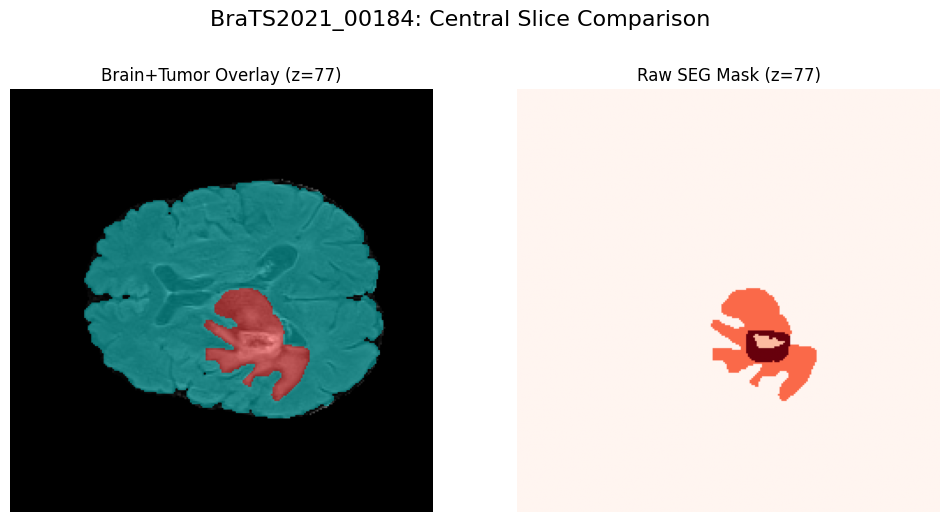


Processing BraTS2021_00185...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00185/BraTS2021_00185_brain_tumor_mask.nii.gz


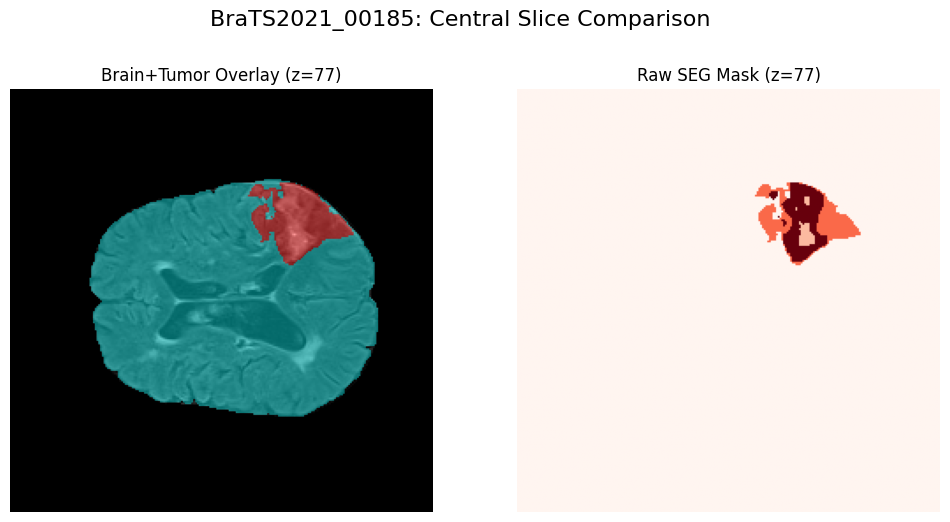


Processing BraTS2021_00186...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00186/BraTS2021_00186_brain_tumor_mask.nii.gz


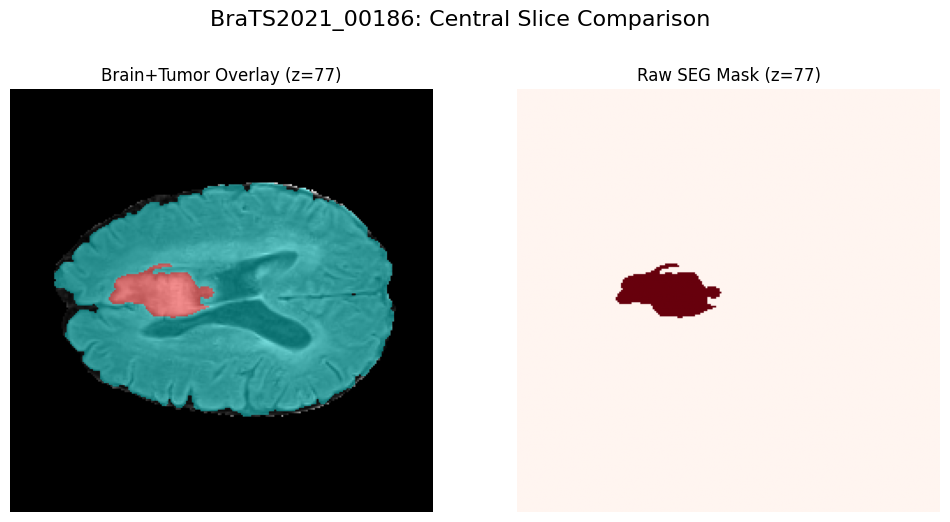


Processing BraTS2021_00187...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00187/BraTS2021_00187_brain_tumor_mask.nii.gz


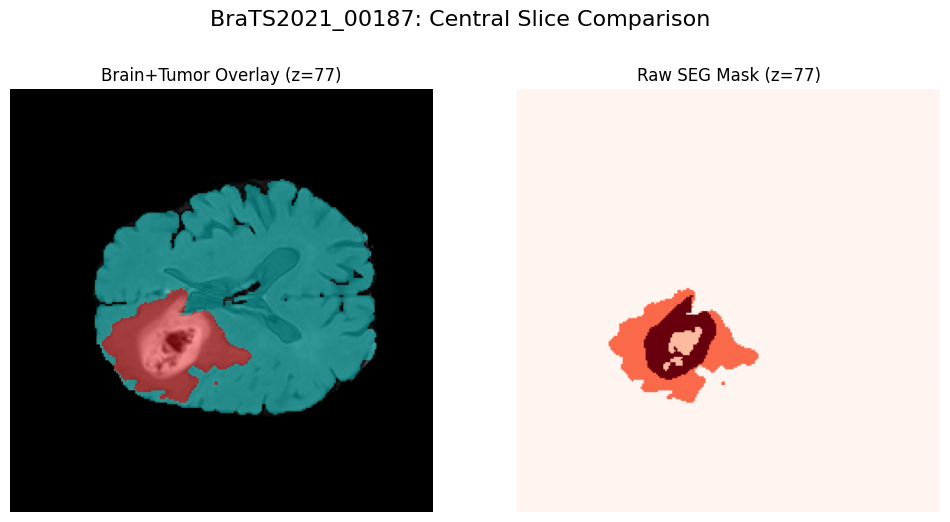


Processing BraTS2021_00188...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00188/BraTS2021_00188_brain_tumor_mask.nii.gz


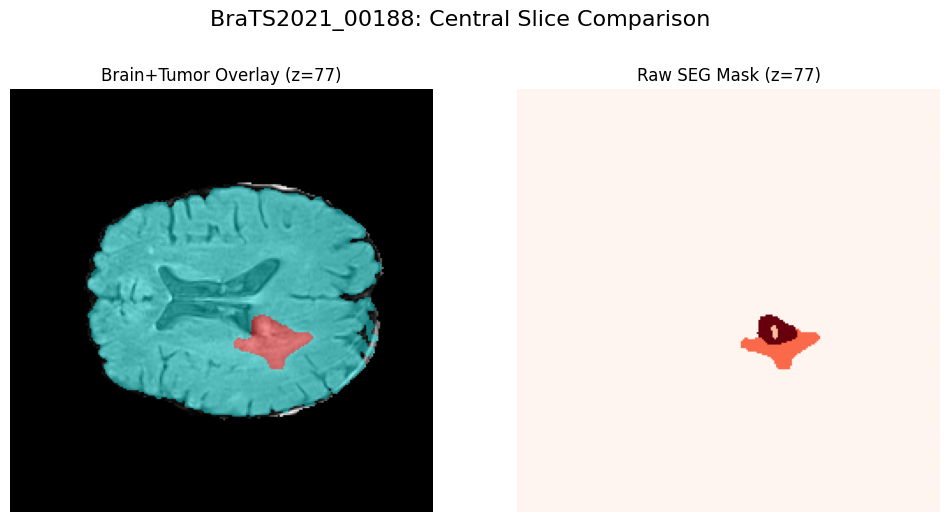


Processing BraTS2021_00191...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00191/BraTS2021_00191_brain_tumor_mask.nii.gz


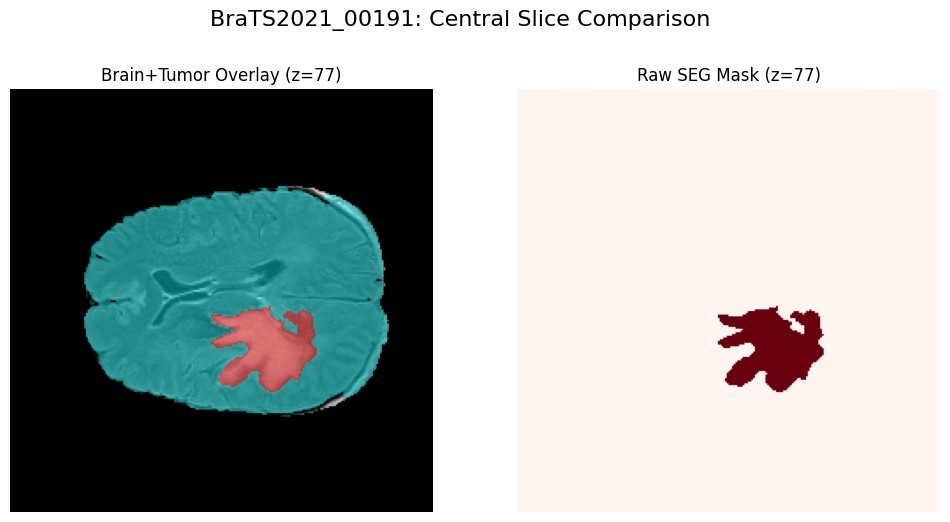


Processing BraTS2021_00192...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00192/BraTS2021_00192_brain_tumor_mask.nii.gz


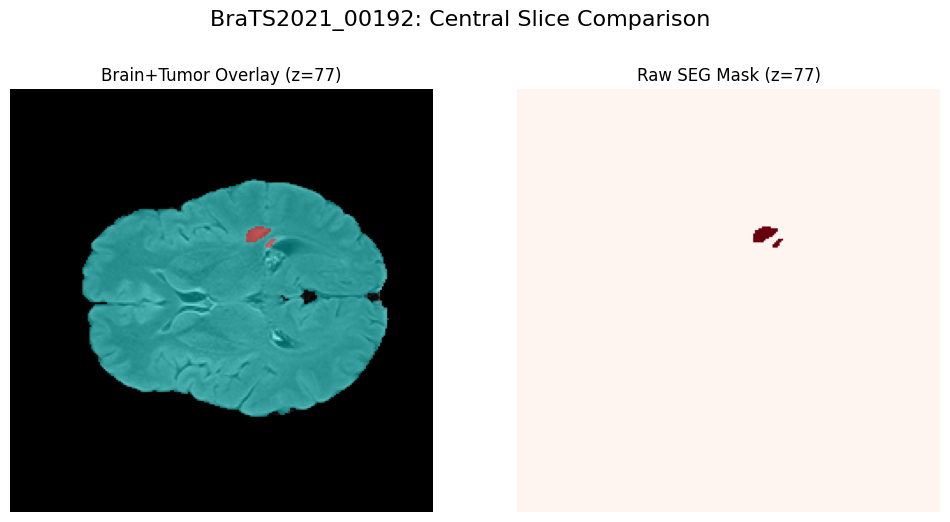


Processing BraTS2021_00193...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00193/BraTS2021_00193_brain_tumor_mask.nii.gz


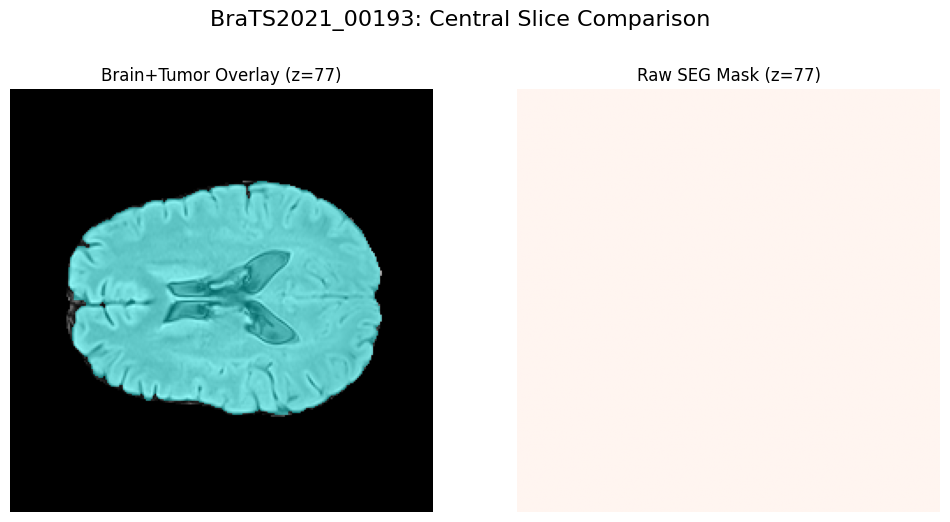


Processing BraTS2021_00194...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00194/BraTS2021_00194_brain_tumor_mask.nii.gz


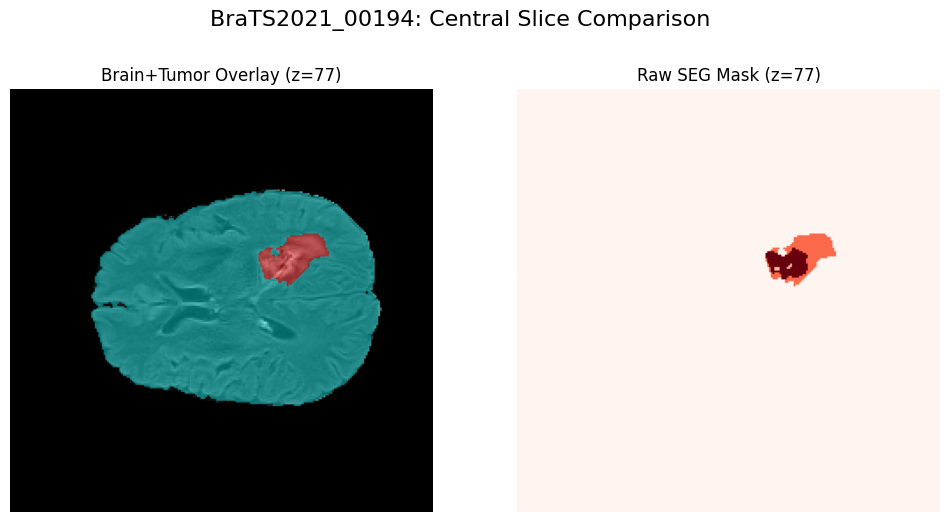


Processing BraTS2021_00195...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00195/BraTS2021_00195_brain_tumor_mask.nii.gz


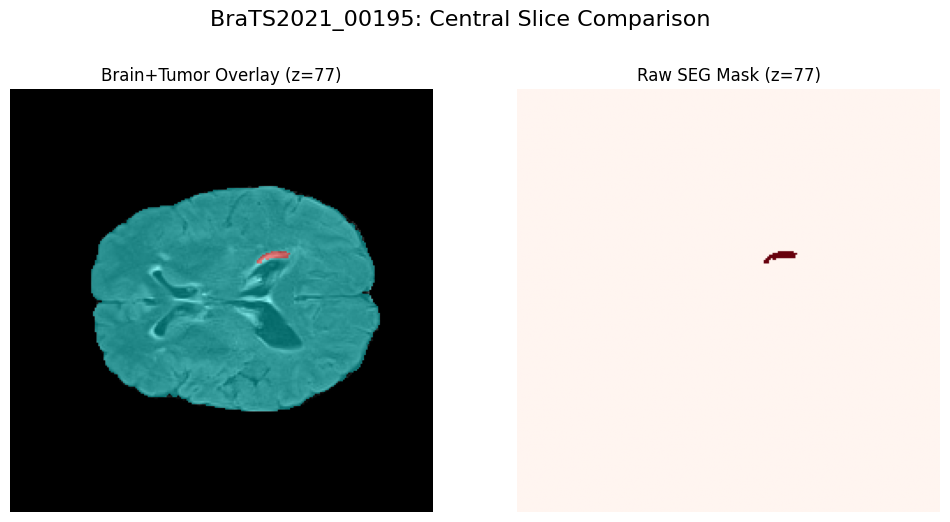


Processing BraTS2021_00196...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00196/BraTS2021_00196_brain_tumor_mask.nii.gz


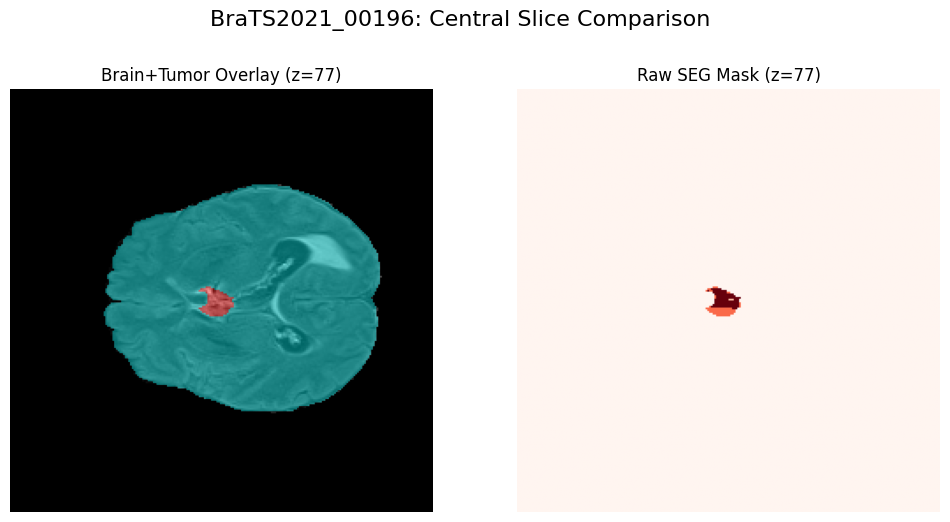


Processing BraTS2021_00199...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00199/BraTS2021_00199_brain_tumor_mask.nii.gz


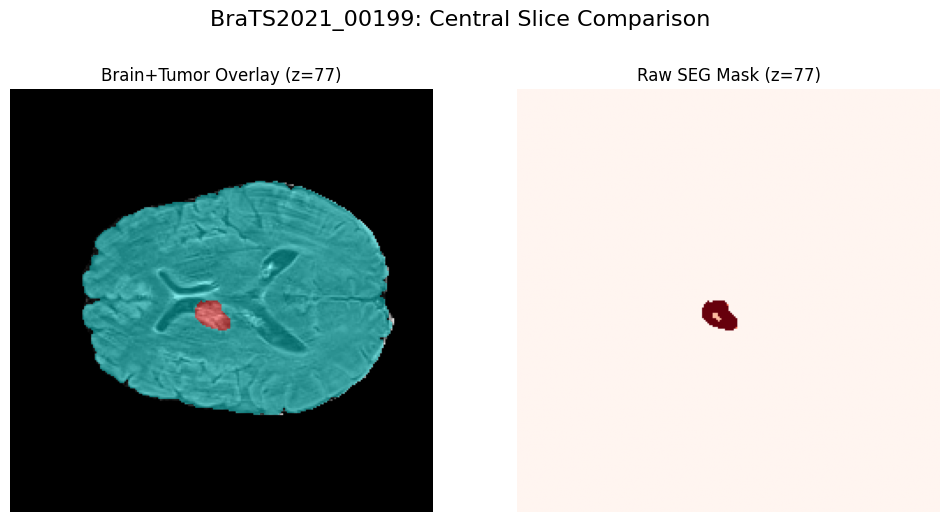


Processing BraTS2021_00201...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00201/BraTS2021_00201_brain_tumor_mask.nii.gz


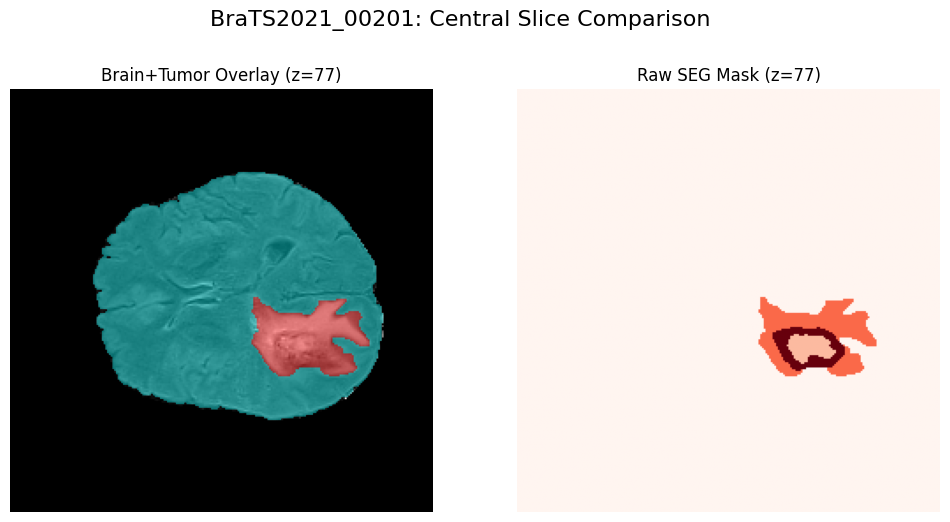


Processing BraTS2021_00203...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00203/BraTS2021_00203_brain_tumor_mask.nii.gz


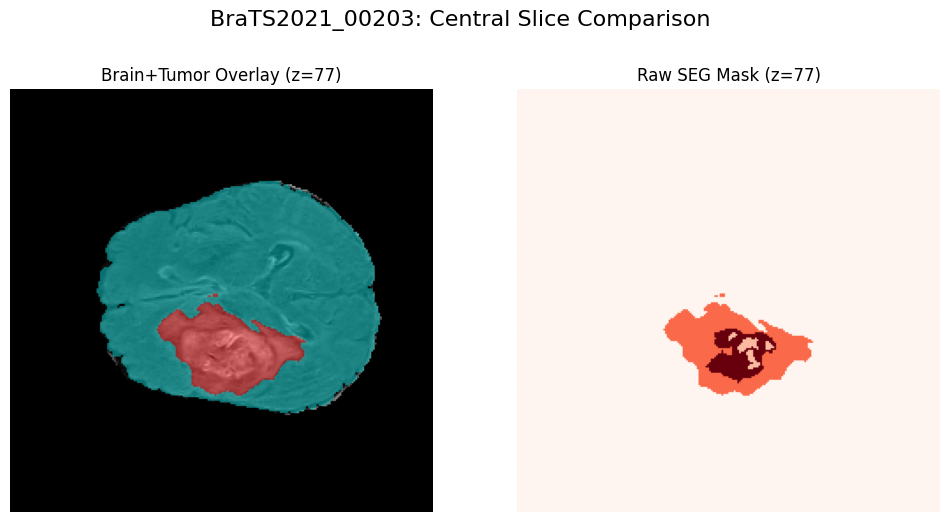


Processing BraTS2021_00204...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00204/BraTS2021_00204_brain_tumor_mask.nii.gz


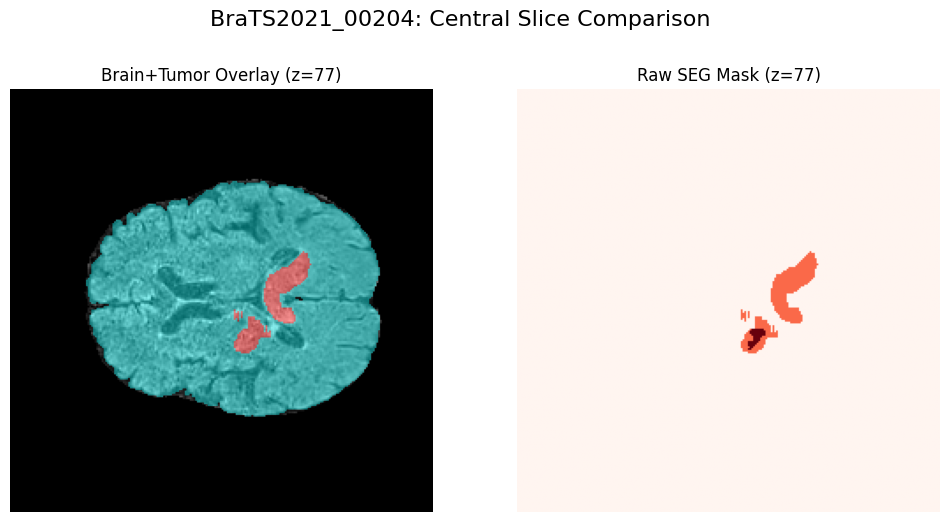


Processing BraTS2021_00206...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00206/BraTS2021_00206_brain_tumor_mask.nii.gz


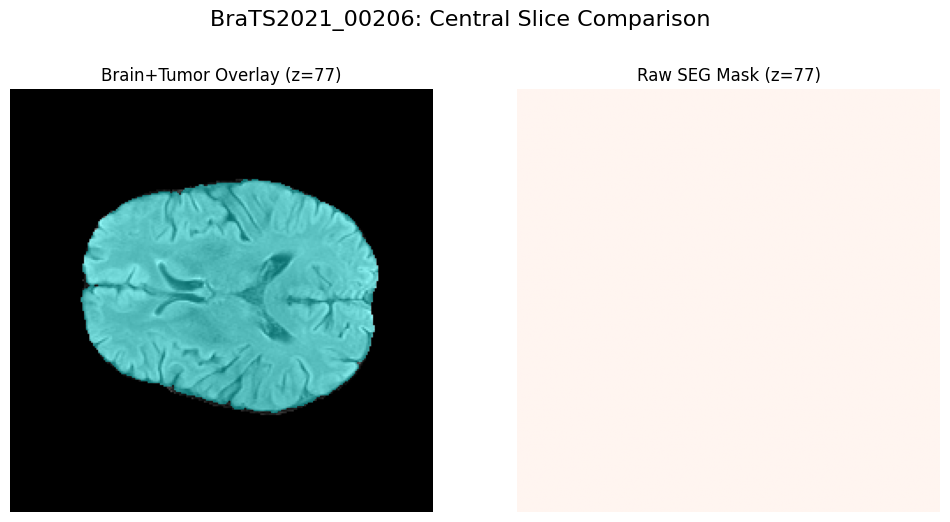


Processing BraTS2021_00207...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00207/BraTS2021_00207_brain_tumor_mask.nii.gz


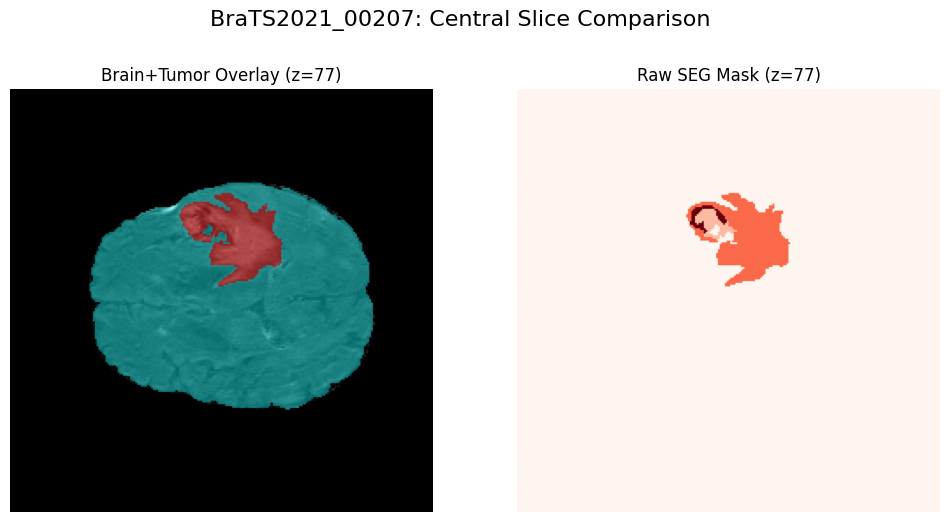


Processing BraTS2021_00209...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00209/BraTS2021_00209_brain_tumor_mask.nii.gz


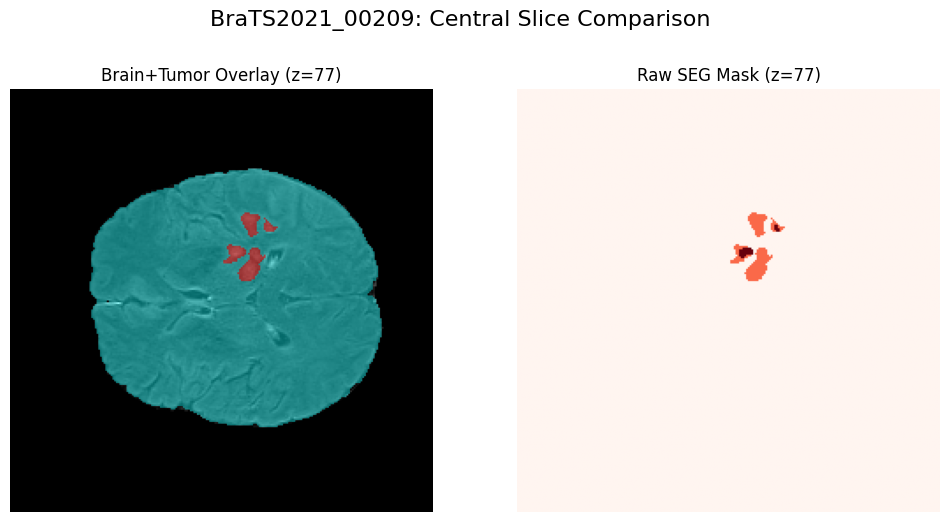


Processing BraTS2021_00210...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00210/BraTS2021_00210_brain_tumor_mask.nii.gz


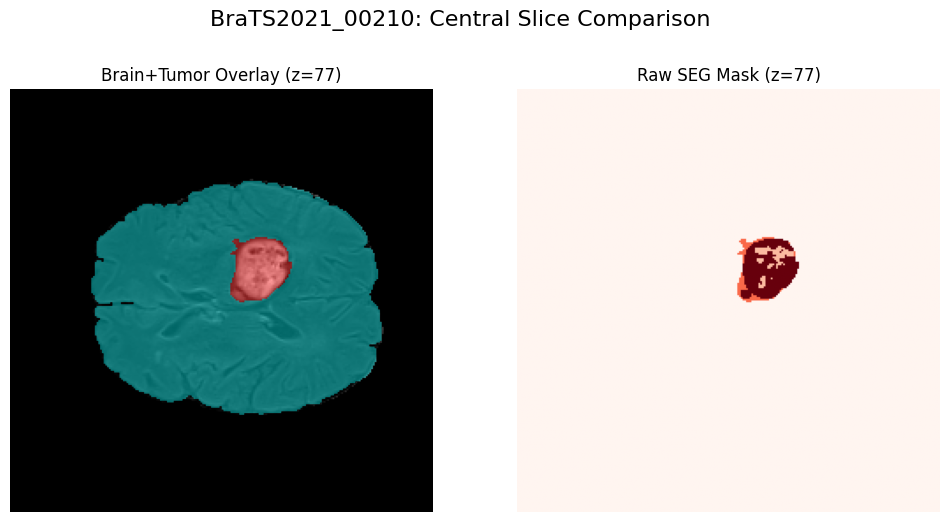


Processing BraTS2021_00211...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00211/BraTS2021_00211_brain_tumor_mask.nii.gz


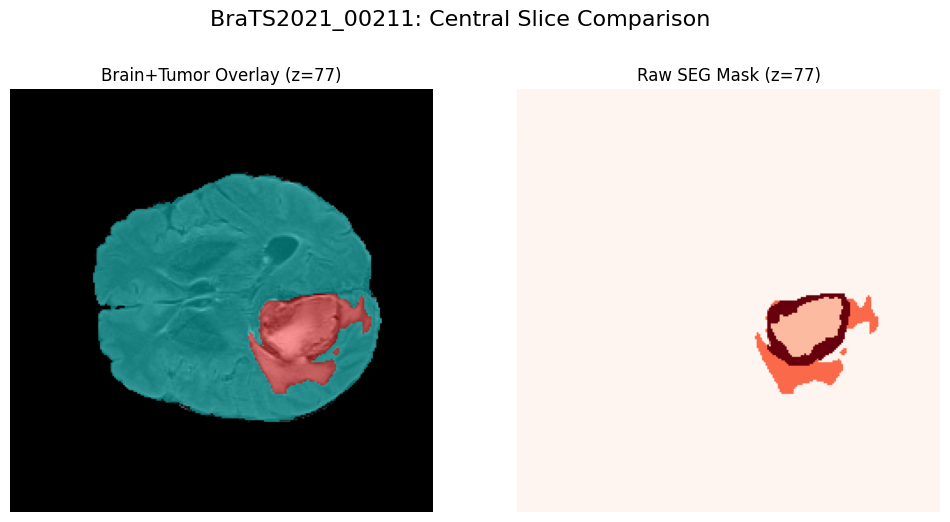


Processing BraTS2021_00212...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00212/BraTS2021_00212_brain_tumor_mask.nii.gz


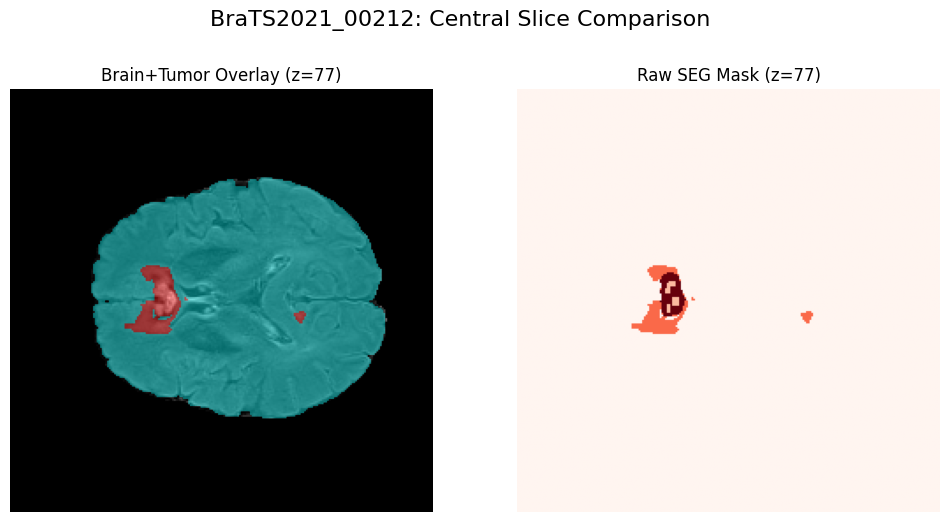


Processing BraTS2021_00214...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00214/BraTS2021_00214_brain_tumor_mask.nii.gz


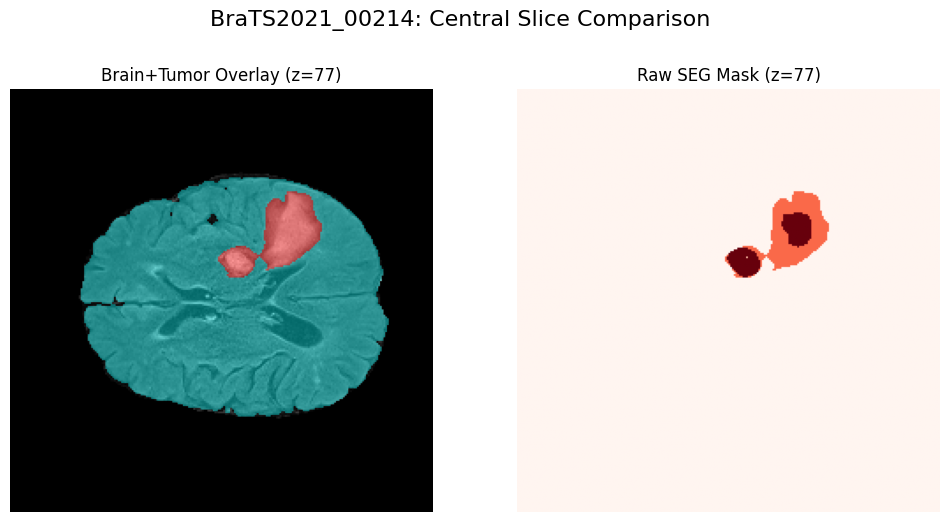


Processing BraTS2021_00216...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00216/BraTS2021_00216_brain_tumor_mask.nii.gz


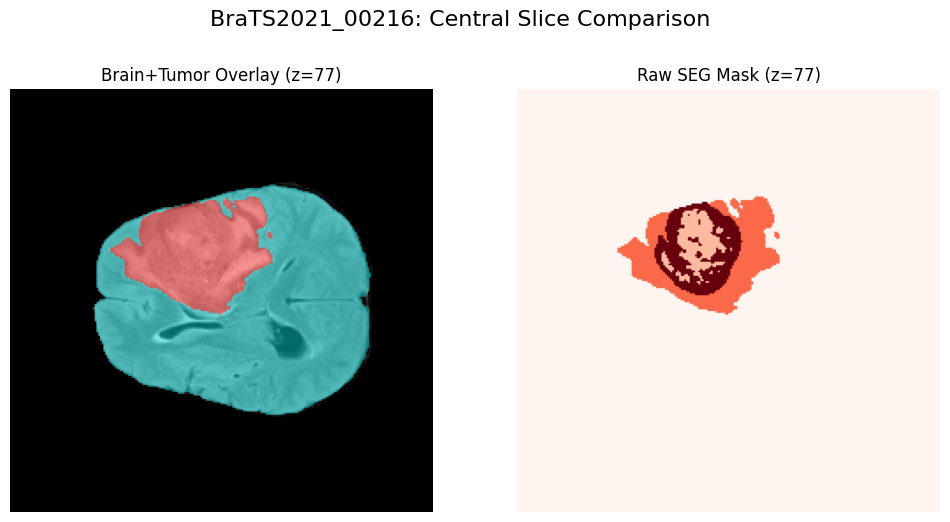


Processing BraTS2021_00217...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00217/BraTS2021_00217_brain_tumor_mask.nii.gz


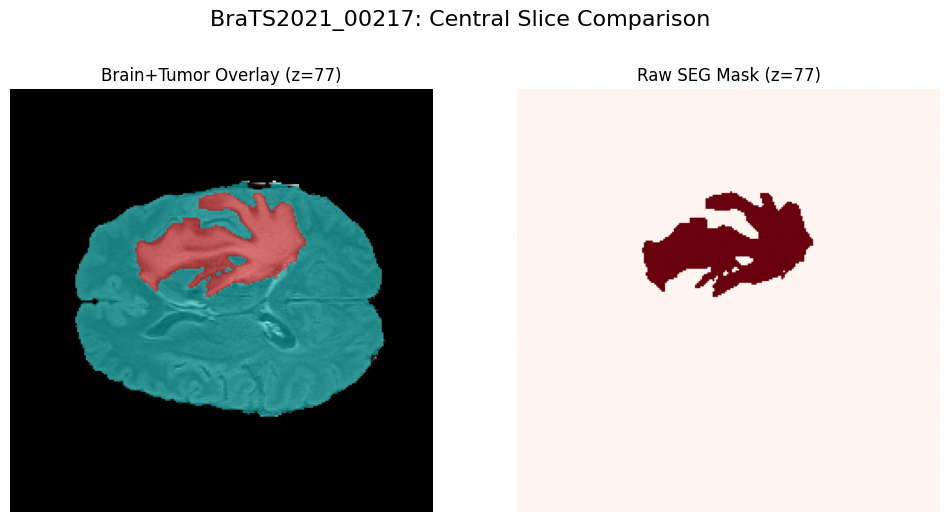


Processing BraTS2021_00218...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00218/BraTS2021_00218_brain_tumor_mask.nii.gz


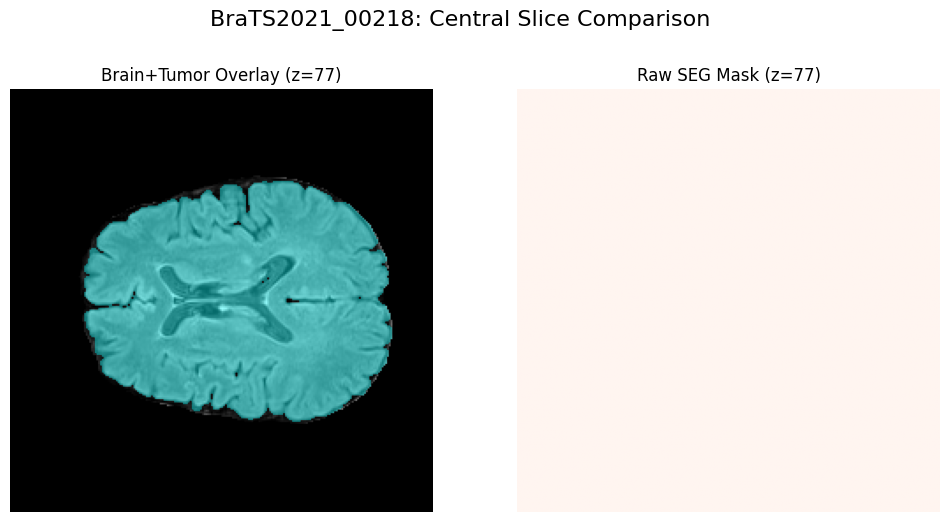


Processing BraTS2021_00219...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00219/BraTS2021_00219_brain_tumor_mask.nii.gz


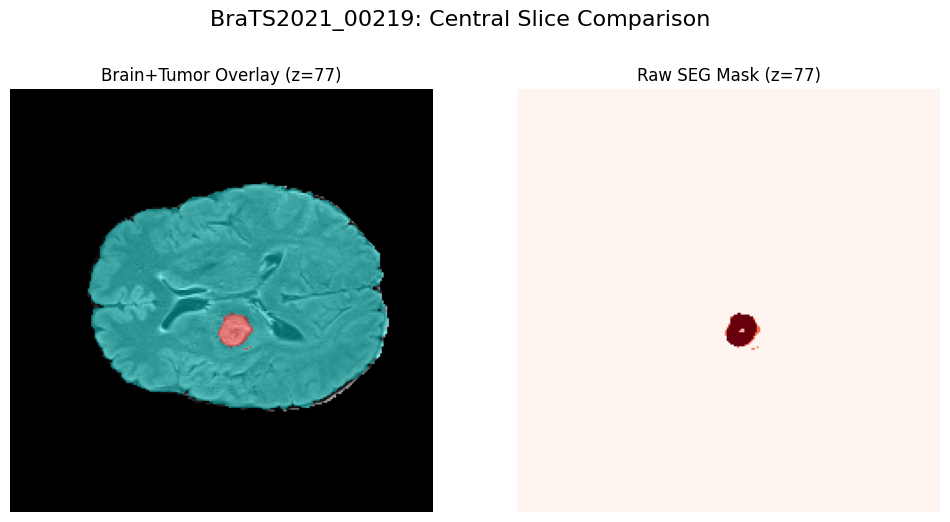


Processing BraTS2021_00220...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00220/BraTS2021_00220_brain_tumor_mask.nii.gz


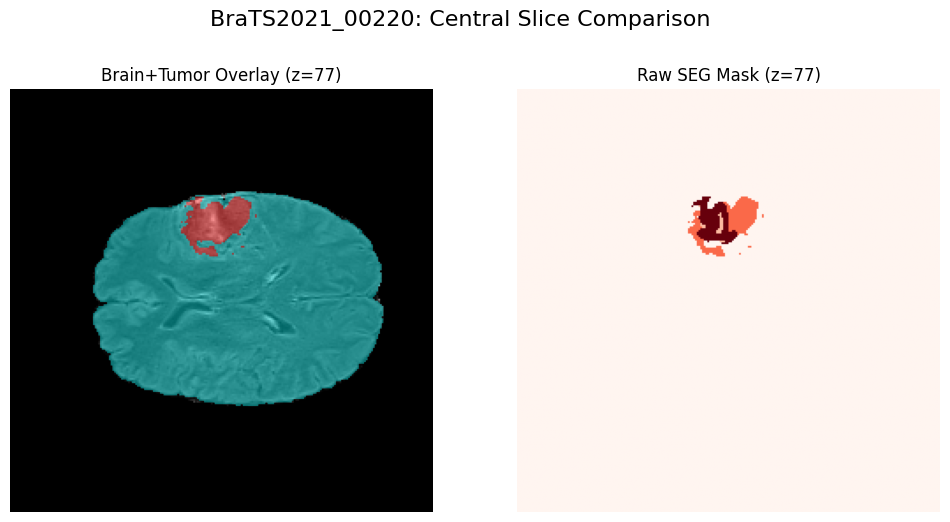


Processing BraTS2021_00221...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00221/BraTS2021_00221_brain_tumor_mask.nii.gz


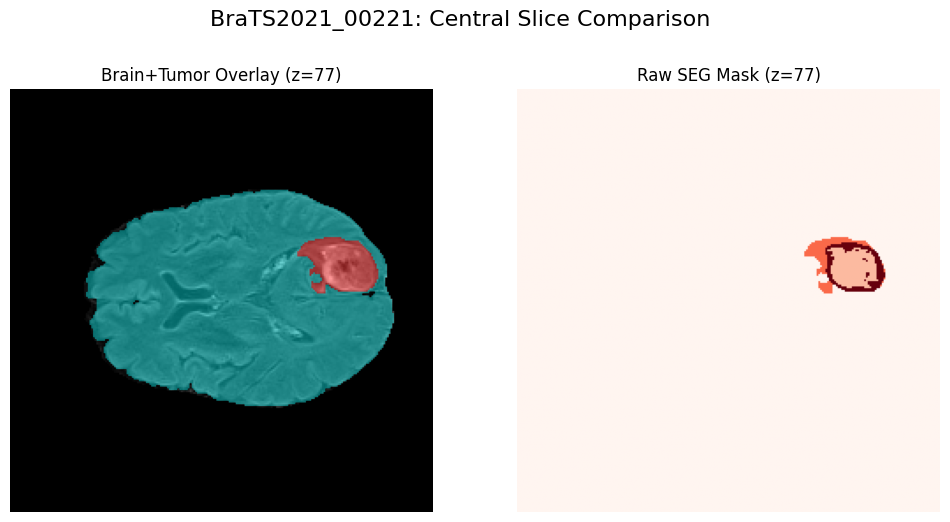


Processing BraTS2021_00222...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00222/BraTS2021_00222_brain_tumor_mask.nii.gz


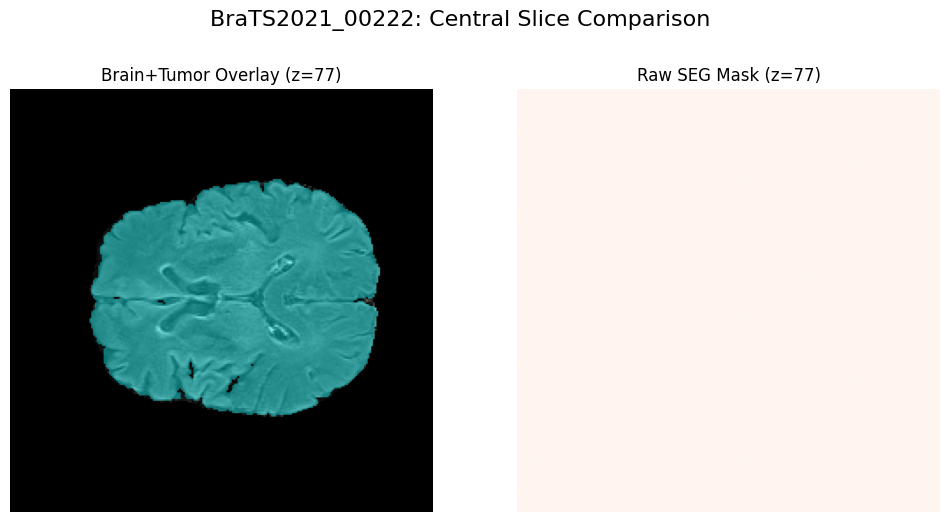


Processing BraTS2021_00227...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00227/BraTS2021_00227_brain_tumor_mask.nii.gz


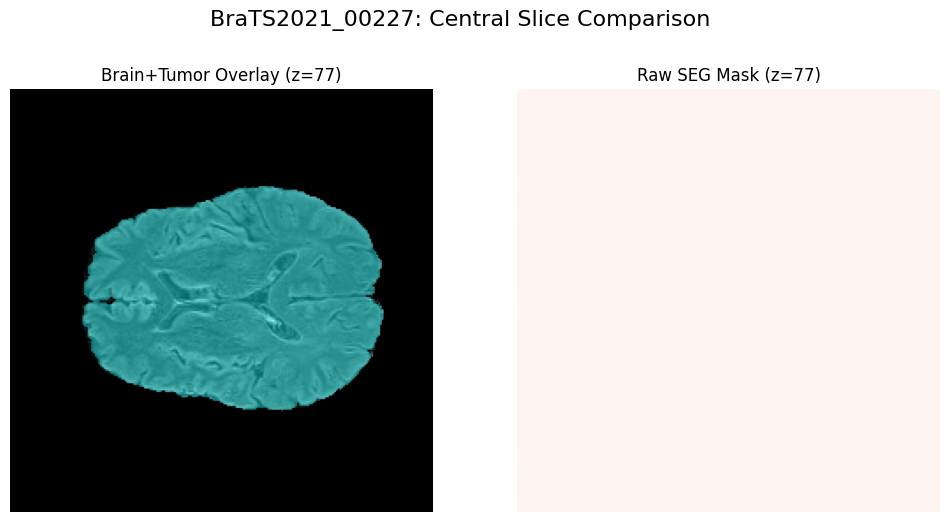


Processing BraTS2021_00228...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00228/BraTS2021_00228_brain_tumor_mask.nii.gz


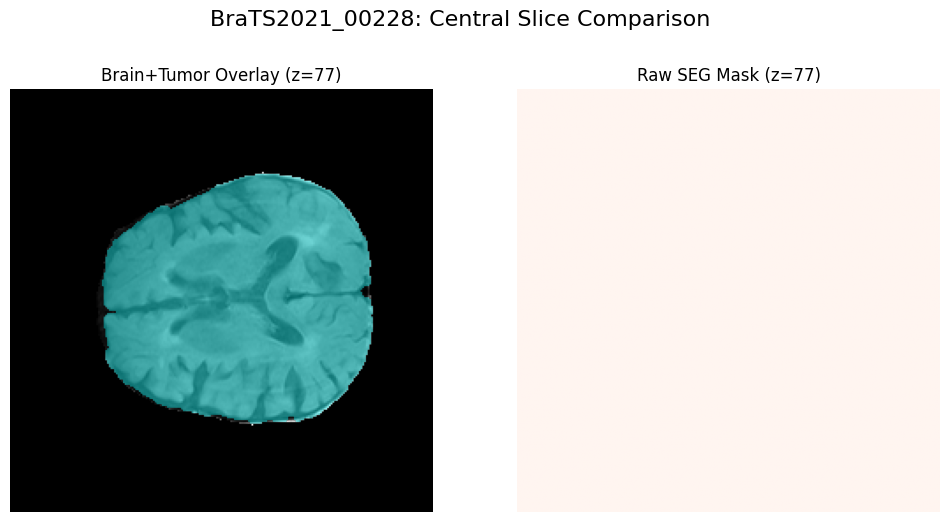


Processing BraTS2021_00230...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00230/BraTS2021_00230_brain_tumor_mask.nii.gz


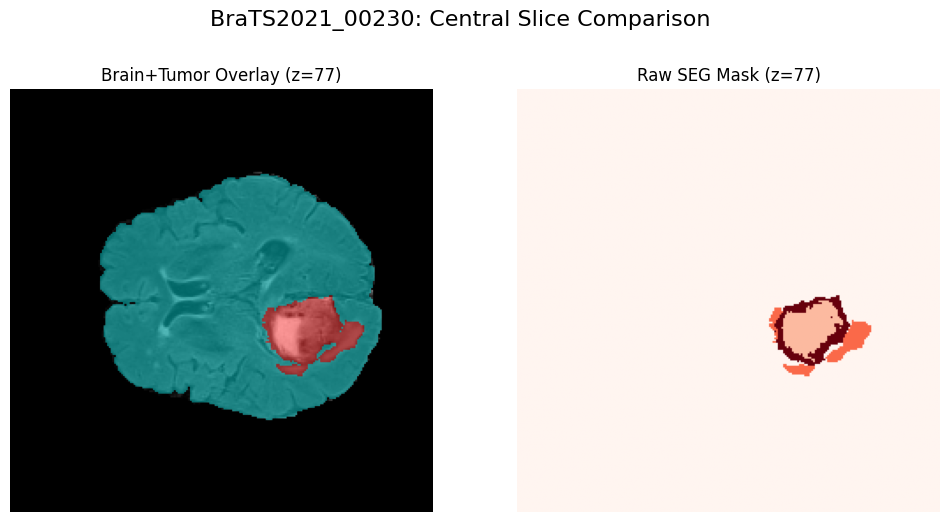


Processing BraTS2021_00231...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00231/BraTS2021_00231_brain_tumor_mask.nii.gz


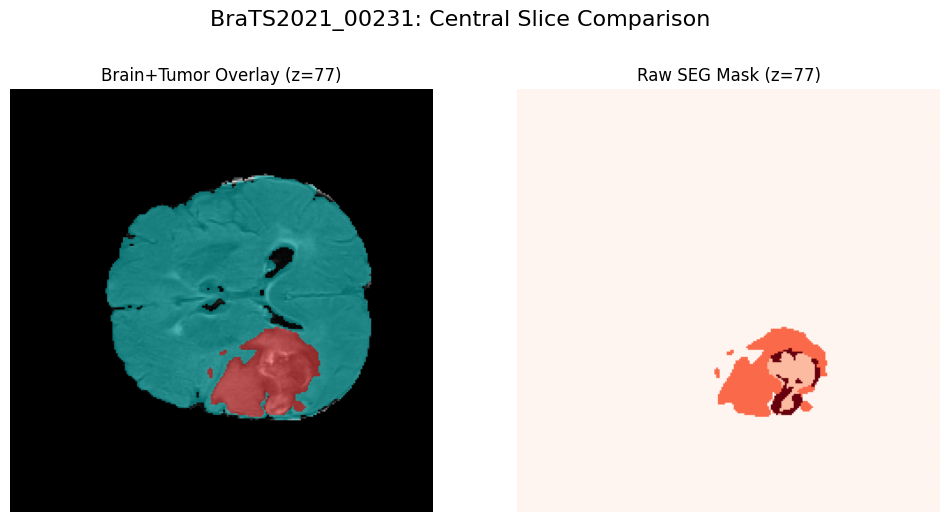


Processing BraTS2021_00233...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00233/BraTS2021_00233_brain_tumor_mask.nii.gz


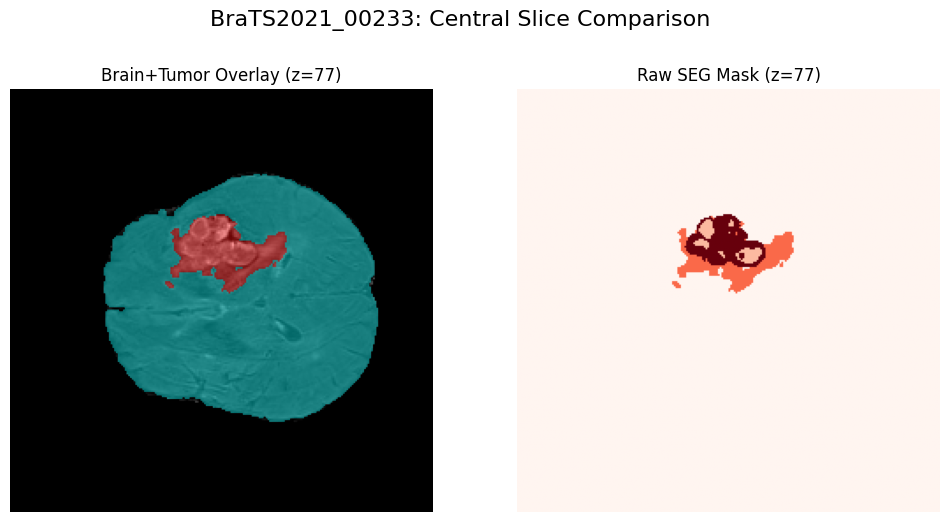


Processing BraTS2021_00234...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00234/BraTS2021_00234_brain_tumor_mask.nii.gz


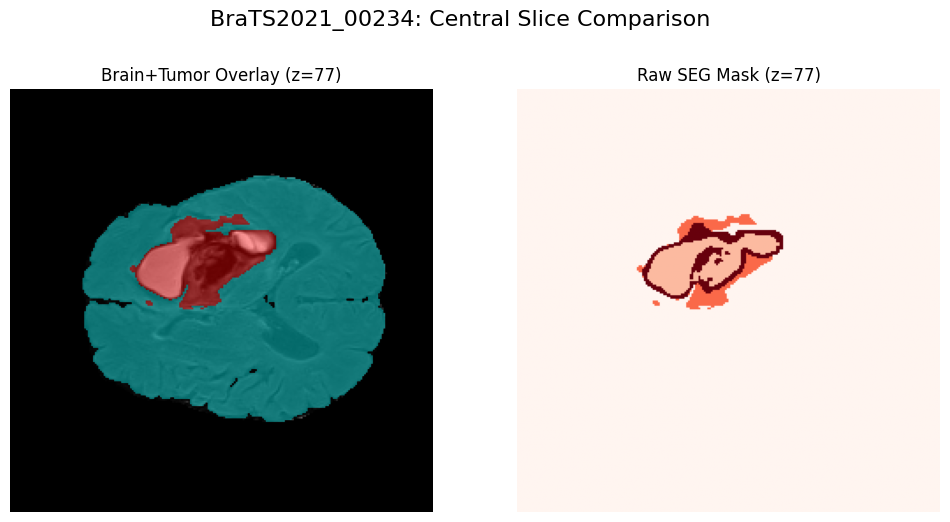


Processing BraTS2021_00235...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00235/BraTS2021_00235_brain_tumor_mask.nii.gz


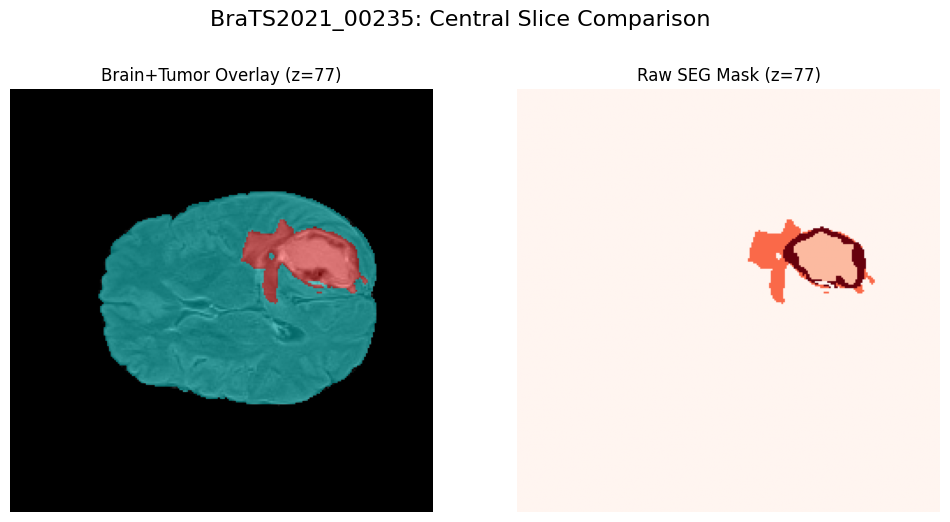


Processing BraTS2021_00236...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00236/BraTS2021_00236_brain_tumor_mask.nii.gz


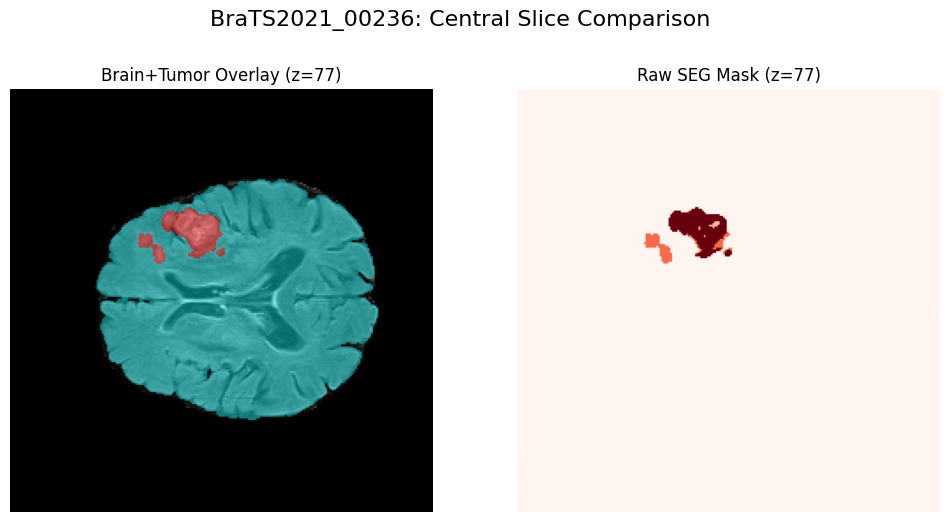


Processing BraTS2021_00237...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00237/BraTS2021_00237_brain_tumor_mask.nii.gz


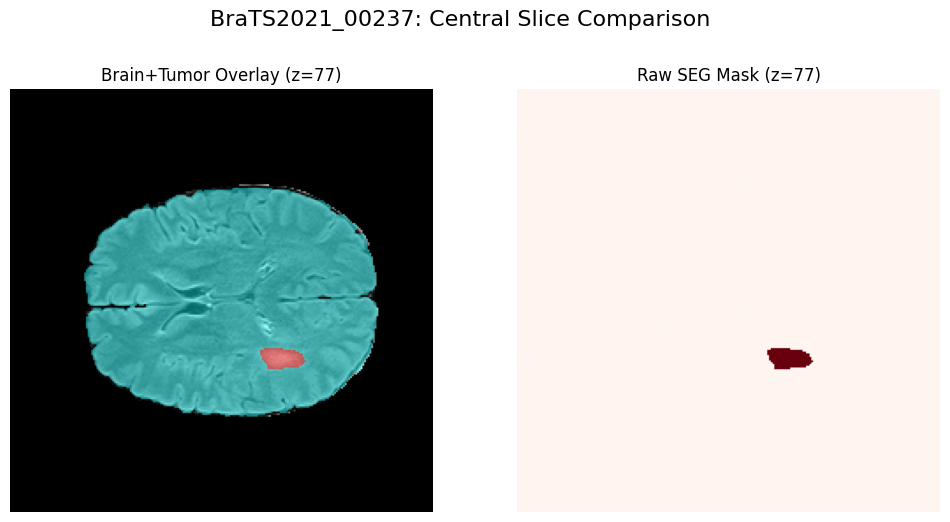


Processing BraTS2021_00238...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00238/BraTS2021_00238_brain_tumor_mask.nii.gz


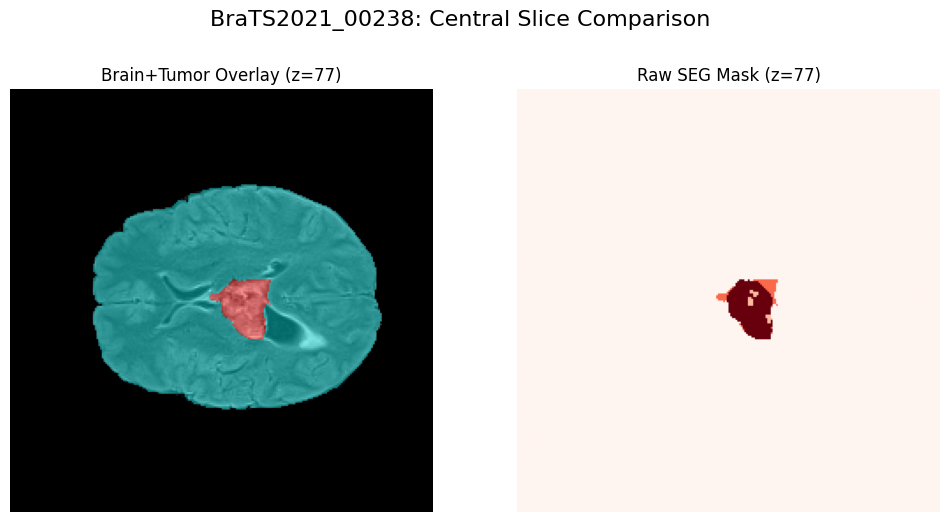


Processing BraTS2021_00239...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00239/BraTS2021_00239_brain_tumor_mask.nii.gz


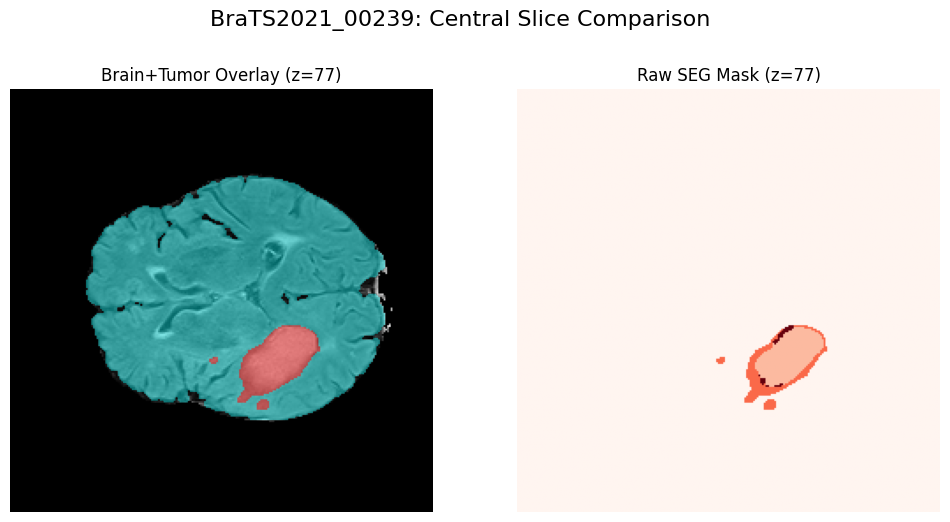


Processing BraTS2021_00240...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00240/BraTS2021_00240_brain_tumor_mask.nii.gz


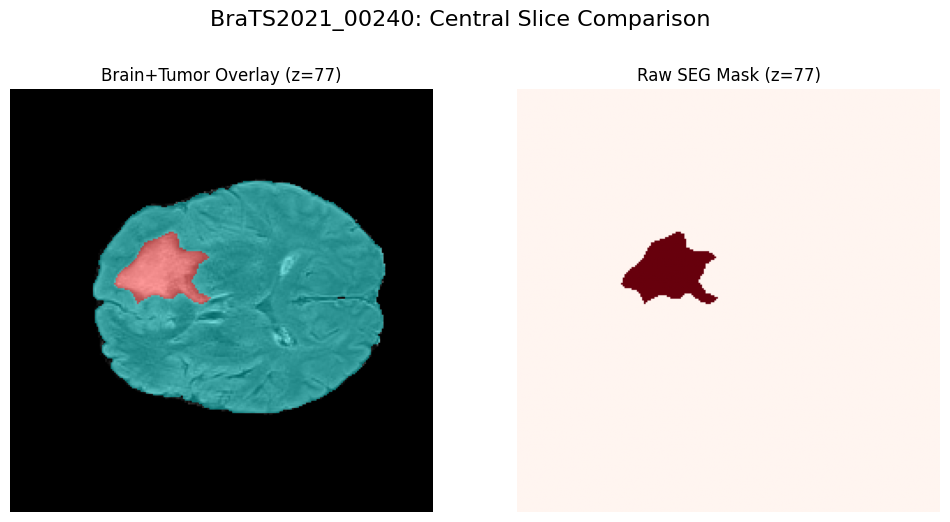


Processing BraTS2021_00241...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00241/BraTS2021_00241_brain_tumor_mask.nii.gz


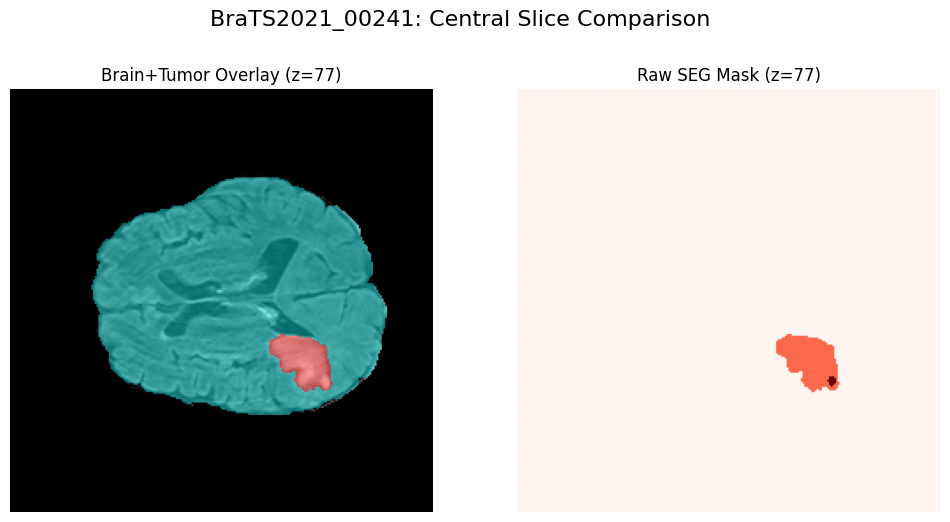


Processing BraTS2021_00242...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00242/BraTS2021_00242_brain_tumor_mask.nii.gz


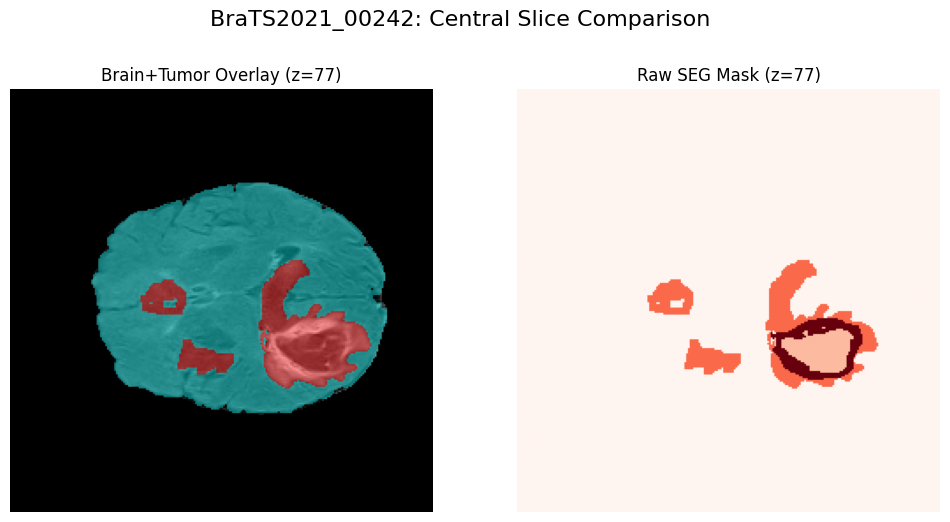


Processing BraTS2021_00243...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00243/BraTS2021_00243_brain_tumor_mask.nii.gz


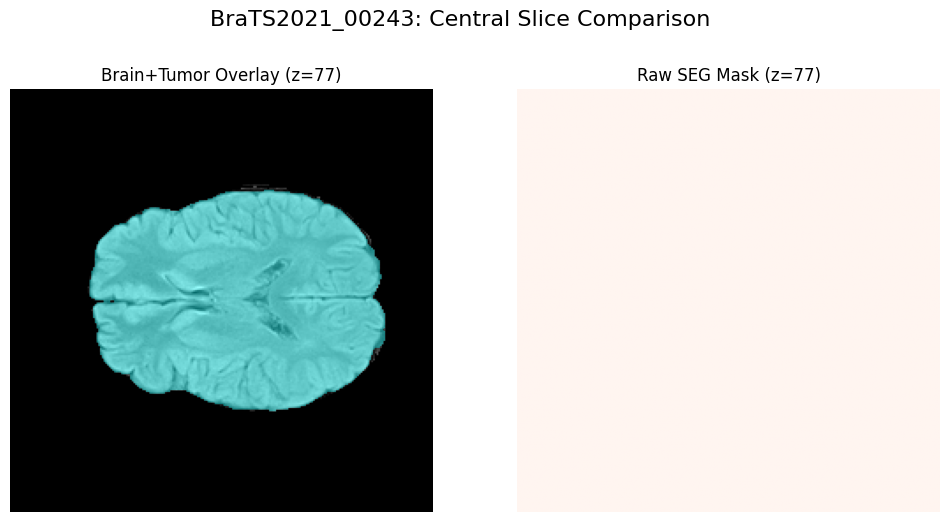


Processing BraTS2021_00246...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00246/BraTS2021_00246_brain_tumor_mask.nii.gz


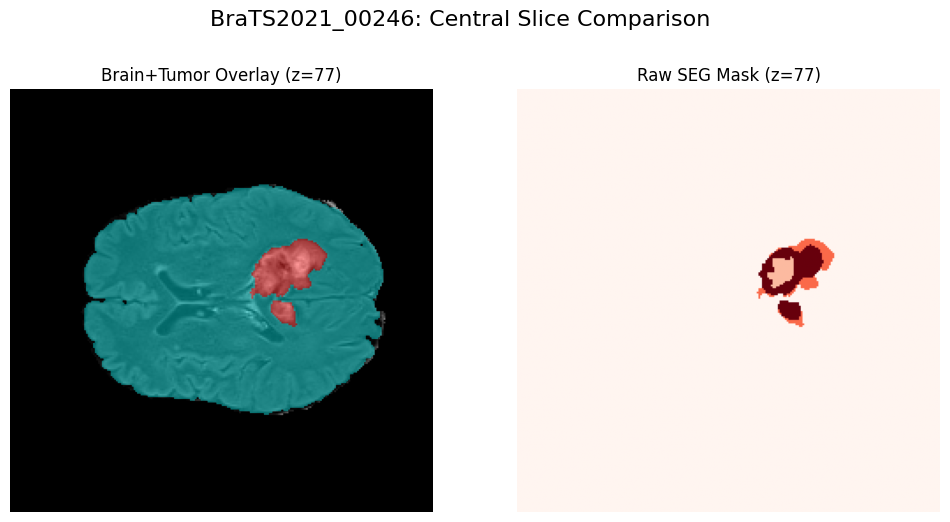


Processing BraTS2021_00247...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00247/BraTS2021_00247_brain_tumor_mask.nii.gz


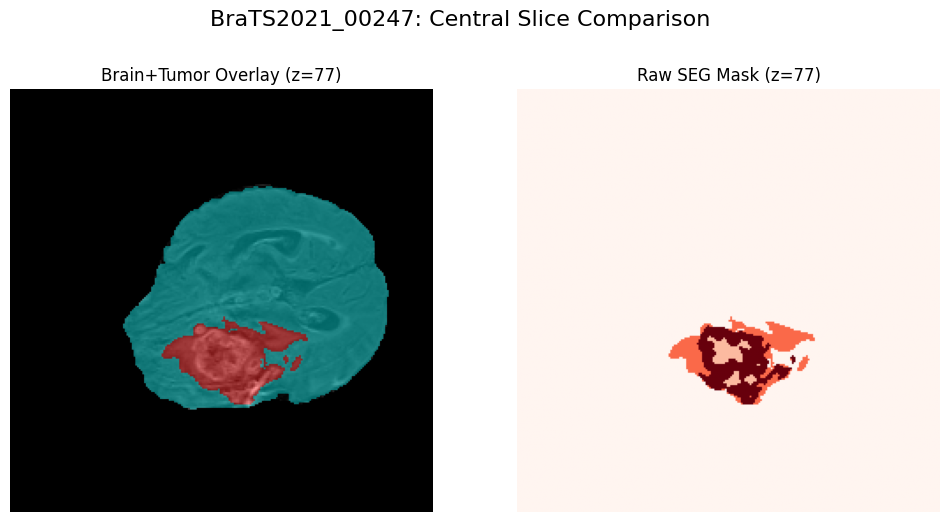


Processing BraTS2021_00249...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00249/BraTS2021_00249_brain_tumor_mask.nii.gz


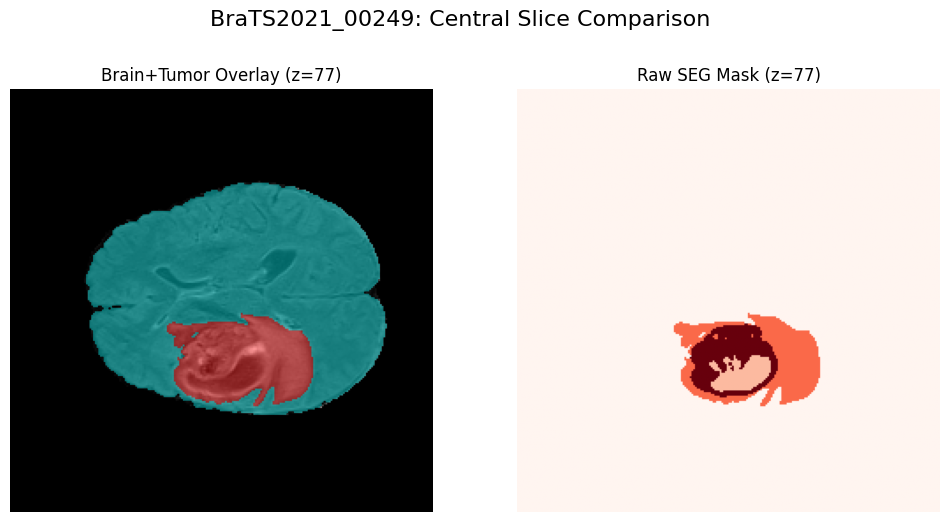


Processing BraTS2021_00250...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00250/BraTS2021_00250_brain_tumor_mask.nii.gz


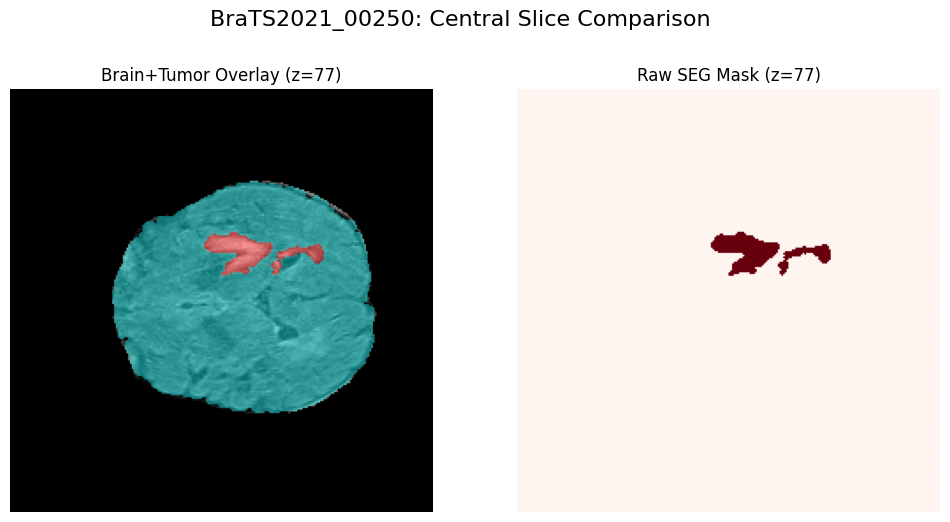


Processing BraTS2021_00251...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00251/BraTS2021_00251_brain_tumor_mask.nii.gz


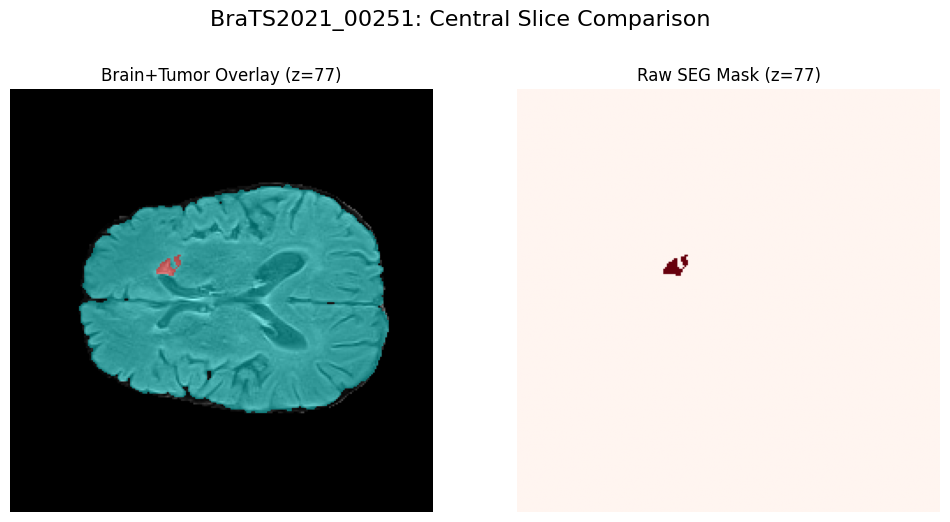


Processing BraTS2021_00253...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00253/BraTS2021_00253_brain_tumor_mask.nii.gz


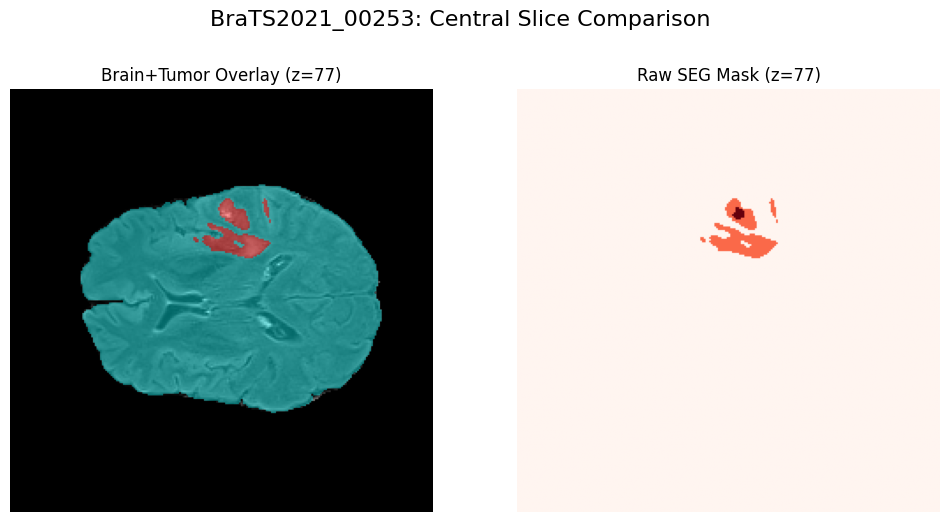


Processing BraTS2021_00254...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00254/BraTS2021_00254_brain_tumor_mask.nii.gz


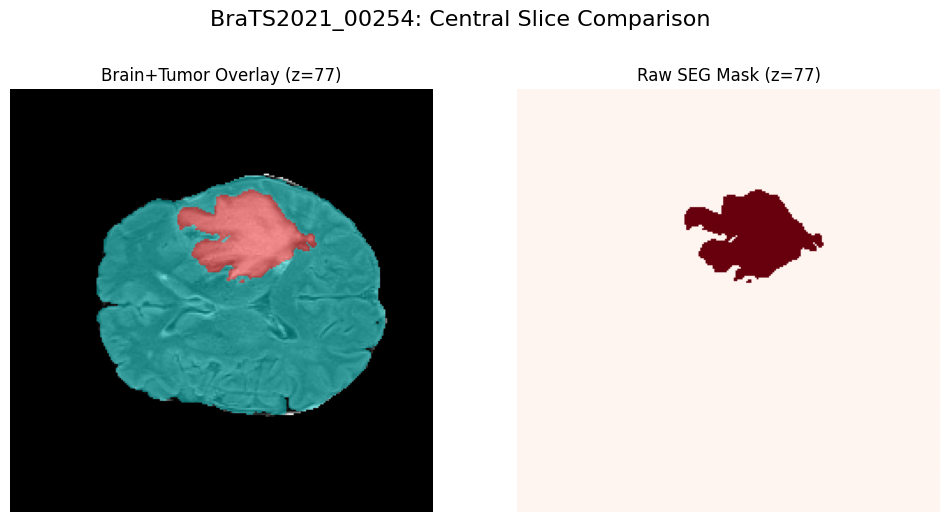


Processing BraTS2021_00258...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00258/BraTS2021_00258_brain_tumor_mask.nii.gz


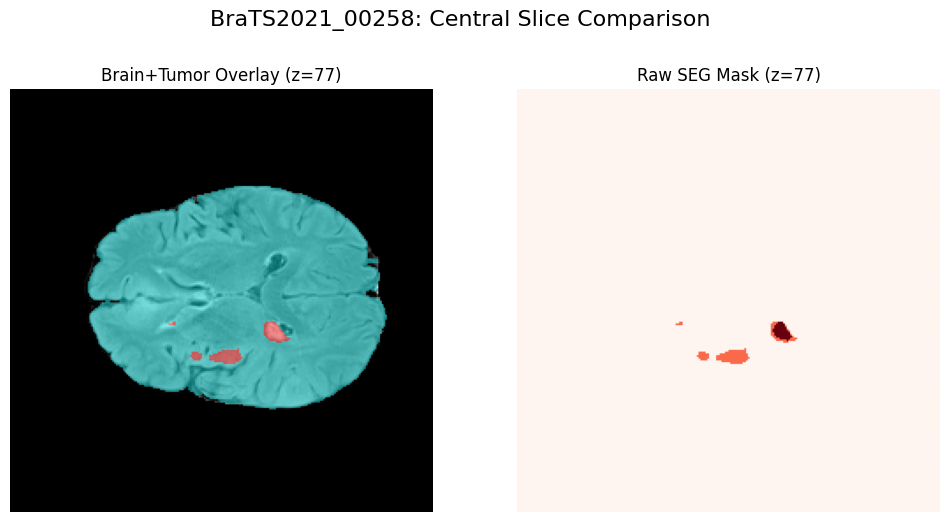


Processing BraTS2021_00259...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00259/BraTS2021_00259_brain_tumor_mask.nii.gz


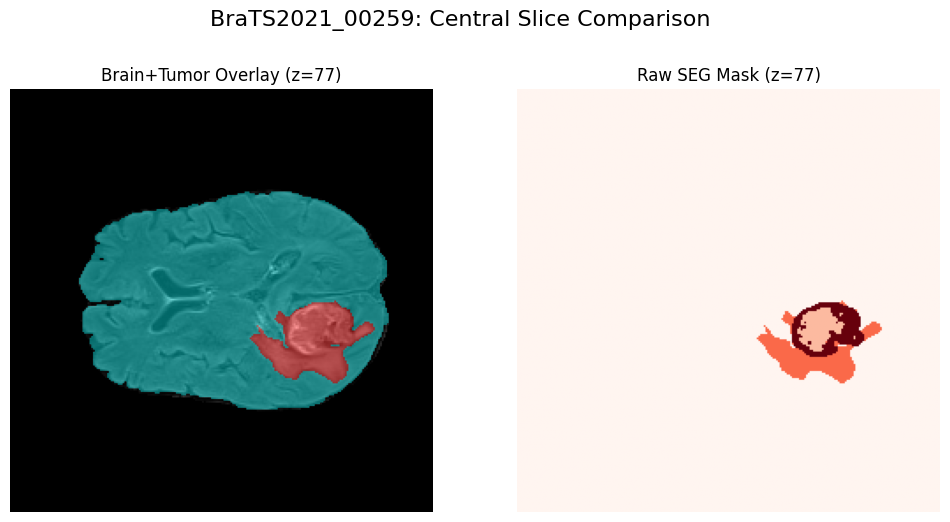


Processing BraTS2021_00260...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00260/BraTS2021_00260_brain_tumor_mask.nii.gz


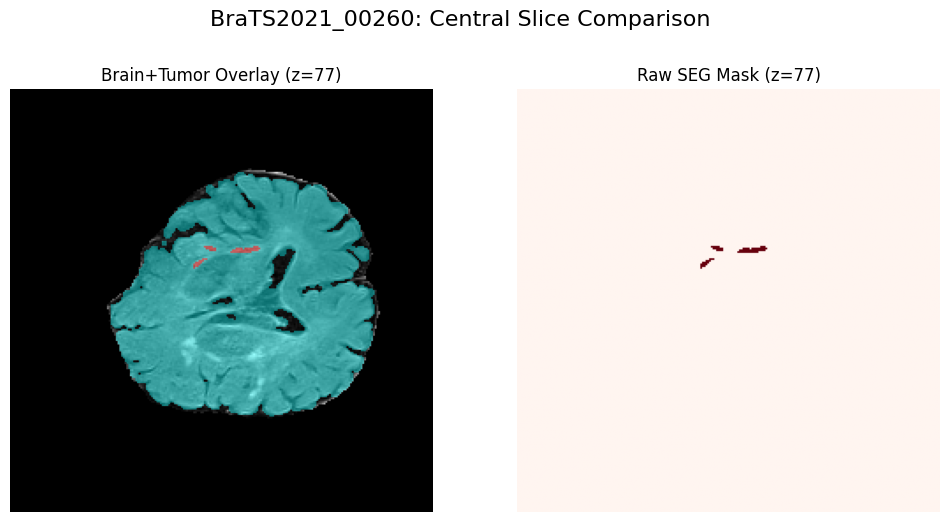


Processing BraTS2021_00261...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00261/BraTS2021_00261_brain_tumor_mask.nii.gz


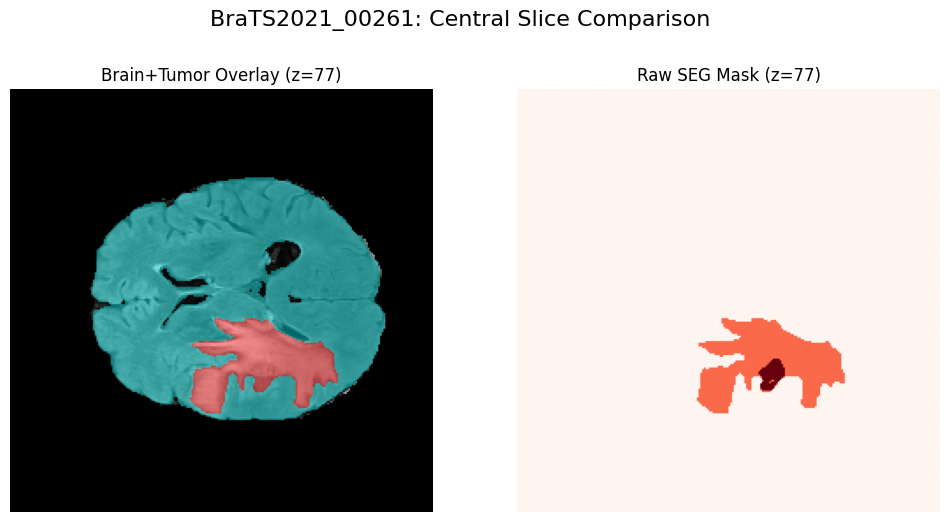


Processing BraTS2021_00262...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00262/BraTS2021_00262_brain_tumor_mask.nii.gz


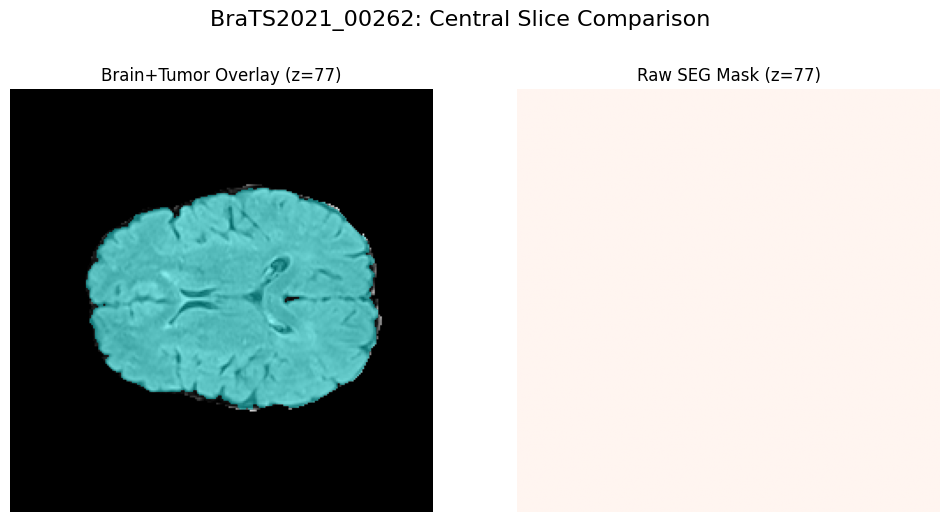


Processing BraTS2021_00263...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00263/BraTS2021_00263_brain_tumor_mask.nii.gz


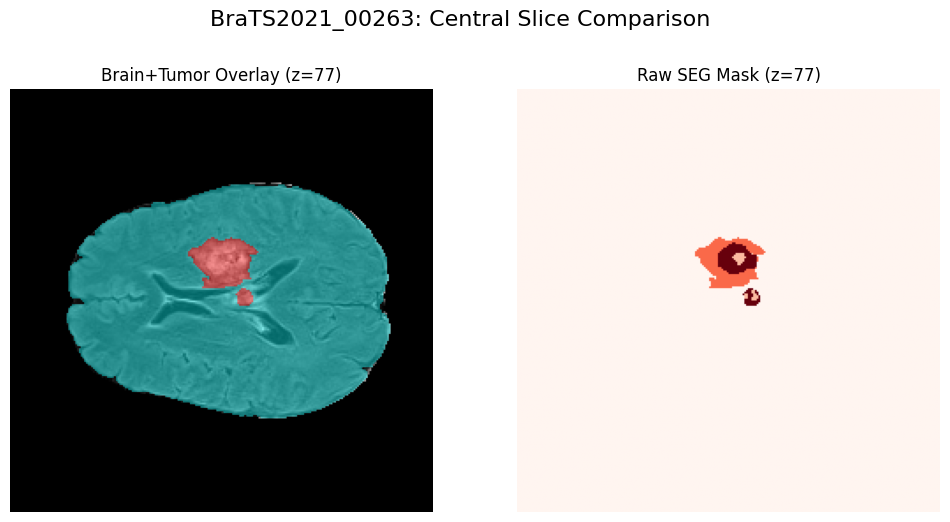


Processing BraTS2021_00266...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00266/BraTS2021_00266_brain_tumor_mask.nii.gz


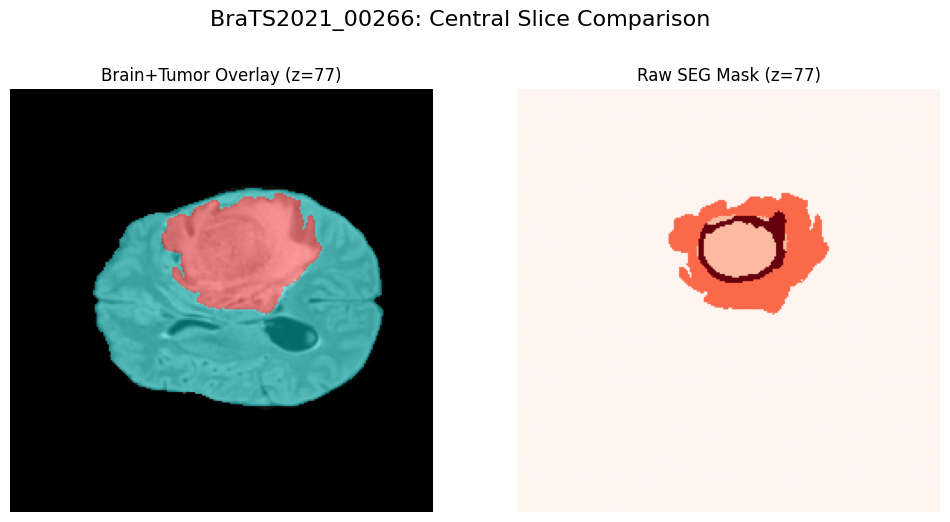


Processing BraTS2021_00267...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00267/BraTS2021_00267_brain_tumor_mask.nii.gz


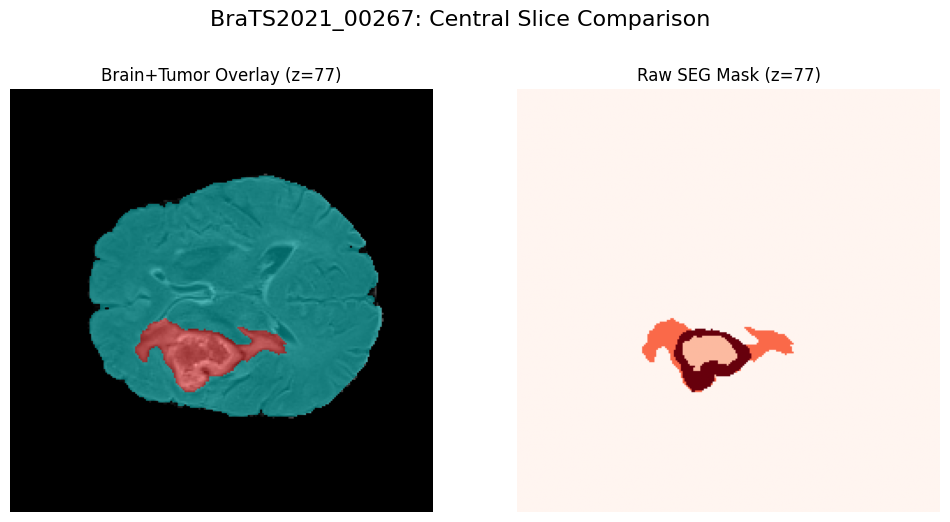


Processing BraTS2021_00269...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00269/BraTS2021_00269_brain_tumor_mask.nii.gz


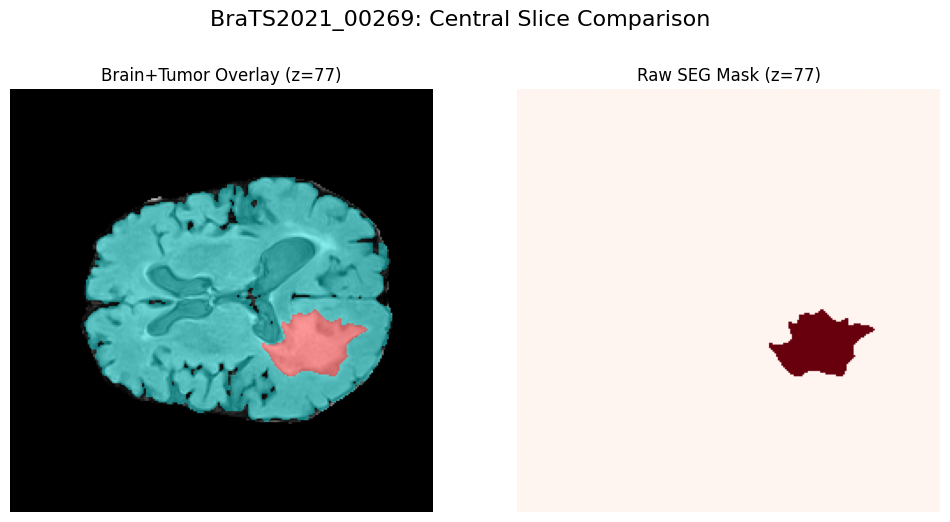


Processing BraTS2021_00270...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00270/BraTS2021_00270_brain_tumor_mask.nii.gz


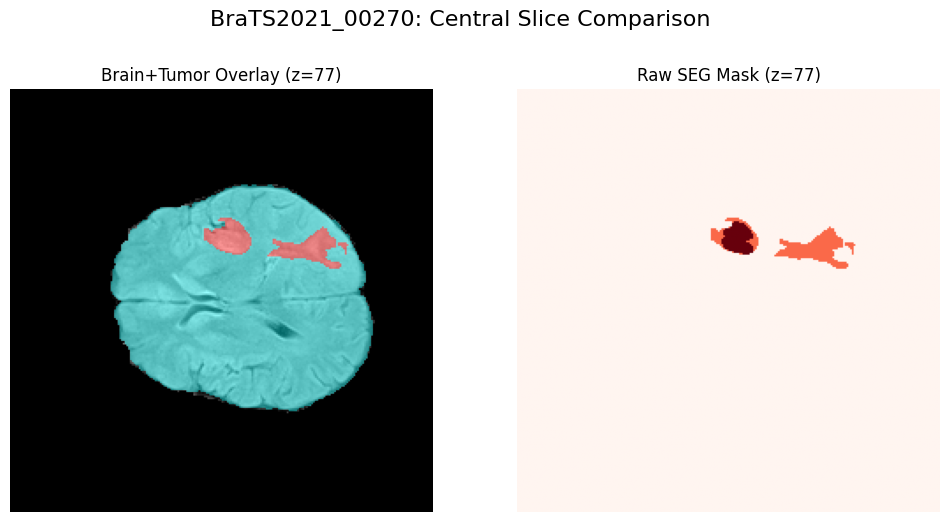


Processing BraTS2021_00271...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00271/BraTS2021_00271_brain_tumor_mask.nii.gz


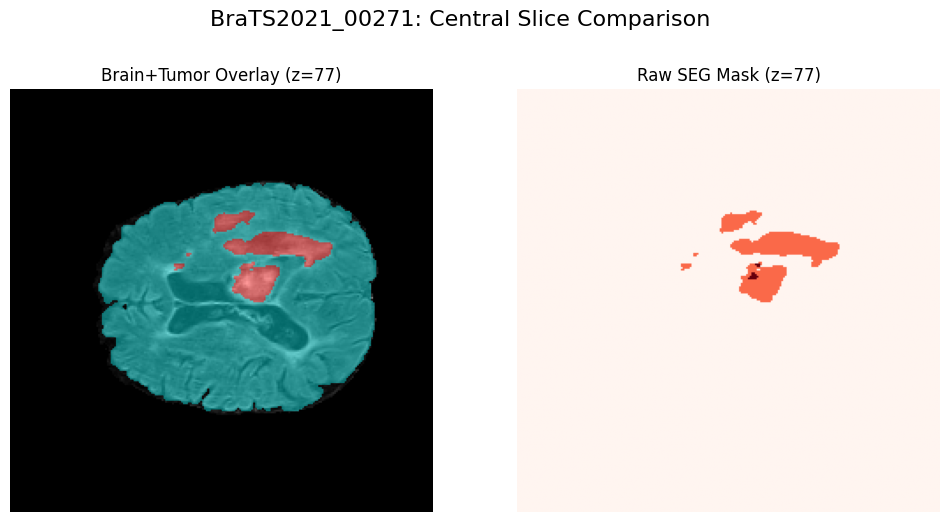


Processing BraTS2021_00273...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00273/BraTS2021_00273_brain_tumor_mask.nii.gz


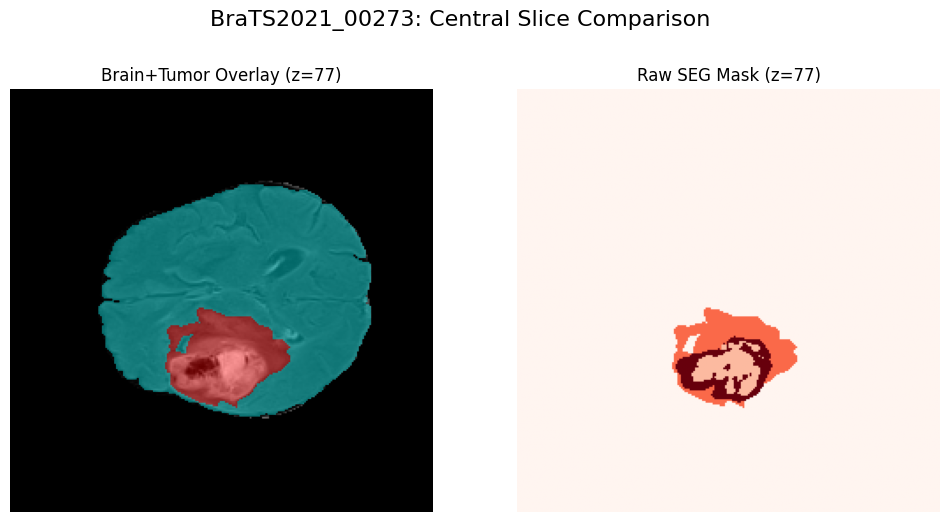


Processing BraTS2021_00274...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00274/BraTS2021_00274_brain_tumor_mask.nii.gz


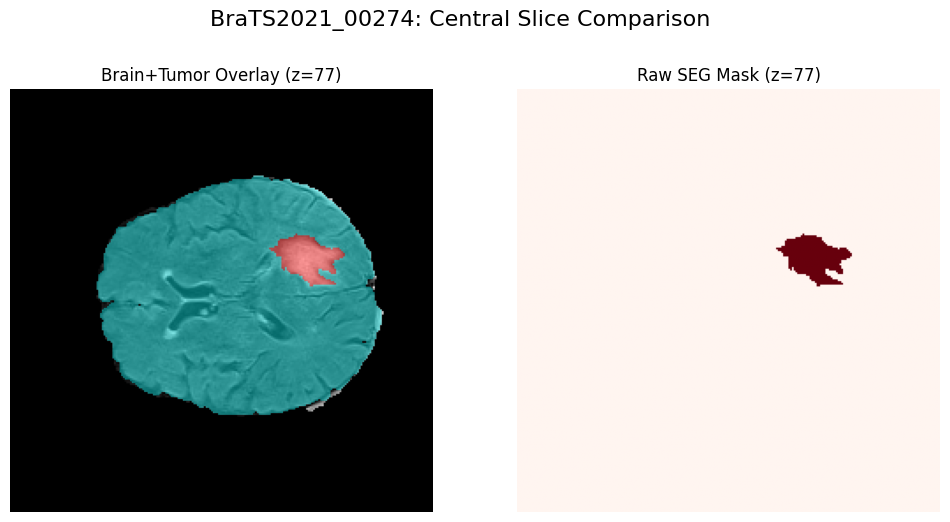


Processing BraTS2021_00275...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00275/BraTS2021_00275_brain_tumor_mask.nii.gz


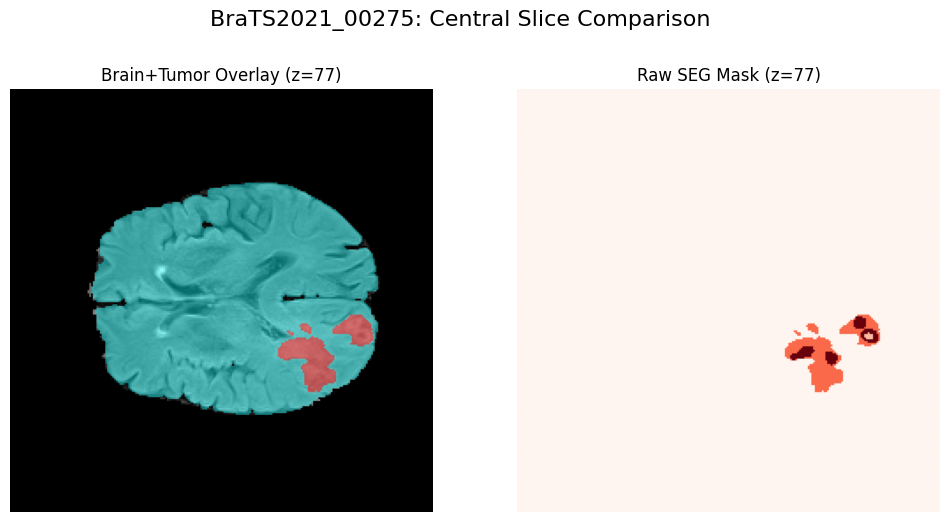


Processing BraTS2021_00280...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00280/BraTS2021_00280_brain_tumor_mask.nii.gz


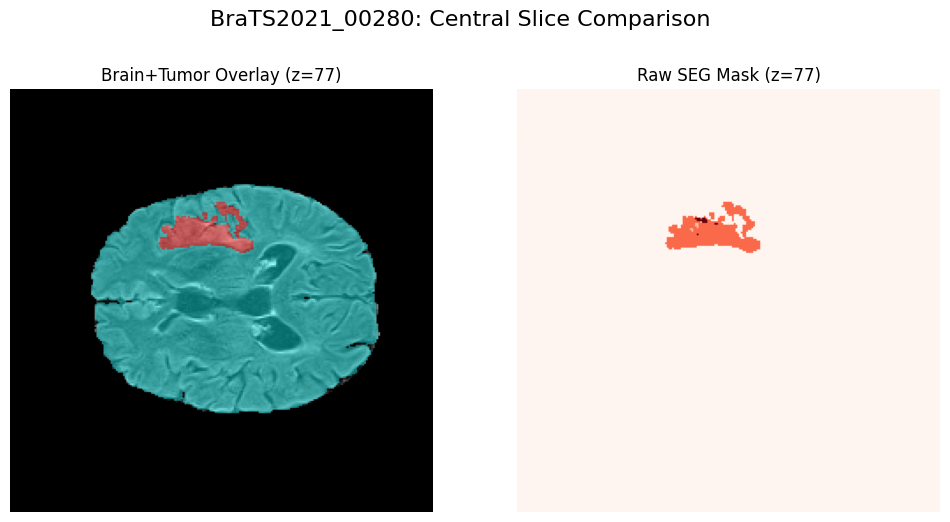


Processing BraTS2021_00281...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00281/BraTS2021_00281_brain_tumor_mask.nii.gz


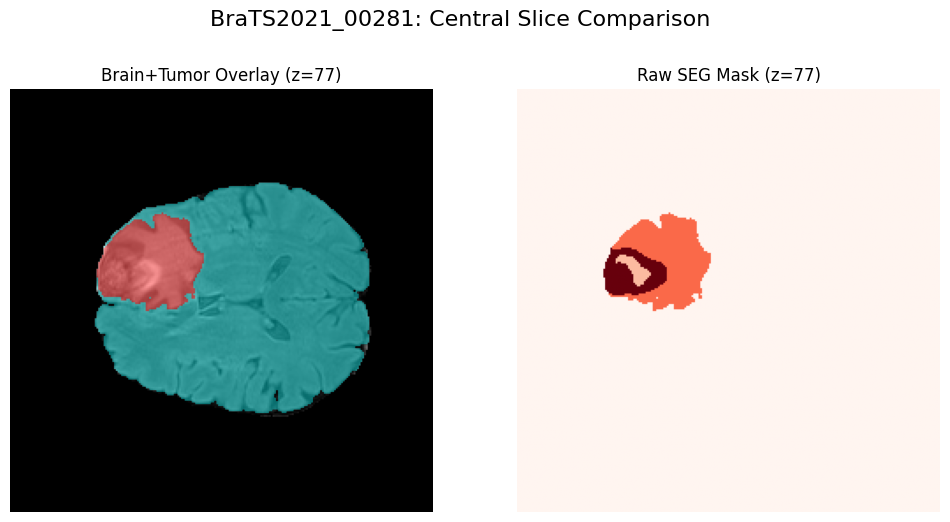


Processing BraTS2021_00282...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00282/BraTS2021_00282_brain_tumor_mask.nii.gz


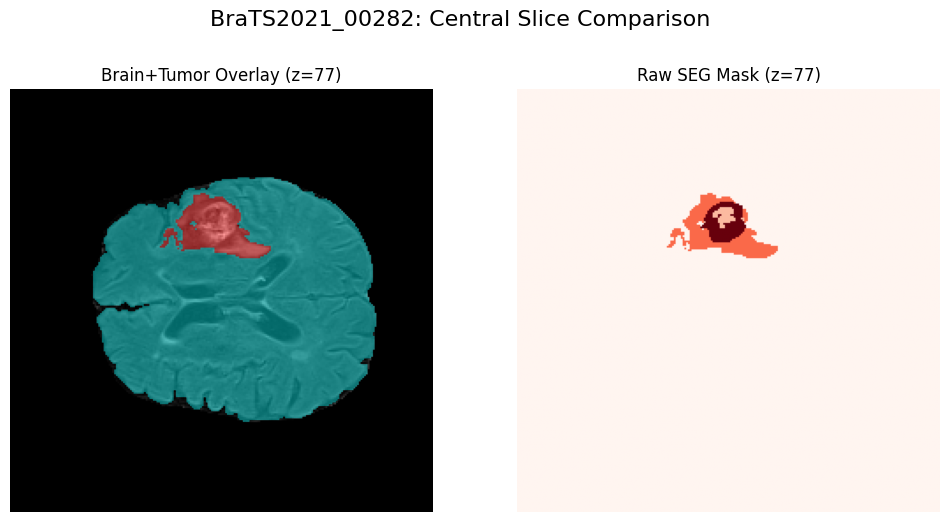


Processing BraTS2021_00283...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00283/BraTS2021_00283_brain_tumor_mask.nii.gz


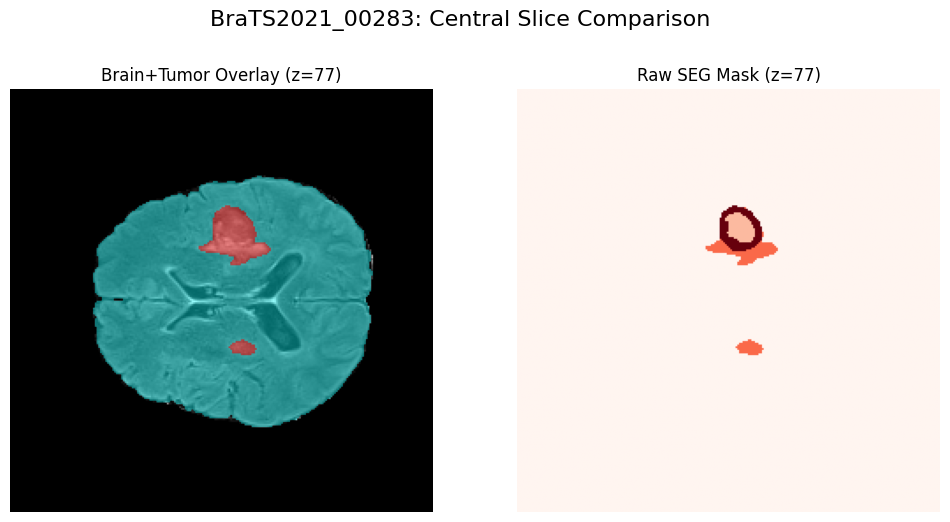


Processing BraTS2021_00284...
✔ Saved brain+tumor mask at: /content/extracted_data/BraTS2021_00284/BraTS2021_00284_brain_tumor_mask.nii.gz


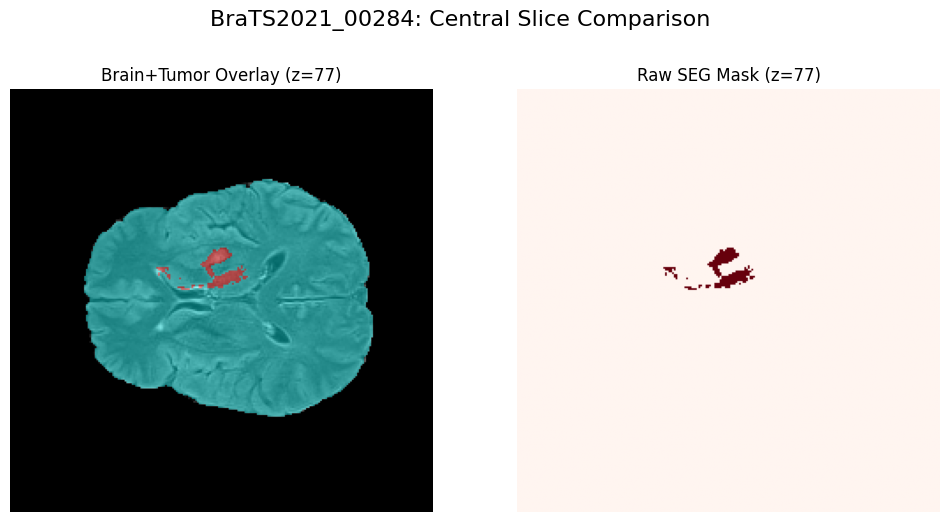

In [ ]:
base_path = "/content/extracted_data"

for patient_id in selected_patient_ids:
    print(f"\nProcessing {patient_id}...")
    images_ants = load_patient_as_ants(patient_id, base_path)
    patient_dir = os.path.join(base_path, patient_id)
    create_brain_tumor_mask_and_plot(images_ants, patient_id, save_dir=patient_dir)

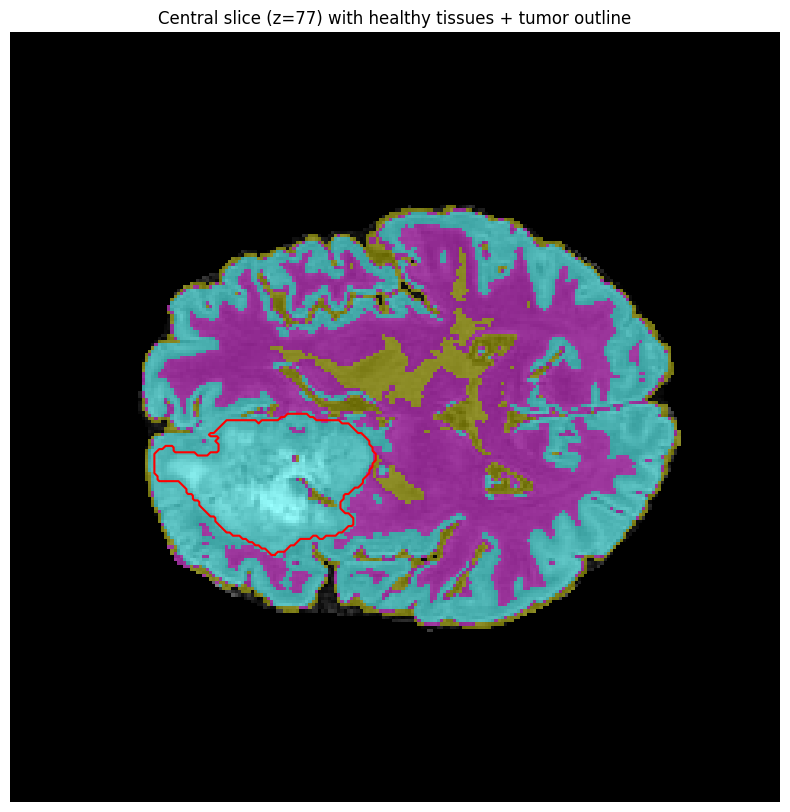

In [ ]:
import ants
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

flair_np = flair_ants.numpy()
seg_np = seg_ants.numpy()

mask = ants.get_mask(flair_ants) 
atropos = ants.atropos(a=flair_ants, x=mask, i='kmeans[3]', m='[0.1,1x1x1]', c='[5,0]', verbose=1)
tissue_np = atropos['segmentation'].numpy()  # 1=GM, 2=WM, 3=CSF

gm_mask = (tissue_np == 1)
wm_mask = (tissue_np == 2)
csf_mask = (tissue_np == 3)

# Tumor outline
tumor_mask = (seg_np > 0).astype(np.uint8)  
from skimage import measure
tumor_outline = measure.find_contours(tumor_mask[:, :, seg_np.shape[2]//2], 0.5)

# Plotting central slice
z_mid = flair_np.shape[2] // 2
plt.figure(figsize=(10,10))
plt.imshow(flair_np[:, :, z_mid], cmap='gray')

# Overlay healthy tissues
healthy_overlay = np.zeros_like(flair_np[:, :, z_mid])
healthy_overlay[csf_mask[:, :, z_mid]] = 1
healthy_overlay[gm_mask[:, :, z_mid]] = 2
healthy_overlay[wm_mask[:, :, z_mid]] = 3

healthy_cmap = ListedColormap(['cyan','yellow','magenta'])
plt.imshow(np.ma.masked_where(healthy_overlay==0, healthy_overlay), cmap=healthy_cmap, alpha=0.4)

# Overlay tumor outline
for contour in tumor_outline:
    plt.plot(contour[:, 1], contour[:, 0], color='red', linewidth=1.5)

plt.title(f'Central slice (z={z_mid}) with healthy tissues + tumor outline')
plt.axis('off')
plt.show()


✔ Loaded BraTS2021_00000 into ANTs format.


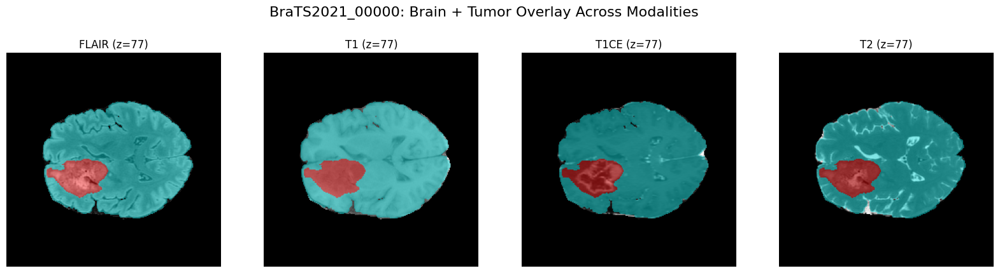

✔ Saved brain + tumor mask at: /content/extracted_data/BraTS2021_00000/BraTS2021_00000_brain_tumor_mask.nii.gz


In [ ]:
import os
import nibabel as nib
import ants
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from skimage import measure

def load_patient_as_ants(patient_id, base_path):

    # Load all BraTS modalities for a patient and convert to ANTsImage.
    # Returns: dict with keys ['flair','t1','t1ce','t2','seg']

    modalities = ['flair', 't1', 't1ce', 't2', 'seg']
    images_nib = {}
    patient_dir = os.path.join(base_path, patient_id)

    for modality in modalities:
        file_name = f"{patient_id}_{modality}.nii.gz"
        file_path = os.path.join(patient_dir, file_name)
        if not os.path.exists(file_path):
            file_path = os.path.join(base_path, file_name)
        if os.path.exists(file_path):
            images_nib[modality] = nib.load(file_path)
        else:
            print(f" Missing {modality} for {patient_id}")
            images_nib[modality] = None

    # Converting nibabel → ANTsImage
    images_ants = {}
    for mod, nib_img in images_nib.items():
        if nib_img is not None:
            data = nib_img.get_fdata()
            spacing = list(nib_img.header.get_zooms()[:3])
            origin = list(nib.affines.apply_affine(nib_img.affine, [0, 0, 0]))
            direction = nib_img.affine[:3, :3].tolist()
            images_ants[mod] = ants.from_numpy(data, spacing=spacing, origin=origin, direction=direction)
        else:
            images_ants[mod] = None

    print(f"✔ Loaded {patient_id} into ANTs format.")
    return images_ants

# SEGMENTING AND PLOTTING USING ALL MODALITIES
def segment_and_plot_all_modalities(images_ants, patient_id, save_mask=True):

    flair_ants = images_ants['flair']
    seg_ants   = images_ants['seg']

    if flair_ants is None or seg_ants is None:
        print(f"Skipping {patient_id}: missing FLAIR or SEG")
        return

    modalities_list = [images_ants[m] for m in ['flair','t1','t1ce','t2'] if images_ants[m] is not None]

    # GM/WM/CSF segmentation
    mask = ants.get_mask(flair_ants)
    atropos = ants.atropos(
        a=modalities_list,
        x=mask,
        i='kmeans[3]',
        m='[0.1,1x1x1]',
        c='[5,0]',
        verbose=1
    )
    tissue_np = atropos['segmentation'].numpy()
    gm_mask  = (tissue_np == 1)
    wm_mask  = (tissue_np == 2)
    csf_mask = (tissue_np == 3)

    # Tumor mask
    seg_np = seg_ants.numpy()
    tumor_mask = (seg_np > 0).astype(np.uint8)
    z_mid = flair_ants.shape[2] // 2
    contours = measure.find_contours(tumor_mask[:, :, z_mid], 0.5)

    # Plotting central slice for all modalities
    modalities_to_plot = ['flair','t1','t1ce','t2']
    n_modalities = len(modalities_to_plot)
    plt.figure(figsize=(5*n_modalities, 5))

    for i, mod in enumerate(modalities_to_plot):
        img_ants = images_ants[mod]
        if img_ants is None:
            continue
        img_np = img_ants.numpy()
        healthy_overlay = np.zeros_like(img_np[:, :, z_mid])

        # Correct tissue-to-color mapping
        healthy_overlay[csf_mask[:, :, z_mid]] = 1  # CSF -> cyan
        healthy_overlay[gm_mask[:, :, z_mid]]  = 2  # GM  -> yellow
        healthy_overlay[wm_mask[:, :, z_mid]]  = 3  # WM  -> magenta

        healthy_cmap = ListedColormap(['cyan', 'yellow', 'magenta'])

        plt.subplot(1, n_modalities, i+1)
        plt.imshow(img_np[:, :, z_mid], cmap='gray')
        plt.imshow(np.ma.masked_where(healthy_overlay==0, healthy_overlay), cmap=healthy_cmap, alpha=0.4)

        # Plot tumor contours
        for c in contours:
            plt.plot(c[:,1], c[:,0], color='red', linewidth=1.5)

        plt.title(f"{mod.upper()} (z={z_mid})")
        plt.axis('off')

    plt.suptitle(f"{patient_id}: CSF/GM/WM + Tumor Overlay Across Modalities", fontsize=16)
    plt.show()

    # Save combined mask
    if save_mask:
      combined_mask = np.zeros_like(seg_np)
      combined_mask[csf_mask] = 1
      combined_mask[gm_mask]  = 2
      combined_mask[wm_mask]  = 3
      combined_mask[tumor_mask>0] = 4  # Tumor

      combined_ants = ants.from_numpy(
          combined_mask,
          spacing=flair_ants.spacing,
          origin=flair_ants.origin,
          direction=flair_ants.direction
      )

      # Using patient folder for saving
      patient_dir = os.path.join(base_path, patient_id)
      save_path = os.path.join(patient_dir, f"{patient_id}_csf_gm_wm_tumor.nii.gz")
      ants.image_write(combined_ants, save_path)
      print(f"✔ Saved combined CSF/GM/WM + tumor mask at: {save_path}")

# RUN FOR A PATIENT
base_path = "/content/extracted_data"
patient_id = "BraTS2021_00000"

images_ants = load_patient_as_ants(patient_id, base_path)
segment_and_plot_all_modalities(images_ants, patient_id, save_mask=True)



Processing patient: BraTS2021_00101
✔ Loaded BraTS2021_00101 into ANTs format.


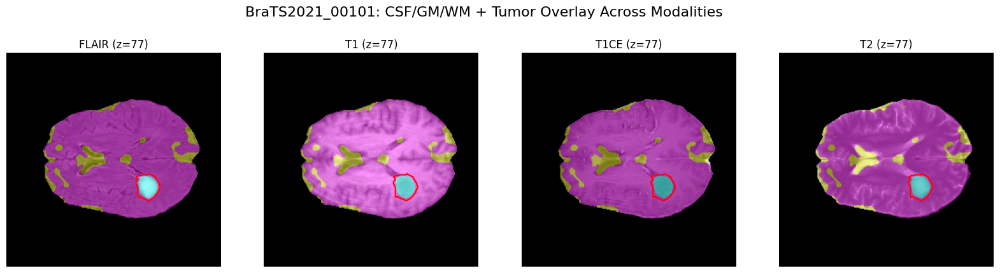

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00101/BraTS2021_00101_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00102
✔ Loaded BraTS2021_00102 into ANTs format.


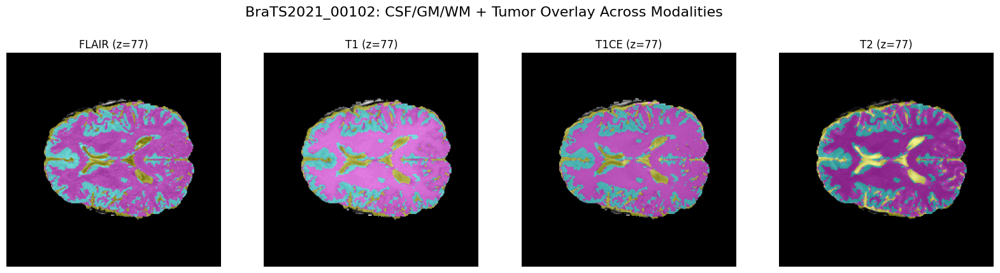

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00102/BraTS2021_00102_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00103
✔ Loaded BraTS2021_00103 into ANTs format.


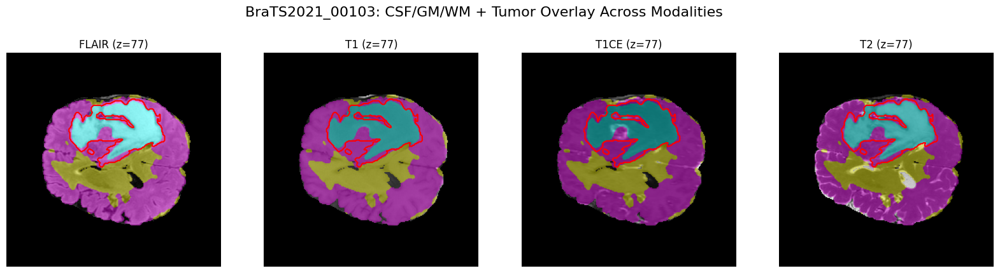

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00103/BraTS2021_00103_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00104
✔ Loaded BraTS2021_00104 into ANTs format.


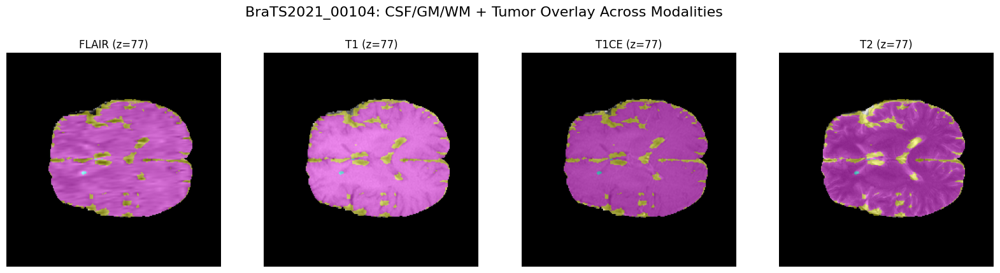

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00104/BraTS2021_00104_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00105
✔ Loaded BraTS2021_00105 into ANTs format.


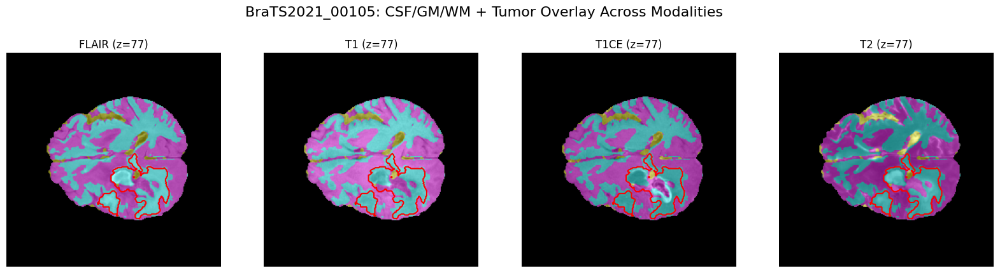

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00105/BraTS2021_00105_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00106
✔ Loaded BraTS2021_00106 into ANTs format.


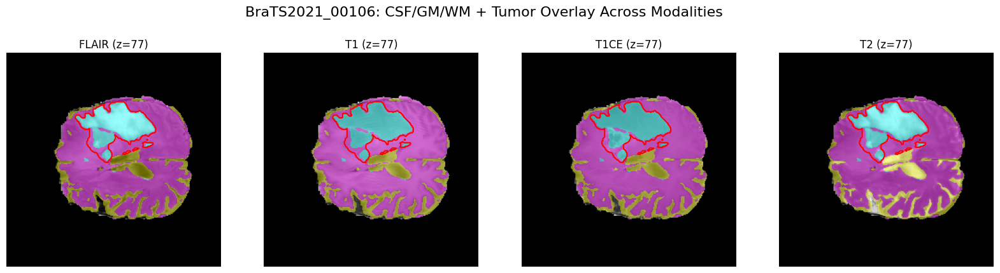

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00106/BraTS2021_00106_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00107
✔ Loaded BraTS2021_00107 into ANTs format.


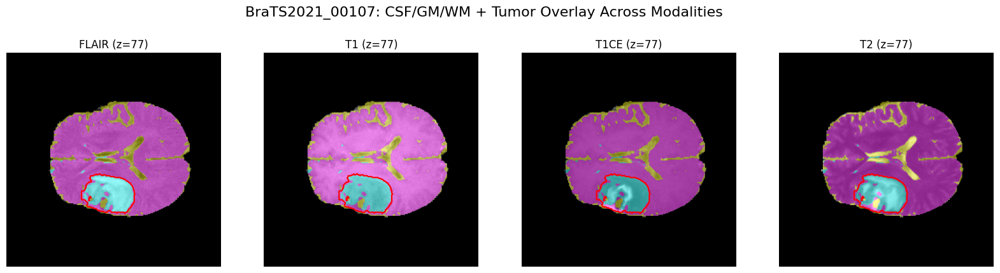

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00107/BraTS2021_00107_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00108
✔ Loaded BraTS2021_00108 into ANTs format.


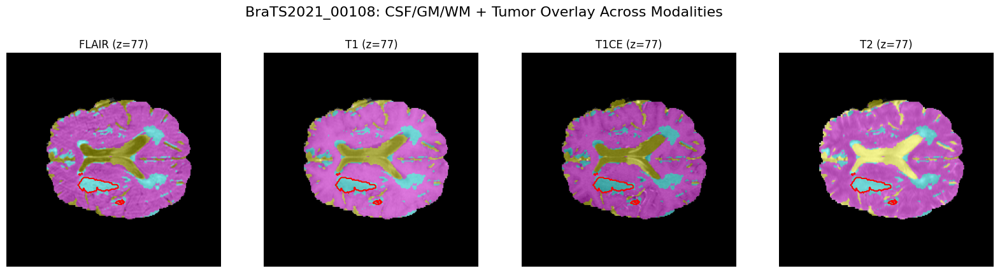

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00108/BraTS2021_00108_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00109
✔ Loaded BraTS2021_00109 into ANTs format.


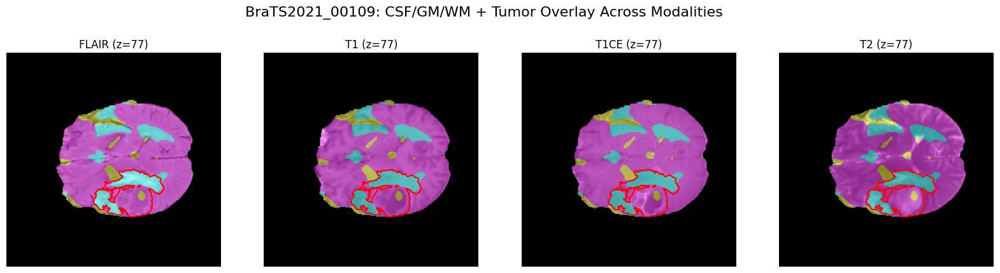

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00109/BraTS2021_00109_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00110
✔ Loaded BraTS2021_00110 into ANTs format.


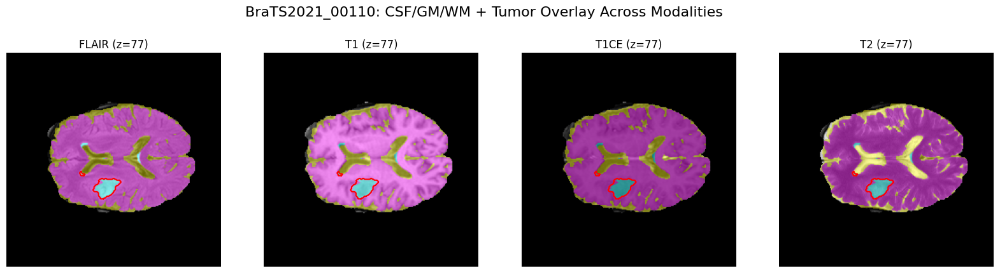

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00110/BraTS2021_00110_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00111
✔ Loaded BraTS2021_00111 into ANTs format.


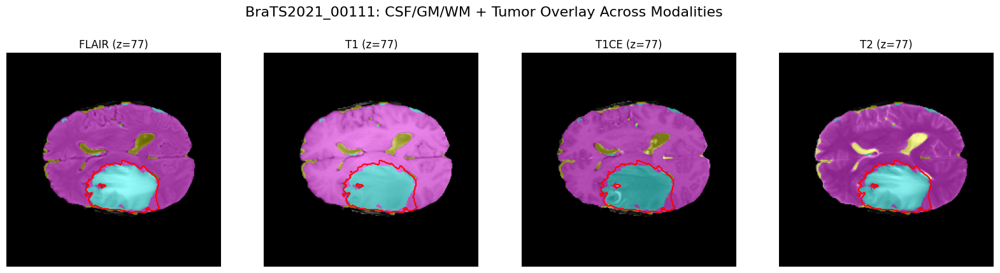

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00111/BraTS2021_00111_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00112
✔ Loaded BraTS2021_00112 into ANTs format.


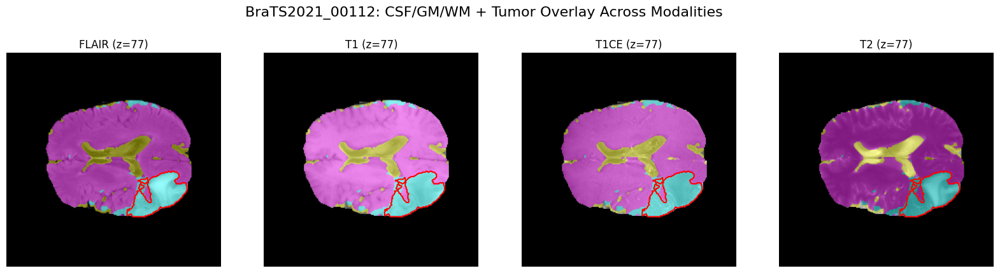

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00112/BraTS2021_00112_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00113
✔ Loaded BraTS2021_00113 into ANTs format.


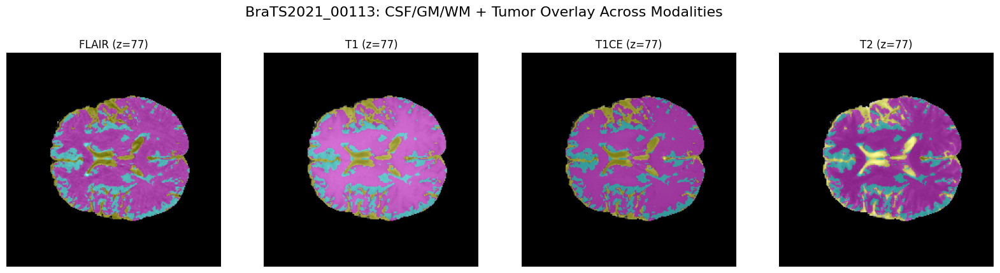

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00113/BraTS2021_00113_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00115
✔ Loaded BraTS2021_00115 into ANTs format.


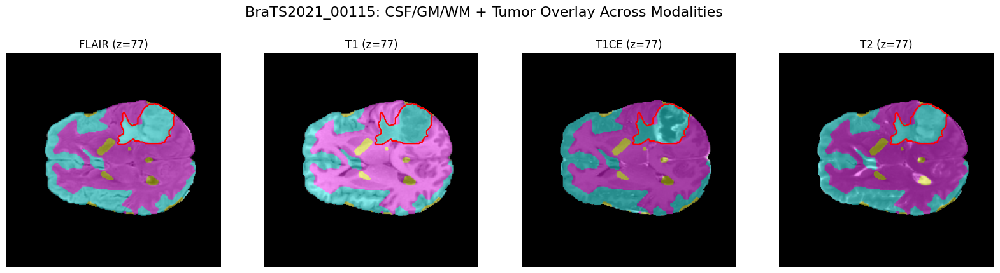

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00115/BraTS2021_00115_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00116
✔ Loaded BraTS2021_00116 into ANTs format.


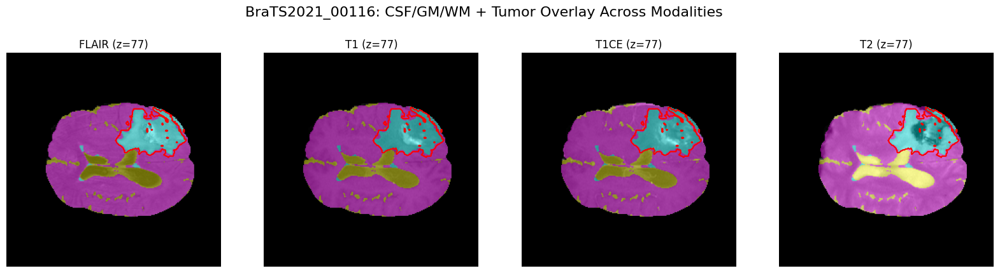

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00116/BraTS2021_00116_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00117
✔ Loaded BraTS2021_00117 into ANTs format.


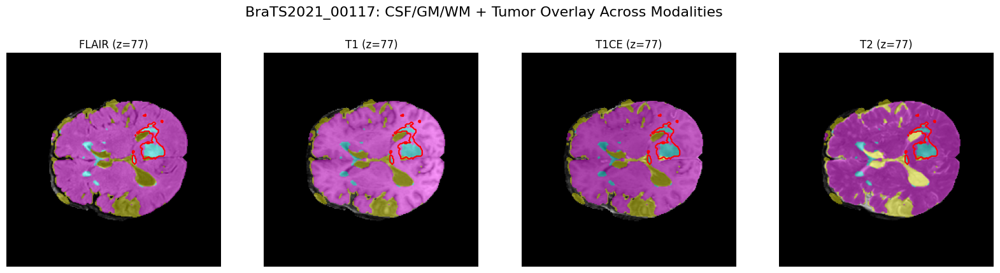

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00117/BraTS2021_00117_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00118
✔ Loaded BraTS2021_00118 into ANTs format.


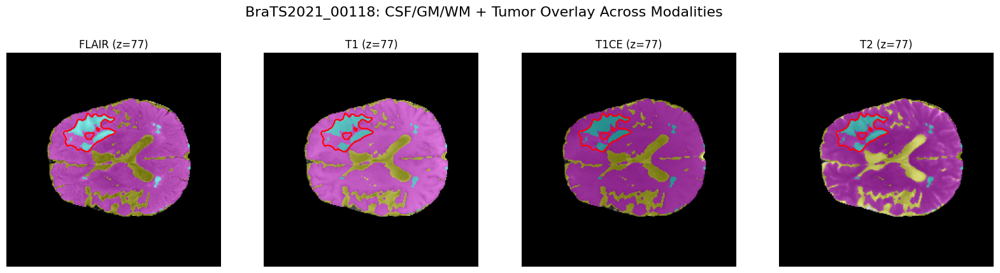

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00118/BraTS2021_00118_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00120
✔ Loaded BraTS2021_00120 into ANTs format.


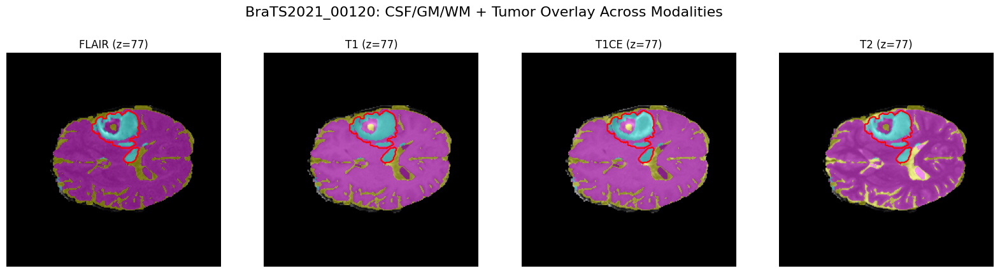

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00120/BraTS2021_00120_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00121
✔ Loaded BraTS2021_00121 into ANTs format.


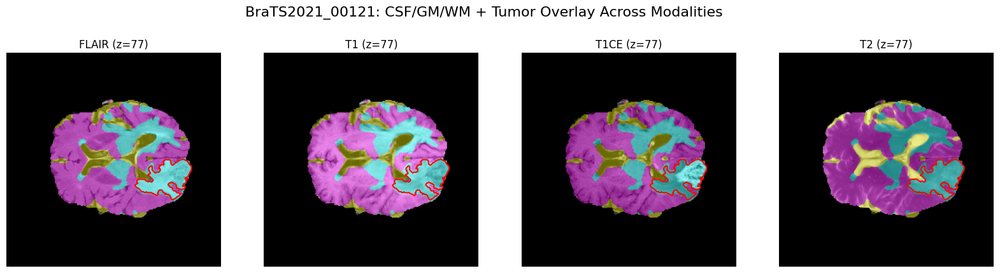

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00121/BraTS2021_00121_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00122
✔ Loaded BraTS2021_00122 into ANTs format.


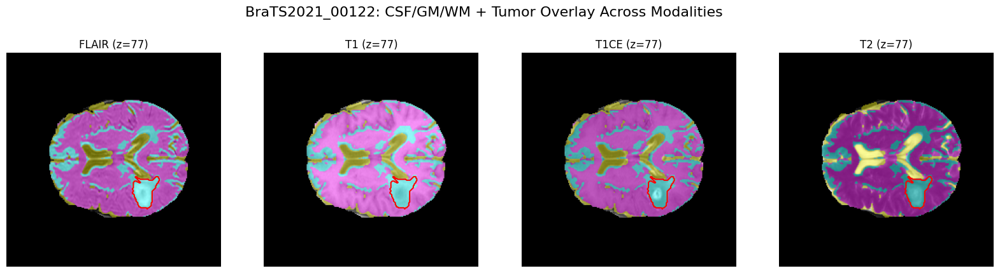

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00122/BraTS2021_00122_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00123
✔ Loaded BraTS2021_00123 into ANTs format.


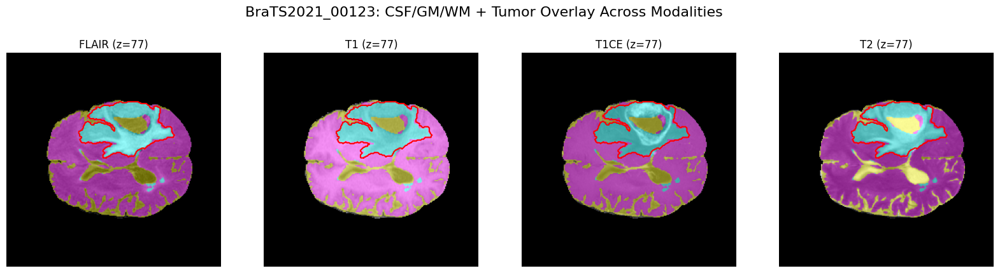

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00123/BraTS2021_00123_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00124
✔ Loaded BraTS2021_00124 into ANTs format.


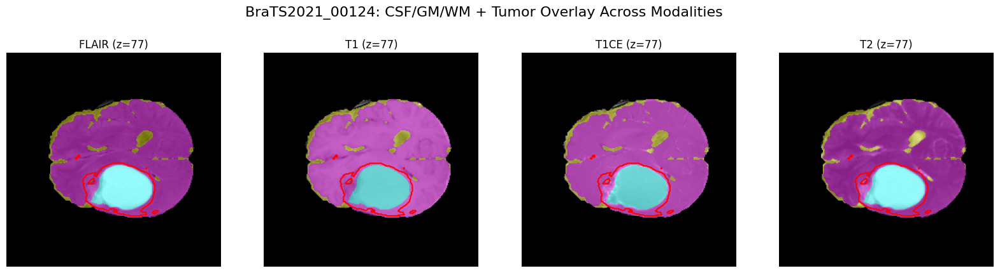

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00124/BraTS2021_00124_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00126
✔ Loaded BraTS2021_00126 into ANTs format.


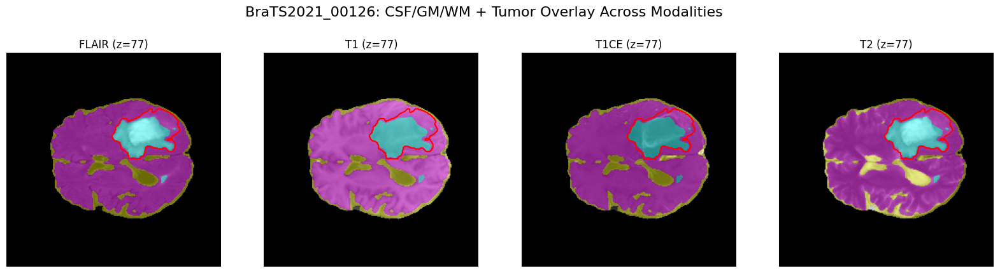

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00126/BraTS2021_00126_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00127
✔ Loaded BraTS2021_00127 into ANTs format.


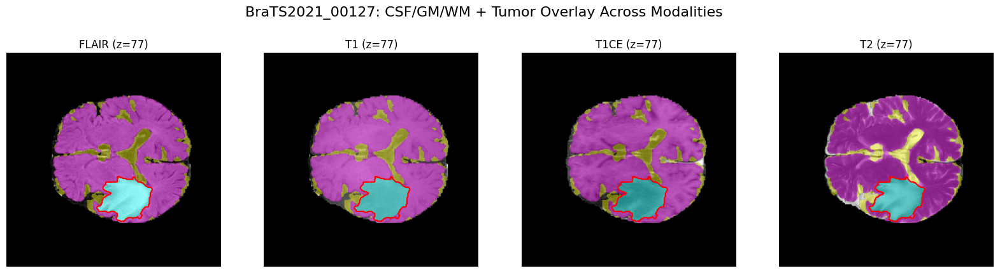

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00127/BraTS2021_00127_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00128
✔ Loaded BraTS2021_00128 into ANTs format.


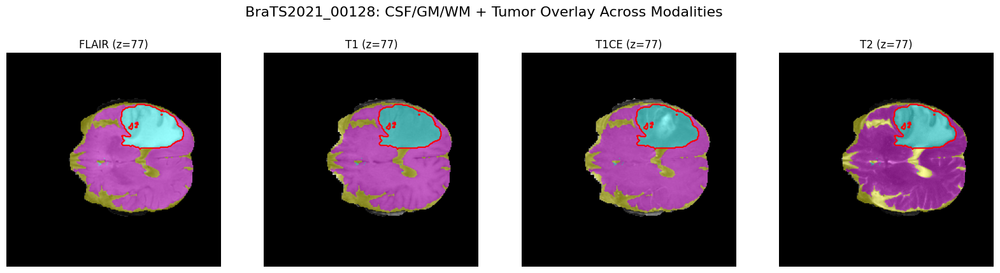

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00128/BraTS2021_00128_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00130
✔ Loaded BraTS2021_00130 into ANTs format.


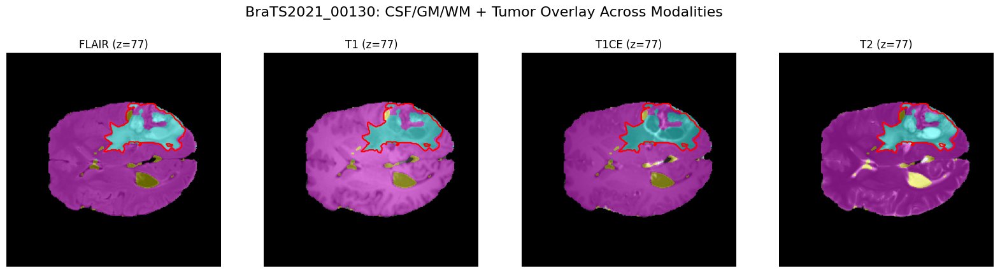

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00130/BraTS2021_00130_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00131
✔ Loaded BraTS2021_00131 into ANTs format.


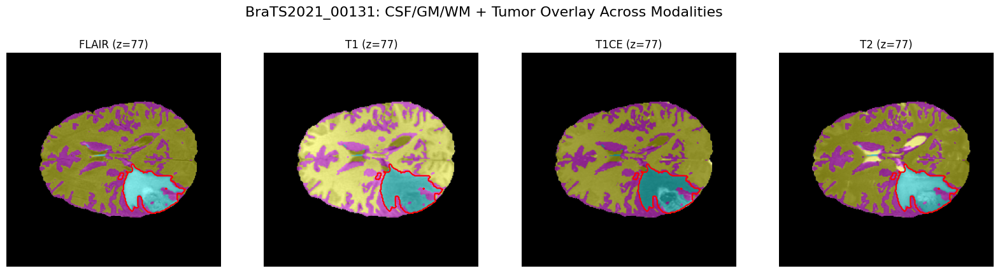

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00131/BraTS2021_00131_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00132
✔ Loaded BraTS2021_00132 into ANTs format.


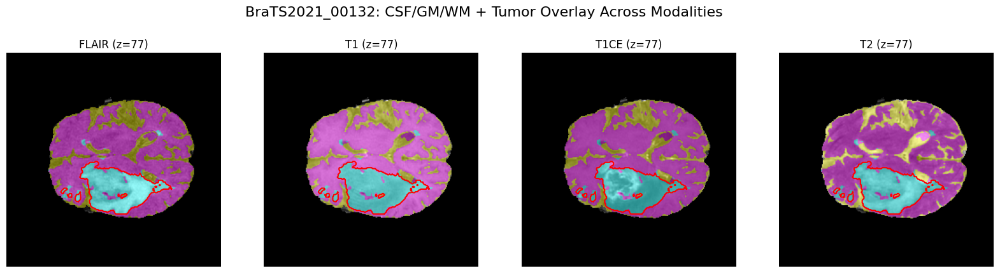

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00132/BraTS2021_00132_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00133
✔ Loaded BraTS2021_00133 into ANTs format.


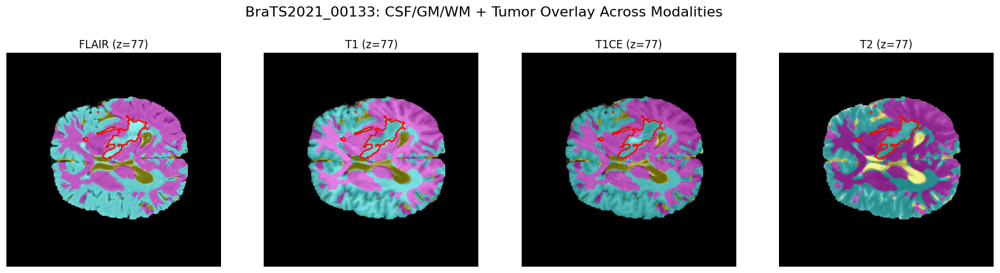

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00133/BraTS2021_00133_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00134
✔ Loaded BraTS2021_00134 into ANTs format.


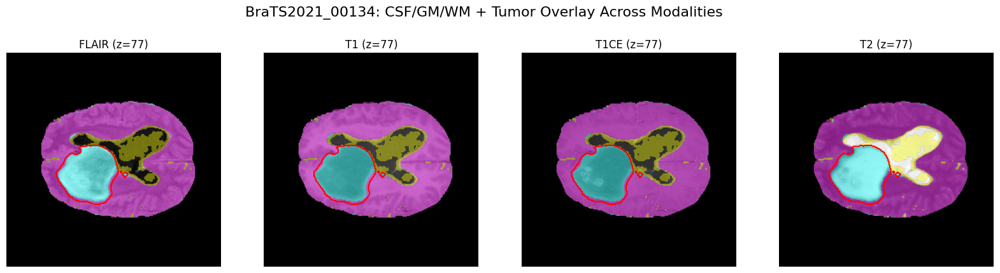

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00134/BraTS2021_00134_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00136
✔ Loaded BraTS2021_00136 into ANTs format.


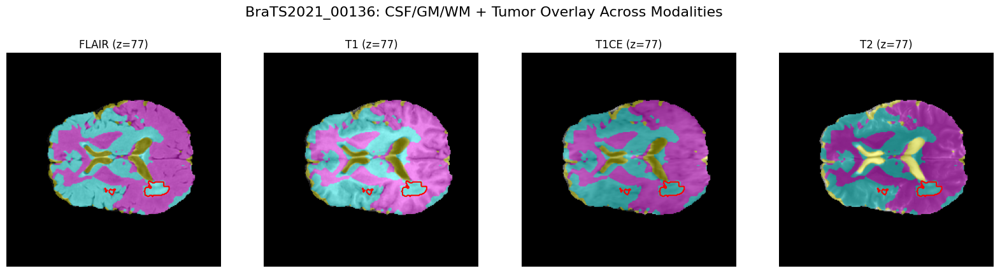

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00136/BraTS2021_00136_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00137
✔ Loaded BraTS2021_00137 into ANTs format.


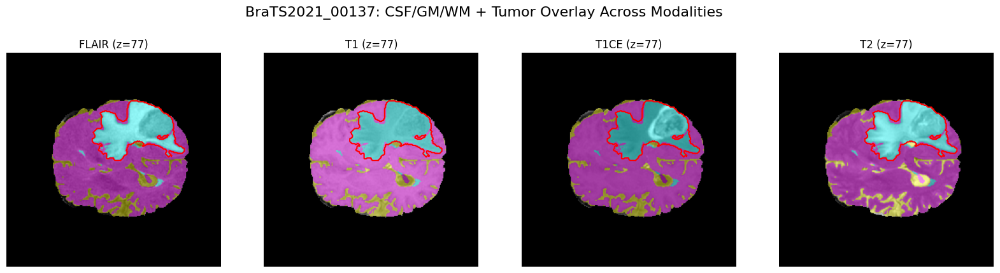

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00137/BraTS2021_00137_csf_gm_wm_tumor.nii.gz

Processing patient: BraTS2021_00138
✔ Loaded BraTS2021_00138 into ANTs format.


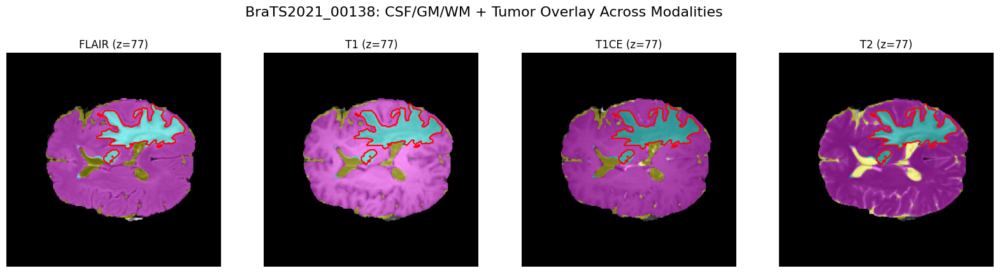

✔ Saved combined CSF/GM/WM + tumor mask at: /content/extracted_data/BraTS2021_00138/BraTS2021_00138_csf_gm_wm_tumor.nii.gz


In [ ]:
selected_patient_ids = selected_patient_ids[-33:]
for patient_id in selected_patient_ids:
    print(f"\nProcessing patient: {patient_id}")
    images_ants = load_patient_as_ants(patient_id, base_path)
    segment_and_plot_all_modalities(images_ants, patient_id, save_mask=True)

# Adding the colour to the tumour

In [ ]:
import os
import nibabel as nib
import ants
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from skimage import measure

# READING MASK AND MODIFYING TUMOR
def color_tumor_in_mask(mask_path, output_path):

    # Read mask
    mask_ants = ants.image_read(mask_path)
    mask_np = mask_ants.numpy()

    # Middle slice
    z_mid = mask_np.shape[2] // 2
    mask_slice = mask_np[:, :, z_mid]  # 2D slice

    # BEFORE
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(mask_slice, cmap='gray')
    plt.title("Before Tumor Coloring")
    plt.axis('off')

    # AFTER: creating colormap
    cmap = ListedColormap(['cyan', 'yellow', 'magenta', 'red'])  # 1=CSF, 2=GM, 3=WM, 4=Tumor
    plt.subplot(1,2,2)
    plt.imshow(np.ma.masked_where(mask_slice==0, mask_slice), cmap=cmap, alpha=0.7)
    plt.title("After Tumor Coloring")
    plt.axis('off')
    plt.show()

    # ants.image_write(mask_ants, output_path)
    print(f"✔ Saved mask at: {output_path}")

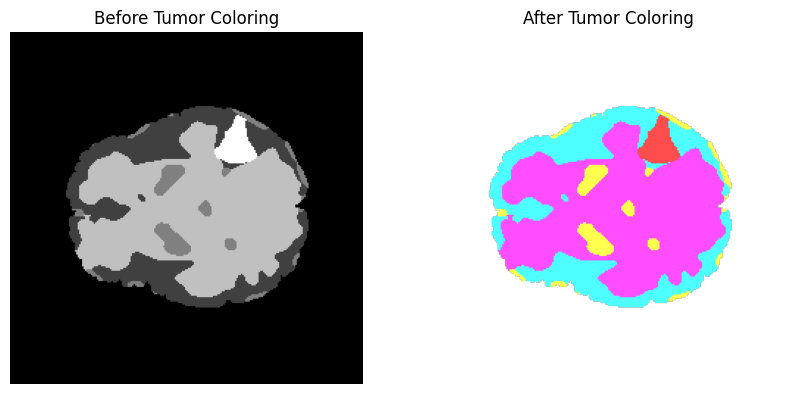

✔ Saved mask at: /content/extracted_data/BraTS2021_00008/BraTS2021_00008_csf_gm_wm_tumor.nii.gz


In [ ]:
base_path = "/content/extracted_data"
patient_id = "BraTS2021_00008"

# Path to existing combined mask
mask_path = os.path.join(base_path, patient_id, f"{patient_id}_csf_gm_wm_tumor.nii.gz")
output_path = mask_path  # overwriting the same file

color_tumor_in_mask(mask_path, output_path)

In [ ]:
import ants
import numpy as np

mask_path = "/content/extracted_data/BraTS2021_00000/BraTS2021_00000_csf_gm_wm_tumor.nii.gz"
mask_ants = ants.image_read(mask_path)
mask_np = mask_ants.numpy()

print("Unique labels in mask:", np.unique(mask_np))

Unique labels in mask: [0. 1. 2. 3. 4.]


In [ ]:
base_path = "/content/extracted_data"
patient_id = "BraTS2021_00000"

# Path to existing combined mask
for i in range(len(selected_patient_ids)):
    patient_id = selected_patient_ids[i]
    mask_path = os.path.join(base_path, patient_id, f"{patient_id}_csf_gm_wm_tumor.nii.gz")
    output_path = mask_path  # overwriting the same file

    color_tumor_in_mask(mask_path, output_path)

In [ ]:
import os
import shutil
import zipfile

# Re-initializing output_path and selected_patient_ids for robustness
output_path = '/content/extracted_data'

unique_patient_ids = set()
for item in os.listdir(output_path):
    if os.path.isdir(os.path.join(output_path, item)):
        if item.startswith('BraTS2021_'):
            unique_patient_ids.add(item)
    elif item.endswith('.nii.gz'):
        patient_id_parts = item.split('_')
        if len(patient_id_parts) >= 2:
            patient_id = patient_id_parts[0] + '_' + patient_id_parts[1]
            if patient_id.startswith('BraTS2021_'):
                unique_patient_ids.add(patient_id)
sorted_patient_ids = sorted(list(unique_patient_ids))
selected_patient_ids = sorted_patient_ids[:100]

temp_combined_dir = '/content/all_100_patients_combined'
if os.path.exists(temp_combined_dir):
    shutil.rmtree(temp_combined_dir)
os.makedirs(temp_combined_dir, exist_ok=True)

print(f"Gathering ALL files for {len(selected_patient_ids)} patients into a single folder...")

for patient_id in selected_patient_ids:
    patient_source_dir = os.path.join(output_path, patient_id)
    patient_dest_dir = os.path.join(temp_combined_dir, patient_id)

    # Handling case where patient data is in a subdirectory
    if os.path.isdir(patient_source_dir):
        shutil.copytree(patient_source_dir, patient_dest_dir, dirs_exist_ok=True)
    else:
        # If no dedicated directory, creating the patient_dest_dir anyway for consistency
        os.makedirs(patient_dest_dir, exist_ok=True)

    # Handling case where some patient files might be directly in output_path
    for item_name in os.listdir(output_path):
        if item_name.startswith(patient_id) and item_name.endswith('.nii.gz'):
            src_file_path = os.path.join(output_path, item_name)
            dest_file_path = os.path.join(patient_dest_dir, item_name)
            shutil.copyfile(src_file_path, dest_file_path)

print("✔ All patient files gathered. Now zipping the combined folder...")

# Defining the name and path for the final consolidated zip file
final_zip_name = 'all_100_processed_patients.zip'
final_zip_path_base = os.path.join('/content', os.path.splitext(final_zip_name)[0]) # path without .zip extension

try:
    shutil.make_archive(
        base_name=final_zip_path_base,
        format='zip',
        root_dir=temp_combined_dir
    )
    print(f"✔ Successfully created consolidated zip file: {os.path.join('/content', final_zip_name)}")
    print("You can now download this file from the '/content' directory.")
except Exception as e:
    print(f"Error creating consolidated zip file: {e}")
finally:
    if os.path.exists(temp_combined_dir):
        shutil.rmtree(temp_combined_dir)
        print("Temporary combined directory cleaned up.")


Gathering ALL files for 100 patients into a single folder...
✔ All patient files gathered. Now zipping the combined folder...
✔ Successfully created consolidated zip file: /content/all_100_processed_patients.zip
You can now download this file from the '/content' directory.
Temporary combined directory cleaned up.


In [ ]:
import os

output_path = '/content/extracted_data'

# Identifying unique patient IDs
unique_patient_ids = set()
for item in os.listdir(output_path):
    if os.path.isdir(os.path.join(output_path, item)): # Check if it's a directory
        if item.startswith('BraTS2021_'):
            unique_patient_ids.add(item)
    elif item.endswith('.nii.gz'): # Check if it's a NIfTI file directly in output_path
        patient_id_parts = item.split('_')
        if len(patient_id_parts) >= 2:
            patient_id = patient_id_parts[0] + '_' + patient_id_parts[1]
            if patient_id.startswith('BraTS2021_'):
                unique_patient_ids.add(patient_id)

# Sorting patient IDs for consistent selection
sorted_patient_ids = sorted(list(unique_patient_ids))

# Filtering for patient IDs greater than BraTS2021_00100
patient_ids_greater_than_100 = [pid for pid in sorted_patient_ids if pid > 'BraTS2021_00100']

print(f"Patient IDs greater than BraTS2021_00100 ({len(patient_ids_greater_than_100)} patients):")
for patient_id in patient_ids_greater_than_100:
    print(patient_id)


Patient IDs greater than BraTS2021_00100 (1184 patients):
BraTS2021_00101
BraTS2021_00102
BraTS2021_00103
BraTS2021_00104
BraTS2021_00105
BraTS2021_00106
BraTS2021_00107
BraTS2021_00108
BraTS2021_00109
BraTS2021_00110
BraTS2021_00111
BraTS2021_00112
BraTS2021_00113
BraTS2021_00115
BraTS2021_00116
BraTS2021_00117
BraTS2021_00118
BraTS2021_00120
BraTS2021_00121
BraTS2021_00122
BraTS2021_00123
BraTS2021_00124
BraTS2021_00126
BraTS2021_00127
BraTS2021_00128
BraTS2021_00130
BraTS2021_00131
BraTS2021_00132
BraTS2021_00133
BraTS2021_00134
BraTS2021_00136
BraTS2021_00137
BraTS2021_00138
BraTS2021_00139
BraTS2021_00140
BraTS2021_00142
BraTS2021_00143
BraTS2021_00144
BraTS2021_00146
BraTS2021_00147
BraTS2021_00148
BraTS2021_00149
BraTS2021_00150
BraTS2021_00151
BraTS2021_00152
BraTS2021_00154
BraTS2021_00155
BraTS2021_00156
BraTS2021_00157
BraTS2021_00158
BraTS2021_00159
BraTS2021_00160
BraTS2021_00162
BraTS2021_00165
BraTS2021_00166
BraTS2021_00167
BraTS2021_00170
BraTS2021_00171
BraTS2021_0017

In [ ]:
import os

zip_file_path = '/content/all_100_processed_patients.zip'

if os.path.exists(zip_file_path):
    size_in_bytes = os.path.getsize(zip_file_path)
    size_in_mb = size_in_bytes / (1024 * 1024)
    size_in_gb = size_in_bytes / (1024 * 1024 * 1024)

    print(f"The size of '{zip_file_path}' is:")
    print(f"  {size_in_bytes:,} bytes")
    print(f"  {size_in_mb:.2f} MB")
    print(f"  {size_in_gb:.2f} GB")
else:
    print(f"The file '{zip_file_path}' does not exist.")


The size of '/content/all_100_processed_patients.zip' is:
  962,007,589 bytes
  917.44 MB
  0.90 GB


In [ ]:
selected_patient_ids

['BraTS2021_00000',
 'BraTS2021_00002',
 'BraTS2021_00003',
 'BraTS2021_00005',
 'BraTS2021_00006',
 'BraTS2021_00008',
 'BraTS2021_00009',
 'BraTS2021_00011',
 'BraTS2021_00012',
 'BraTS2021_00014',
 'BraTS2021_00016',
 'BraTS2021_00017',
 'BraTS2021_00018',
 'BraTS2021_00019',
 'BraTS2021_00020',
 'BraTS2021_00021',
 'BraTS2021_00022',
 'BraTS2021_00024',
 'BraTS2021_00025',
 'BraTS2021_00026',
 'BraTS2021_00028',
 'BraTS2021_00030',
 'BraTS2021_00031',
 'BraTS2021_00032',
 'BraTS2021_00033',
 'BraTS2021_00035',
 'BraTS2021_00036',
 'BraTS2021_00043',
 'BraTS2021_00044',
 'BraTS2021_00045',
 'BraTS2021_00046',
 'BraTS2021_00048',
 'BraTS2021_00049',
 'BraTS2021_00051',
 'BraTS2021_00052',
 'BraTS2021_00053',
 'BraTS2021_00054',
 'BraTS2021_00056',
 'BraTS2021_00058',
 'BraTS2021_00059',
 'BraTS2021_00060',
 'BraTS2021_00061',
 'BraTS2021_00062',
 'BraTS2021_00063',
 'BraTS2021_00064',
 'BraTS2021_00066',
 'BraTS2021_00068',
 'BraTS2021_00070',
 'BraTS2021_00071',
 'BraTS2021_00072',


Data Slicing and Splitting

In [ ]:
import os
import nibabel as nib
import numpy as np
from PIL import Image
from tqdm import tqdm
import shutil
import random

root = "/content/extracted_data"
output = "/content/brats_sliced_all"
SOURCE = output
DEST = "/content/brats_split"
MASK_TYPE = "tissue"

# Modalities to slice
modalities = {
    "flair": "_flair.nii.gz",
    "t1": "_t1.nii.gz",
    "t1ce": "_t1ce.nii.gz",
    "t2": "_t2.nii.gz",
    "seg": "_seg.nii.gz",
    "tissue": "_csf_gm_wm_tumor.nii.gz",
}

def colorize_seg(mask: np.ndarray) -> np.ndarray:
    seg_rgb = np.zeros((*mask.shape, 3), dtype=np.uint8)
    seg_rgb[mask == 1] = [255, 0, 0]
    seg_rgb[mask == 2] = [255, 255, 0]
    seg_rgb[mask == 4] = [0, 255, 255]
    return seg_rgb

def colorize_tissue(mask: np.ndarray) -> np.ndarray:
    COLORS = {
        0: (0, 0, 0),          # background - black
        1: (0, 0, 255),        # CSF - blue
        2: (0, 255, 0),        # GM - green
        3: (255, 255, 0),      # WM - yellow
        4: (255, 0, 0),        # Tumor - red
        # 5: (255, 165, 0),      # extra classes if present
    }
    h, w = mask.shape
    rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for label, color in COLORS.items():
        rgb[mask == label] = color
    return rgb

def load_volume(mod_name: str, path: str) -> np.ndarray:
    nii = nib.load(path)
    data = nii.get_fdata()
    if mod_name in ["seg", "tissue"]:
        data = np.rint(data).astype(np.uint8)
    else:
        data = data.astype(np.float32)
    return data

In [ ]:
# SLICE PATIENTS + REMOVE EMPTY SLICES

def slice_all_patients():
    os.makedirs(output, exist_ok=True)
    patients = sorted(os.listdir(root))
    print("Found patients:", len(patients))

    for p in tqdm(patients, desc="Slicing All Patients"):
        p_path = os.path.join(root, p)
        if not os.path.isdir(p_path):
            continue

        patient_out = os.path.join(output, p)
        os.makedirs(patient_out, exist_ok=True)

        loaded_mods = {}
        for mod_name, mod_suffix in modalities.items():
            mod_path = os.path.join(p_path, p + mod_suffix)
            if os.path.exists(mod_path):
                try:
                    vol = load_volume(mod_name, mod_path)
                    loaded_mods[mod_name] = vol
                except Exception as e:
                    print(f"Error loading {mod_name} for {p}: {e}")

        if "flair" not in loaded_mods:
            print("Skipping (no flair):", p)
            continue

        num_slices = loaded_mods["flair"].shape[2]

        for mod in loaded_mods:
            os.makedirs(os.path.join(patient_out, mod), exist_ok=True)

        for s in range(num_slices):
            for mod, volume in loaded_mods.items():
                slice_2d = volume[:, :, s]

                if mod in ["flair", "t1", "t1ce", "t2"]:
                    vmin, vmax = slice_2d.min(), slice_2d.max()
                    norm = (slice_2d - vmin) / (vmax - vmin) if vmax != vmin else np.zeros_like(slice_2d)
                    img = (norm * 255).astype(np.uint8)
                elif mod == "seg":
                    img = colorize_seg(slice_2d.astype(np.uint8))
                elif mod == "tissue":
                    img = colorize_tissue(slice_2d.astype(np.uint8))
                else:
                    img = slice_2d.astype(np.uint8)

                save_dir = os.path.join(patient_out, mod)
                Image.fromarray(img).save(os.path.join(save_dir, f"slice_{s:03}.png"))

    print("\nDONE! All axial slices saved at:", output)


def remove_empty_slices():
    root_dir = SOURCE
    modalities_list = ["flair", "t1", "t1ce", "t2", "seg", "tissue"]

    def is_empty_slice(img_array):
        return np.all(img_array == 0)

    patients = sorted(os.listdir(root_dir))

    for p in tqdm(patients, desc="Checking patients"):
        patient_path = os.path.join(root_dir, p)
        if not os.path.isdir(patient_path):
            continue

        flair_dir = os.path.join(patient_path, "flair")
        if not os.path.exists(flair_dir):
            continue

        slice_files = sorted([f for f in os.listdir(flair_dir) if f.endswith(".png")])

        for slice_file in slice_files:
            slice_empty = True

            for mod in modalities_list:
                mod_dir = os.path.join(patient_path, mod)
                slice_path = os.path.join(mod_dir, slice_file)

                if os.path.exists(slice_path):
                    arr = np.array(Image.open(slice_path))
                    if not is_empty_slice(arr):
                        slice_empty = False
                        break

            if slice_empty:
                for mod in modalities_list:
                    slice_path = os.path.join(patient_path, mod, slice_file)
                    if os.path.exists(slice_path):
                        os.remove(slice_path)

    print("\nDONE! Removed all completely empty slices.")

In [ ]:
# SPLIT DATASET + MAIN

def split_dataset():
    SOURCE = output
    DEST = "/content/brats_split"
    MASK_TYPE = "tissue"

    splits = ["train", "val", "test"]
    for sp in splits:
        os.makedirs(os.path.join(DEST, sp, "flair"), exist_ok=True)
        os.makedirs(os.path.join(DEST, sp, "mask"), exist_ok=True)

    patients = sorted([p for p in os.listdir(SOURCE)
                       if os.path.isdir(os.path.join(SOURCE, p))])

    print("Total patients:", len(patients))
    random.shuffle(patients)

    TRAIN_SPLIT = 0.7
    VAL_SPLIT = 0.15

    train_end = int(len(patients) * TRAIN_SPLIT)
    val_end = train_end + int(len(patients) * VAL_SPLIT)

    splits_dict = {
        "train": patients[:train_end],
        "val": patients[train_end:val_end],
        "test": patients[val_end:]
    }

    for split_name, patient_list in splits_dict.items():
        for p in tqdm(patient_list, desc=f"Copying {split_name}"):
            flair_dir = os.path.join(SOURCE, p, "flair")
            mask_dir = os.path.join(SOURCE, p, MASK_TYPE)

            for fname in os.listdir(flair_dir):
                shutil.copy(
                    os.path.join(flair_dir, fname),
                    os.path.join(DEST, split_name, "flair", f"{p}_{fname}")
                )

            for fname in os.listdir(mask_dir):
                shutil.copy(
                    os.path.join(mask_dir, fname),
                    os.path.join(DEST, split_name, "mask", f"{p}_{fname}")
                )

    print("\nDataset split created! Saved at:", DEST)


def main():
    slice_all_patients()
    remove_empty_slices()
    split_dataset()

main()